In [1]:
import sys
print(sys.path)
sys.path.append('/home/zinovyev/anaconda3/lib/python3.7/site-packages')
sys.path.append('/home/zinovyev/anaconda3/lib/python3.7/site-packages/skdim/')
print(sys.path)

['/mnt/c/Datas/SingleCellTranscriptomics/RNAVelocity', '/usr/lib/python37.zip', '/usr/lib/python3.7', '/usr/lib/python3.7/lib-dynload', '', '/home/zinovyev/.local/lib/python3.7/site-packages', '/usr/local/lib/python3.7/dist-packages', '/usr/lib/python3/dist-packages', '/home/zinovyev/.local/lib/python3.7/site-packages/IPython/extensions', '/home/zinovyev/.ipython']
['/mnt/c/Datas/SingleCellTranscriptomics/RNAVelocity', '/usr/lib/python37.zip', '/usr/lib/python3.7', '/usr/lib/python3.7/lib-dynload', '', '/home/zinovyev/.local/lib/python3.7/site-packages', '/usr/local/lib/python3.7/dist-packages', '/usr/lib/python3/dist-packages', '/home/zinovyev/.local/lib/python3.7/site-packages/IPython/extensions', '/home/zinovyev/.ipython', '/home/zinovyev/anaconda3/lib/python3.7/site-packages', '/home/zinovyev/anaconda3/lib/python3.7/site-packages/skdim/']


In [244]:
import numpy as np
import pandas as pd
import scvelo as sv
import anndata
import scanpy as sc
import time
import skdim
import matplotlib as mpl
import matplotlib.pyplot as plt
from scipy import stats
from scipy.stats.mstats import winsorize
from scipy import stats
import seaborn as sns
from sklearn.neighbors import NearestNeighbors
import os
os.environ['R_HOME'] = '/usr/lib/R'
import rpy2.robjects as ro
from collections import Counter


def ismember(A, B):
    dct = {}
    for s,i in enumerate(B):
        dct[i] = s
    return [ dct[a] for a in A ]

def preprocessing(adata,Already_Log_Transformed=False,Normalize_Totals=10000,
                                  Census_Normalization=False,top_variable_genes=10000):
    
    if Normalize_Totals>0:
        sc.pp.normalize_total(adata,target_sum=Normalize_Totals)
        
    if Census_Normalization:
        tc = np.array(adata.obs['total_counts'])
        gc = np.array(adata.obs['n_genes_by_counts'])
        X1 = adata.X/tc.reshape(-1,1)*gc.reshape(-1,1)
        adata.X = X1
    
    if not Already_Log_Transformed:
        sc.pp.log1p(adata)
        
    if top_variable_genes>0:
        #sc.pp.highly_variable_genes(adata,n_top_genes=top_variable_genes,n_bins=20)
        #ind_genes = np.where(adata.var['highly_variable'])[0]
        vars = np.var(adata.X,axis=0)
        inds = np.flip(np.argsort(vars))
        ind_genes = inds[0:top_variable_genes]
        adata.uns['ind_genes'] = ind_genes
        if 0 in vars[ind_genes]:
            ind_first_zero = np.argwhere(vars[ind_genes]==0)[0][0]
            ind_genes = ind_genes[0:ind_first_zero]
        #print(vars[ind_genes])
        adata = adata[:,ind_genes]
    sc.tl.pca(adata,n_comps=number_of_pcs)
    return adata

# pooling procedure
def pooling_procedure(adata,n_neighbours_for_pooling=10):
    if n_neighbours_for_pooling>0:    
        adata_work = adata_orig.copy()
        #adata = preprocessing(adata)
        sc.tl.pca(adata,n_comps=number_of_pcs)
        X_pca = adata.obsm['X_pca']
        adata = smooth_adata_by_pooling(adata_work,X_pca,n_neighbours=n_neighbours_for_pooling)
    return adata

def smooth_adata_by_pooling(adata,X_embed,n_neighbours=10):
    adata_pooled = adata.copy()
    nbrs = NearestNeighbors(n_neighbors=n_neighbours).fit(X_embed)
    distances, indices = nbrs.kneighbors(X_embed)    
    adata_pooled.X = smooth_matrix_by_pooling(get_nd_array(adata.X),indices)
    if 'matrix' in adata.layers:
        adata_pooled.layers['matrix'] = smooth_matrix_by_pooling(get_nd_array(adata.layers['matrix']),indices)
    if 'spliced' in adata.layers:
        adata_pooled.layers['spliced'] = smooth_matrix_by_pooling(get_nd_array(adata.layers['spliced']),indices)
    if 'unspliced' in adata.layers:
        adata_pooled.layers['unspliced'] = smooth_matrix_by_pooling(get_nd_array(adata.layers['unspliced']),indices)
    return adata_pooled

def smooth_matrix_by_pooling(matrix,indices):
    matrix_pooled = matrix.copy()
    for i in range(len(indices)):
        matrix_pooled[i,:] = np.mean(matrix[indices[i],:],axis=0)
    return matrix_pooled

def get_nd_array(arr):
    x = None
    if str(type(arr)):
        x = arr
    else:
        x = arr.toarray()
    return x

def get_surrogate_signature(adata,score,n_top_genes=200,negative_side=False,producePlot=False):
    X = adata.X.T
    gene_corrs = np.zeros(len(X))
    for i in range(len(X)):
        gene_corrs[i] = stats.spearmanr(X[i,:],score)[0]
    #mn_corr = np.mean(np.abs(gene_corrs))
    if not negative_side:
        inds = np.flip(np.argsort(gene_corrs))
    else:
        inds = np.argsort(gene_corrs)
    #print(gene_corrs[inds])
    inds_top = inds[0:n_top_genes]
    signature_gene_names = adata.var_names[inds_top]
    signature_scores = np.mean(X[inds_top,:],axis=0)
    signature_scores = (signature_scores-np.min(signature_scores))/(np.max(signature_scores)-np.min(signature_scores))
    signature_scores = np.min(score)+signature_scores*(np.max(score)-np.min(score))
    #print(*signature_gene_names)
    if producePlot:
        plt.scatter(score,signature_scores,c='k')
        plt.xlabel('Initial score')
        plt.ylabel('Surrogate score')
        plt.title('Corr = '+str(stats.spearmanr(signature_scores,score)[0]))
        plt.show()
    return signature_gene_names,signature_scores,gene_corrs,inds_top

def weighted_mean(x, w):
    """Weighted Mean"""
    return np.average(x,weights=w)
def mean_inversely_weighted_by_classes(x,classes):
    weights = np.ones(len(x))
    counter = Counter(classes)
    for key in counter.keys():
        nk = counter[key]
        wk = len(x)/nk
        #print(classes)
        #print(key)
        #print(np.argwhere(classes==key).flatten())
        weights[np.argwhere(classes==key).flatten()] = wk
    return weighted_mean(x,weights)
def weighterd_covariance(x, y, w):
    """Weighted Covariance"""
    return np.sum(w * (x - weighted_mean(x, w)) * (y - weighted_mean(y, w))) / np.sum(w)
def weighted_pearson_corr(x, y, w):
    """Weighted Correlation"""
    return weighterd_covariance(x, y, w) / np.sqrt(weighterd_covariance(x, x, w) * weighterd_covariance(y, y, w))
def pearson_inversely_weighted_by_classes(x,y,classes):
    weights = np.ones(len(x))
    counter = Counter(classes)
    for key in counter.keys():
        nk = counter[key]
        wk = len(x)/nk
        #print(classes)
        #print(key)
        #print(np.argwhere(classes==key))
        weights[np.argwhere(classes==key)] = wk
    return weighted_pearson_corr(x,y,weights)
def spearman_inversely_weighted_by_classes(x,y,classes,resolve_ties=None):
    xr = stats.rankdata(x)
    yr = stats.rankdata(y)
    #if resolve_ties is not None:
    return pearson_inversely_weighted_by_classes(xr,yr,classes)


In [3]:
#adata_orig = anndata.read_h5ad('/mnt/c/Datas/ExpressionIDim/GSE104323/GSE104323.h5ad')

#Read already qc-processed dataset
#adata_orig = anndata.read_h5ad('/mnt/c/Datas/ExpressionIDim/GSE104323/GSE104323_qc.h5ad')

#Read already qc-processed and filtered from unrelevant cell types dataset
adata_orig = anndata.read_h5ad('/mnt/c/Datas/ExpressionIDim/GSE104323/GSE104323_qc_filtered.h5ad')

#Read qc-processed and normalized dataset
#adata_orig = anndata.read_h5ad('/mnt/c/Datas/ExpressionIDim/GSE104323/GSE104323_qc_norm.h5ad')

display(adata_orig)
adata = adata_orig.copy()

AnnData object with n_obs × n_vars = 22147 × 17572
    obs: 'cluster', 'age', 'Order', 'CytoTRACE5', 'Order5', 'Order4', 'CytoTRACE4', 'strain', 'sex', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'CytoTRACE', 'Order_age', 'Order_age1', 'Order_age2', 'Order_cluster'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells'
    uns: 'CytoGenes', 'pca'
    obsm: 'X_pca'
    varm: 'PCs'

In [7]:
# insert sample annotations from the meta data file

adata_annotation = pd.read_csv('/mnt/c/Datas/ExpressionIDim/GSE104323/GSE104323.txt',delimiter='\t')
display(adata_annotation)
cells_annotation = np.array(adata_annotation['Sample name (24185 single cells)'])
clusters = adata_annotation['characteristics: cell cluster']
ages = adata_annotation['characteristics: age']

cells_data = adata.obs_names

ind_samples = np.array(ismember(list(cells_data),list(cells_annotation)))
print(len(ind_samples))

adata.obs['cluster'][:] = clusters[ind_samples]
adata.obs['age'][:] = ages[ind_samples]

# make some new annotations fields repeating the choices of the CytoTRACE paper
ages_order = {'E16.5':1,'P0':2,'P5':3,'P18':4,'P19':5,'P23':6,'P120':7,'P132':8}
ages_order1 = {'E16.5':1,'P0':1,'P5':1,'P18':2,'P19':2,'P23':2,'P120':3,'P132':3}
ages_order2 = {'E16.5':1,'P0':1,'P5':1,'P18':2,'P19':2,'P23':2,'P120':2,'P132':2}
clusters_order = {'Astro-adult':6,
                  'Astro-juv':5,
                  'CA3-Pyr':5,
                  'Cajal-Retzius':np.nan,
                  'Ependymal':np.nan,
                  'GABA':np.nan,
                  'GC-adult':6,
                  'GC-juv':5,
                  'Immature-Astro':4,
                  'Immature-GABA':np.nan,
                  'Immature-GC':4,
                  'Immature-Pyr':4,
                  'MOL':6,
                  'MiCajal-Retziusoglia':np.nan,
                  'NFOL':5,
                  'Neuroblast':3,
                  'OPC':4,
                  'RGL':np.nan,
                  'RGL_young':1,
                  'nIPC':2,
                  'nIPC-perin':2}

adata.obs['Order_age'] = adata.obs['age'].replace(to_replace=ages_order)
adata.obs['Order_age1'] = adata.obs['age'].replace(to_replace=ages_order1)
adata.obs['Order_age2'] = adata.obs['age'].replace(to_replace=ages_order2)
adata.obs['Order_cluster'] = adata.obs['cluster'].replace(to_replace=clusters_order)

display(adata.obs)



,Sample name (24185 single cells),source name,organism,characteristics: strain,characteristics: age,characteristics: sex of pooled animals,characteristics: cell cluster,molecule,SRR run accession,raw file (original file name),UMI_CellularBarcode
0,10X79_1_AAACTAGCTAGCCC,dentate gyrus,Mus musculus,hGFAP-GFP,P120,2males+1female,Neuroblast,total RNA,SRR6089817,10X79_1_AAACTAGCTAGCCC.fq.gz,CGGCGATCCC_AAACTAGCTAGCCC
1,10X79_1_AAACTAGGATGTAT,dentate gyrus,Mus musculus,hGFAP-GFP,P120,2males+1female,OPC,total RNA,SRR6089947,10X79_1_AAACTAGGATGTAT.fq.gz,AGTGGTAATG_AAACTAGGATGTAT
2,10X79_1_AAACTCACGGCGTT,dentate gyrus,Mus musculus,hGFAP-GFP,P120,2males+1female,GC-adult,total RNA,SRR6089529,10X79_1_AAACTCACGGCGTT.fq.gz,GGGTGCGCTC_AAACTCACGGCGTT
3,10X79_1_AAACTGTCGGCTCA,dentate gyrus,Mus musculus,hGFAP-GFP,P120,2males+1female,MOL,total RNA,SRR6089595,10X79_1_AAACTGTCGGCTCA.fq.gz,CCTTTCAACG_AAACTGTCGGCTCA
4,10X79_1_AAACTGTGATAAGT,dentate gyrus,Mus musculus,hGFAP-GFP,P120,2males+1female,OPC,total RNA,SRR6090058,10X79_1_AAACTGTGATAAGT.fq.gz,CCTTTCAGGT_AAACTGTGATAAGT
...,...,...,...,...,...,...,...,...,...,...,...
24180,10X84_4_TTTCTAGATACACA,dentate gyrus,Mus musculus,CD-1,P23,male,MOL,total RNA,SRR6101351,10X84_4_TTTCTAGATACACA.fq.gz,CCCACGGGCT_TTTCTAGATACACA
24181,10X84_4_TTTCTAGGATCGCA,dentate gyrus,Mus musculus,CD-1,P23,male,Astro-juv,total RNA,SRR6099440,10X84_4_TTTCTAGGATCGCA.fq.gz,GCAAAAAGTA_TTTCTAGGATCGCA
24182,10X84_4_TTTCTCAGACGCAA,dentate gyrus,Mus musculus,CD-1,P23,male,GC-juv,total RNA,SRR6100926,10X84_4_TTTCTCAGACGCAA.fq.gz,TATGATGAGA_TTTCTCAGACGCAA
24183,10X84_4_TTTCTGTTACGTCA,dentate gyrus,Mus musculus,CD-1,P23,male,GC-juv,total RNA,SRR6100927,10X84_4_TTTCTGTTACGTCA.fq.gz,TTTATCGCCT_TTTCTGTTACGTCA


22147


,cluster,age,Order,CytoTRACE5,Order5,Order4,CytoTRACE4,strain,sex,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,CytoTRACE,Order_age,Order_age1,Order_age2,Order_cluster
10X79_1_TCTACCATGCCTAA,RGL,P120,0.0,NaN,NaN,NaN,NaN,hGFAP-GFP,2males+1female,1201,2287.0,129.0,5.640577,0.111332,7,3,2,NaN
10X79_2_GTACTAGTGAACAT,RGL,P19,0.0,NaN,NaN,NaN,NaN,hGFAP-GFP,2males+1female,1128,1847.0,232.0,12.560910,0.318091,5,2,2,NaN
10X79_2_AATCAGTACCTACA,RGL,P19,0.0,NaN,NaN,NaN,NaN,hGFAP-GFP,2males+1female,1202,2216.0,296.0,13.357401,0.364811,5,2,2,NaN
10X79_1_GTGGAAGGCGTACA,RGL,P120,0.0,NaN,NaN,NaN,NaN,hGFAP-GFP,2males+1female,943,1553.0,77.0,4.958146,0.084493,7,3,2,NaN
10X79_1_GTCCGCAAGCCATT,RGL,P120,0.0,NaN,NaN,NaN,NaN,hGFAP-GFP,2males+1female,1534,2568.0,147.0,5.724299,0.139165,7,3,2,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10X80_1_CACGGTCTACGAGT,GC-adult,P132,0.0,NaN,NaN,NaN,NaN,CD-1,male,1717,3107.0,199.0,6.404892,0.300199,8,3,2,6.0
10X80_2_ATTGCAGCCACGTC,GC-adult,P132,8.0,1842.0,8.0,6.0,1946.0,CD-1,male,1886,3664.0,269.0,7.341703,0.348907,8,3,2,6.0
10X80_1_GCGGTTCGGCATCG,GC-adult,P132,0.0,NaN,NaN,NaN,NaN,CD-1,male,1086,1707.0,168.0,9.841828,0.184891,8,3,2,6.0
10X83_4_TTCAGCATACTCTT,GC-adult,P18,0.0,NaN,NaN,6.0,1768.0,CD-1,male,1033,1728.0,188.0,10.879630,0.211730,4,2,2,6.0


In [4]:
display(adata.obs)
print('Cells from dataset 4:',len(adata)-np.sum(np.isnan(adata.obs['Order4'])))
print('Cells from dataset 5:',len(adata)-np.sum(np.isnan(adata.obs['Order5'])))

,cluster,age,Order,CytoTRACE5,Order5,Order4,CytoTRACE4,strain,sex,n_genes_by_counts,total_counts,total_counts_mt,pct_counts_mt,CytoTRACE,Order_age,Order_age1,Order_age2,Order_cluster
10X79_1_TCTACCATGCCTAA,RGL,P120,0.0,NaN,NaN,NaN,NaN,hGFAP-GFP,2males+1female,1201,2287.0,129.0,5.640577,0.111332,7,3,2,NaN
10X79_2_GTACTAGTGAACAT,RGL,P19,0.0,NaN,NaN,NaN,NaN,hGFAP-GFP,2males+1female,1128,1847.0,232.0,12.560910,0.318091,5,2,2,NaN
10X79_2_AATCAGTACCTACA,RGL,P19,0.0,NaN,NaN,NaN,NaN,hGFAP-GFP,2males+1female,1202,2216.0,296.0,13.357401,0.364811,5,2,2,NaN
10X79_1_GTGGAAGGCGTACA,RGL,P120,0.0,NaN,NaN,NaN,NaN,hGFAP-GFP,2males+1female,943,1553.0,77.0,4.958146,0.084493,7,3,2,NaN
10X79_1_GTCCGCAAGCCATT,RGL,P120,0.0,NaN,NaN,NaN,NaN,hGFAP-GFP,2males+1female,1534,2568.0,147.0,5.724299,0.139165,7,3,2,NaN
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
10X80_1_CACGGTCTACGAGT,GC-adult,P132,0.0,NaN,NaN,NaN,NaN,CD-1,male,1717,3107.0,199.0,6.404892,0.300199,8,3,2,6.0
10X80_2_ATTGCAGCCACGTC,GC-adult,P132,8.0,1842.0,8.0,6.0,1946.0,CD-1,male,1886,3664.0,269.0,7.341703,0.348907,8,3,2,6.0
10X80_1_GCGGTTCGGCATCG,GC-adult,P132,0.0,NaN,NaN,NaN,NaN,CD-1,male,1086,1707.0,168.0,9.841828,0.184891,8,3,2,6.0
10X83_4_TTCAGCATACTCTT,GC-adult,P18,0.0,NaN,NaN,6.0,1768.0,CD-1,male,1033,1728.0,188.0,10.879630,0.211730,4,2,2,6.0


Cells from dataset 4: 5069
Cells from dataset 5: 5509


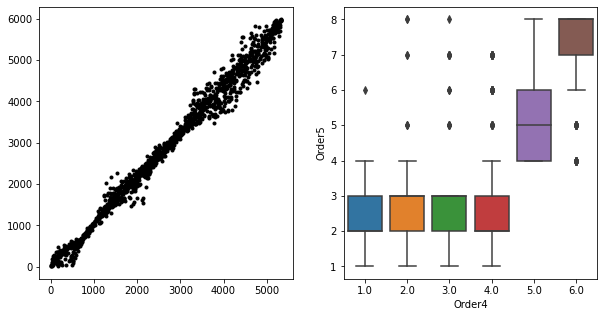

In [5]:
plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
plt.plot(adata.obs['CytoTRACE4'],adata.obs['CytoTRACE5'],'k.')
plt.subplot(1,2,2)
sns.boxplot(data=adata.obs[['Order4','Order5']],x='Order4',y='Order5')
plt.show()

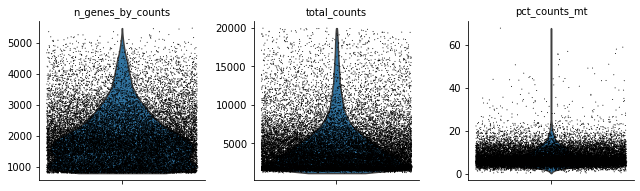

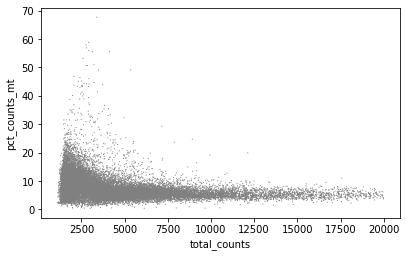

In [36]:
# quality control
adata = adata_orig.copy()
adata.var['mt'] = adata.var_names.str.startswith('mt-')  # annotate the group of mitochondrial genes as 'mt'
sv.pp.remove_duplicate_cells(adata)
sc.pp.calculate_qc_metrics(adata, qc_vars=['mt'], percent_top=None, log1p=False, inplace=True)
sc.pl.violin(adata, ['n_genes_by_counts', 'total_counts', 'pct_counts_mt'],
             jitter=0.4, multi_panel=True)
sc.pl.scatter(adata, x='total_counts', y='pct_counts_mt')

inds1 = np.where((adata.obs['total_counts']>1500))
inds2 = np.where(adata.obs['pct_counts_mt']<20)
print(len(inds1[0]),'samples pass the count filter')
print(len(inds2[0]),' samples pass the mt filter')
ind_samples = np.intersect1d(inds1[0],inds2[0])
print('Samples selected',len(ind_samples))
adata = adata[ind_samples,:]

display(adata)
sc.pp.filter_genes(adata,min_cells=10)
display(adata)
adata.write('/mnt/c/Datas/ExpressionIDim/GSE104323/GSE104323_qc.h5ad',compression='gzip')

In [232]:
# FILTERING OUT SOME CELL TYPES

# Citation from Gulati et al, Science, 2020, Supplementary Materials
#Cells of non-glial or non-neuronal origin, including
#vascular and leptomeningeal cells (VLMC), perivascular macrophages (PVM), and
#endothelial cells (ECs) were excluded. Cell types involved in glial and neuronal
#differentiation as described in ‘Figure 5c’ of the original paper (59) were assigned ranks
#based on known differentiation status. “RGL-like” cells were not assigned a rank as they
#clustered separately from the least differentiated “RGL” cells. Neuronal lineages (e.g.,
#pyramidal and granule neurons) included “nIPC” and “Neuroblast” phenotypes, while glial
#lineages (e.g. oligodendrocyte and astrocyte) did not (63).

print('# VLMC = ',len(adata.obs[adata.obs['cluster']=='VLMC']))
print('# PVM = ',len(adata.obs[adata.obs['cluster']=='PVM']))
print('# Endothelial = ',len(adata.obs[adata.obs['cluster']=='Endothelial']))
clusters = np.array(adata.obs['cluster'])
ind_samples_filtered = np.argwhere(np.all([~(clusters=='VLMC'),~(clusters=='PVM'),~(clusters=='Endothelial')],axis=0)).flatten()
adata = adata[ind_samples_filtered,:]

# VLMC =  159
# PVM =  75
# Endothelial =  503


In [4]:
# CytoTRACE analysis - the results will be in adata.obs['CytoTRACE'] and in adata.uns['CytoGenes'], no need to repeat if already made

import time
from scipy.stats import gaussian_kde

%load_ext rpy2.ipython
%R source('/mnt/c/Libraries/CytoTRACE/R/CytoTRACE.R')

adata_cytotrace = adata_orig
display(adata_cytotrace)
input_cyto=pd.DataFrame(adata_cytotrace.X.T)

s=time.time()
%R -i input_cyto
print('Loaded in ',round(time.time()-s,2),'sec')

cytotrace = %R cytotrace <- CytoTRACE(input_cyto)
cytotrace_score = np.array(cytotrace.rx2('CytoTRACE'))
cytotrace_genes = np.array(cytotrace.rx2('cytoGenes'))
adata_orig.obs['CytoTRACE'] = cytotrace_score
adata_orig.uns['CytoGenes'] = cytotrace_genes

AnnData object with n_obs × n_vars = 22147 × 17572
    obs: 'cluster', 'age', 'Order', 'CytoTRACE5', 'Order5', 'Order4', 'CytoTRACE4', 'strain', 'sex', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells'
    uns: 'pca'
    obsm: 'X_pca'
    varm: 'PCs'

Loaded in  742.38 sec


R[write to console]: The number of cells in your dataset exceeds 3,000. CytoTRACE will now be run in fast mode (see documentation). You can multi-thread this run using the 'ncores' flag. To disable fast mode, please indicate 'enableFast = FALSE'.

R[write to console]: CytoTRACE will be run on 22 sub-sample(s) of approximately 1007 cells each using 1 / 1 core(s)

R[write to console]: Pre-processing data and generating similarity matrix...

R[write to console]: Calculating gene counts signature...

R[write to console]: Smoothing values with NNLS regression and diffusion...

R[write to console]: Calculating genes associated with CytoTRACE...

R[write to console]: Done



NameError: name 'inds5' is not defined

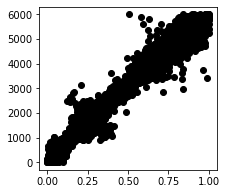

In [6]:
# Check results of CytoTRACE computations - does it match to the one done in the paper
plt.figure(figsize=(7,3))
plt.subplot(121)
plt.scatter(adata_orig.obs['CytoTRACE'],adata_orig.obs['CytoTRACE5'],c='k')
print('Correlation = ',stats.pearsonr(adata_orig.obs['CytoTRACE'][inds5],adata_orig.obs['CytoTRACE5'][inds5])[0])
plt.subplot(122)
plt.scatter(adata_orig.obs['CytoTRACE'],adata_orig.obs['CytoTRACE4'],c='k')
print('Correlation = ',stats.pearsonr(adata_orig.obs['CytoTRACE'][inds4],adata_orig.obs['CytoTRACE4'][inds4])[0])
plt.show()

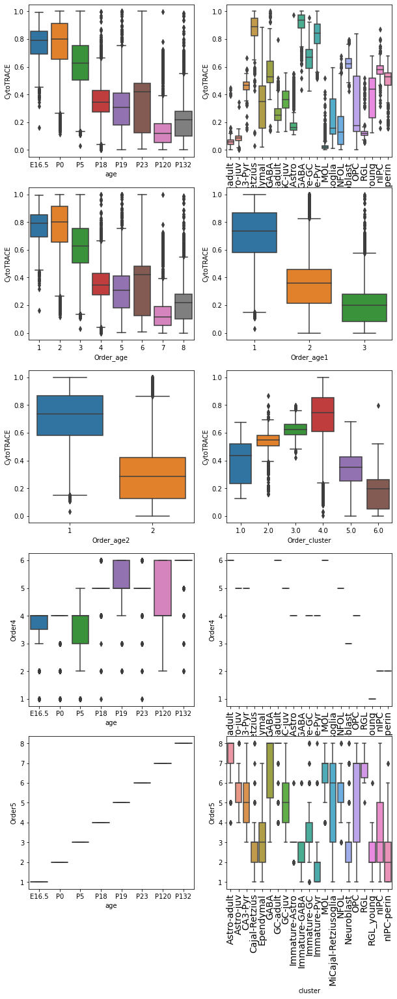

In [13]:
# Check relation between CytoTRACE and age and cluster

plt.figure(figsize=(10,25))
plt.subplot(5,2,1)
sns.boxplot(data=adata.obs,x='age',y='CytoTRACE')
plt.subplot(5,2,2)
sns.boxplot(data=adata.obs,x='cluster',y='CytoTRACE')
plt.xticks(rotation='vertical',fontsize=14)
plt.subplot(5,2,3)
sns.boxplot(data=adata.obs,x='Order_age',y='CytoTRACE')
plt.subplot(5,2,4)
sns.boxplot(data=adata.obs,x='Order_age1',y='CytoTRACE')
plt.subplot(5,2,5)
sns.boxplot(data=adata.obs,x='Order_age2',y='CytoTRACE')
plt.subplot(5,2,6)
sns.boxplot(data=adata.obs,x='Order_cluster',y='CytoTRACE')
plt.subplot(5,2,7)
sns.boxplot(data=adata.obs,x='age',y='Order4')
plt.subplot(5,2,8)
sns.boxplot(data=adata.obs,x='cluster',y='Order4')
plt.xticks(rotation='vertical',fontsize=14)
plt.subplot(5,2,9)
sns.boxplot(data=adata.obs,x='age',y='Order5')
plt.subplot(5,2,10)
sns.boxplot(data=adata.obs,x='cluster',y='Order5')
plt.xticks(rotation='vertical',fontsize=14)
plt.show()

In [7]:
# PREPROCESSING

adata = adata_orig.copy()

# all preprocessing parameters

number_of_pcs = 50

Already_Log_Transformed = False
top_variable_genes = 10000 # if negative then no selection of genes
Normalize_Totals = 10000
Census_normalization = True
n_neighbours_for_pooling = 10

print('PREPROCESSING PARAMETERS:')

print('Already_Log_Transformed=',Already_Log_Transformed)
print('Normalize_Totals=',Normalize_Totals)
print('Census_normalization=',Census_normalization)
print('number_of_pcs=',number_of_pcs)
print('n_neighbours_for_pooling=',n_neighbours_for_pooling)
print('top_variable_genes=',top_variable_genes)

if n_neighbours_for_pooling>0:
    print('Initial preprocessing...')
    adata = preprocessing(adata,Already_Log_Transformed=Already_Log_Transformed,
                         top_variable_genes=top_variable_genes,
                         Normalize_Totals=Normalize_Totals,
                         Census_Normalization=Census_normalization)
    print('Pooling...')
    adata = pooling_procedure(adata,n_neighbours_for_pooling=n_neighbours_for_pooling)

print('Final preprocessing...')
adata = preprocessing(adata,Already_Log_Transformed=Already_Log_Transformed,
                         top_variable_genes=top_variable_genes,
                         Normalize_Totals=Normalize_Totals,
                         Census_Normalization=Census_normalization)

print('Computing PCA on pre-processed data...')
sc.tl.pca(adata,n_comps=number_of_pcs)
X_pca = adata.obsm['X_pca']

inds4 = np.argwhere(~np.isnan(np.array(adata.obs['Order4']))).flatten()
inds5 = np.argwhere(~np.isnan(np.array(adata.obs['Order5']))).flatten()
inds_cluster = np.argwhere(~np.isnan(np.array(adata.obs['Order_cluster']))).flatten()

PREPROCESSING PARAMETERS:
Already_Log_Transformed= False
Normalize_Totals= 10000
Census_normalization= True
number_of_pcs= 50
n_neighbours_for_pooling= 10
top_variable_genes= 10000
Initial preprocessing...
Pooling...
Final preprocessing...
Computing PCA on pre-processed data...


In [8]:
# Here we copy the numerical order values to strings, this can clarify some visualizations
inds4 = np.argwhere(~np.isnan(np.array(adata.obs['Order4']))).flatten()
adata.obs['Order4_s'] = ''*len(adata)
for i in inds4:
    adata.obs['Order4_s'][i] = 'order '+str(adata.obs['Order4'][i])
    
inds5 = np.argwhere(~np.isnan(np.array(adata.obs['Order5']))).flatten()
adata.obs['Order5_s'] = ''*len(adata)
for i in inds5:
    adata.obs['Order5_s'][i] = 'order '+str(adata.obs['Order5'][i])

Order_cluster = {1:'Stage 1',2:'Stage 2',3:'Stage 3',4:'Stage 4',5:'Stage 5',6:'Stage 6'}
adata.obs['Order_cluster_s'] = adata.obs['Order_cluster'].replace(to_replace=Order_cluster)

inds_cluster = np.argwhere(~np.isnan(np.array(adata.obs['Order_cluster']))).flatten()

In [245]:
# FisherS GPW analysis

conditional_number = 10
print(X_pca.shape)
if False:
    for cond_number in range(5,30):
        fishers = skdim.lid.FisherS(conditional_number=cond_number).fit(X_pca)
        glob_pw = fishers.point_inseparability_to_pointID(idx='selected')[0]
        glob_pw = winsorize(glob_pw, limits=(0.01,0.01), inclusive=(True, True), inplace=True)
        order = np.array(adata_reduced.obs['Order'])
        corr = spearman_inversely_weighted_by_classes(order,glob_pw[ind_samples],order)
        print(cond_number,':',corr,'reduced dim',fishers.Xp_.shape[1])
print('\nCONDITIONAL NUMBER:',conditional_number)
fishers = skdim.lid.FisherS(conditional_number=conditional_number).fit(X_pca)
print('Reduced dim=',fishers.Xp_.shape[1])
glob_pw = fishers.point_inseparability_to_pointID(idx='selected')[0]
glob_pw = winsorize(glob_pw, limits=(0.01,0.01), inclusive=(True, True))
glob_pw1 = winsorize(glob_pw, limits=(0.05,0.05), inclusive=(True, True))
adata.obs['FisherS_GPW_vis'] = glob_pw1
adata.obs['FisherS_GPW'] = glob_pw
print('Computing surrogate signature...')
_,surrogate_glob_pw,_,_ = get_surrogate_signature(adata,glob_pw,n_top_genes=200)
surrogate_glob_pw1 = winsorize(surrogate_glob_pw, limits=(0.05,0.05), inclusive=(True, True))
adata.obs['FisherS_GPW_surrogate'] = surrogate_glob_pw
adata.obs['FisherS_GPW_surrogate_vis'] = surrogate_glob_pw1

(22147, 50)

CONDITIONAL NUMBER: 10
Reduced dim= 6
Computing surrogate signature...


In [12]:
adata.obs['PC1'] = X_pca[:,0]
X = adata.X.T
gene_corrs = np.zeros(len(X))
for k in range(len(X)):
    gene_corrs[k] = stats.pearsonr(X[k,:],X_pca[:,0])[0]
    if np.mean(gene_corrs)<0:
        adata.obs['PC1'] = -X_pca[:,0]

adata.obs['PC2'] = X_pca[:,1]
X = adata.X.T
gene_corrs = np.zeros(len(X))
for k in range(len(X)):
    gene_corrs[k] = stats.pearsonr(X[k,:],X_pca[:,1])[0]
    if np.mean(gene_corrs)<0:
        adata.obs['PC2'] = -X_pca[:,1]



Corr CytoTRACE/FisherS_GPW -0.0045126874546210505
Corr CytoTRACE/FisherS_GPW_surrogate -0.42609790833359035


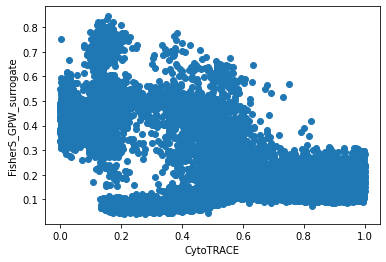

Corr n_genes_by_counts/FisherS_GPW 0.13134570165730428
Corr n_genes_by_counts/FisherS_GPW_surrogate -0.19528223759855326


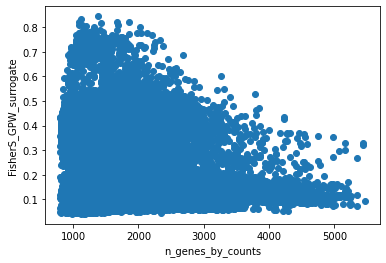

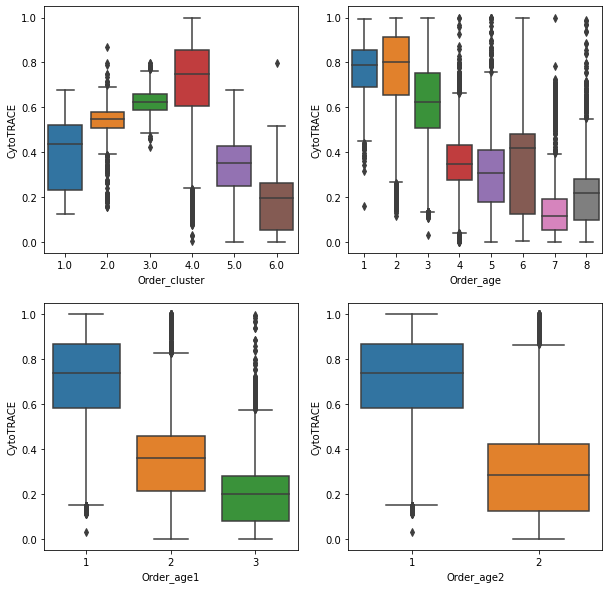

Corr CytoTRACE/Order_cluster -0.5328522021561741
Corr CytoTRACE/Order_age -0.7220943191575873
Corr CytoTRACE/Order_age1 -0.7284728218421412
Corr CytoTRACE/Order_age2 -0.7032180948484233


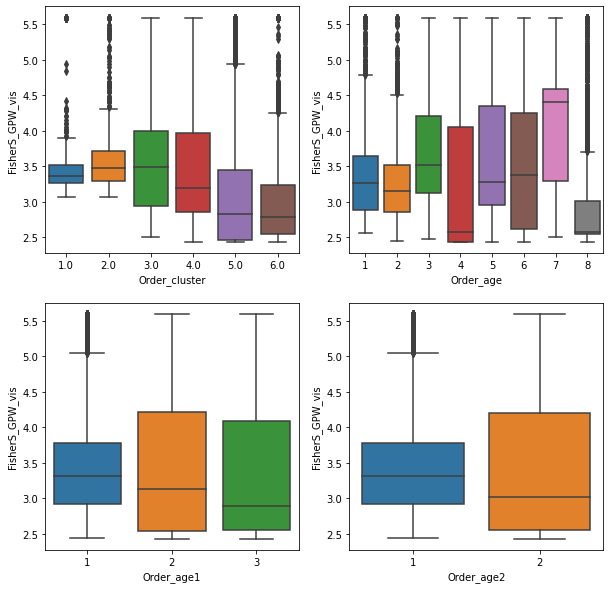

Corr FisherS_GPW/Order_cluster -0.4539737294248769
Corr FisherS_GPW/Order_age -0.027465782895761466
Corr FisherS_GPW/Order_age1 -0.16547356692456755
Corr FisherS_GPW/Order_age2 -0.1586219387214744


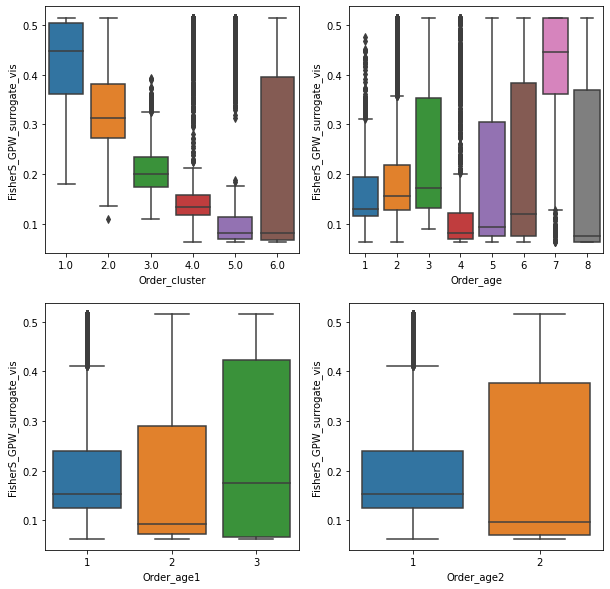

Corr FisherS_GPW_surrogate/Order_cluster -0.6151973287996434
Corr FisherS_GPW_surrogate/Order_age -0.010423384514871594
Corr FisherS_GPW_surrogate/Order_age1 -0.1364362523906933
Corr FisherS_GPW_surrogate/Order_age2 -0.24485138468328754


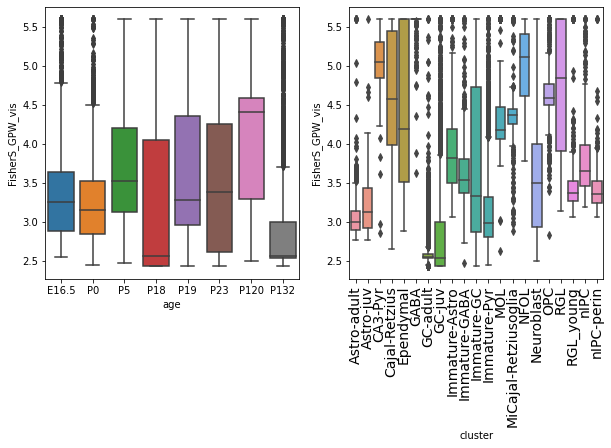

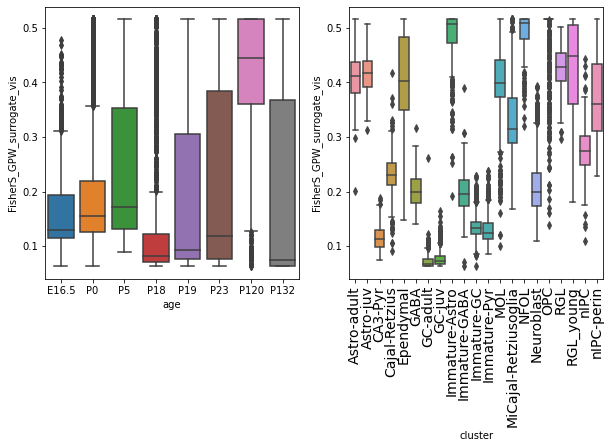

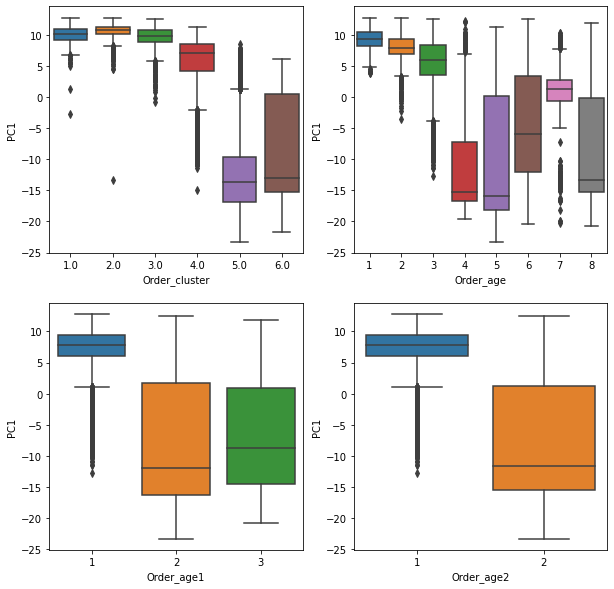

Corr PC1/Order_cluster -0.8816071366968302
Corr PC1/Order_age -0.6885457275484452
Corr PC1/Order_age1 -0.6856608513359477
Corr PC1/Order_age2 -0.7755323207662685


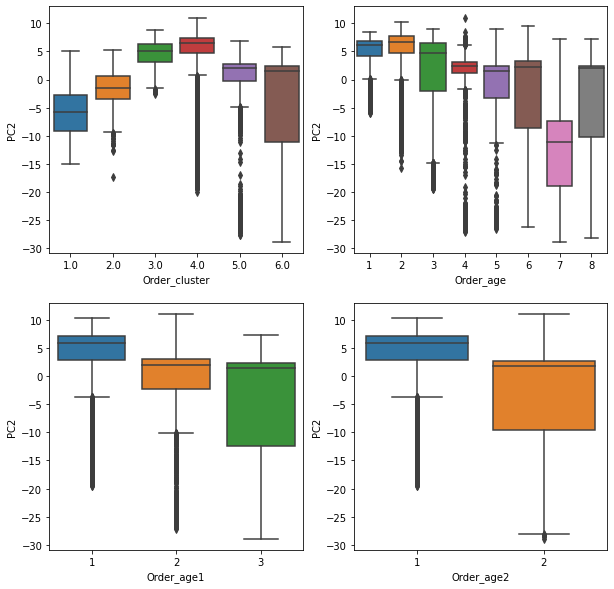

Corr PC2/Order_cluster -0.04201398714255725
Corr PC2/Order_age -0.5721041957945632
Corr PC2/Order_age1 -0.5552368081828839
Corr PC2/Order_age2 -0.5246333384645477


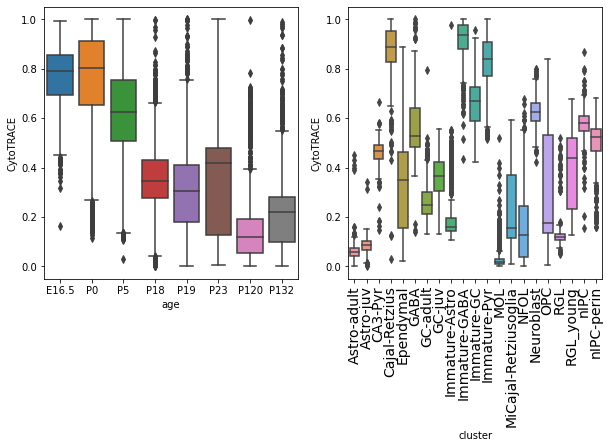

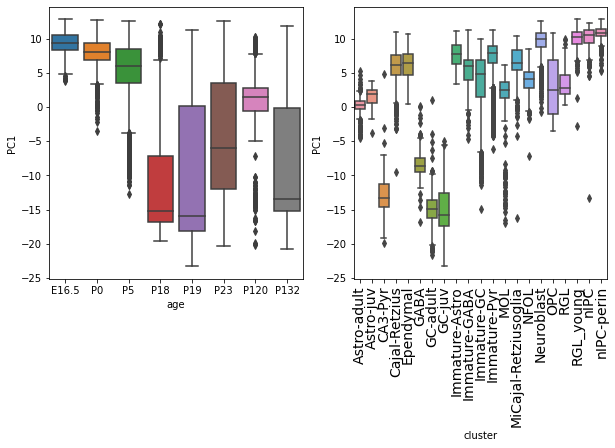

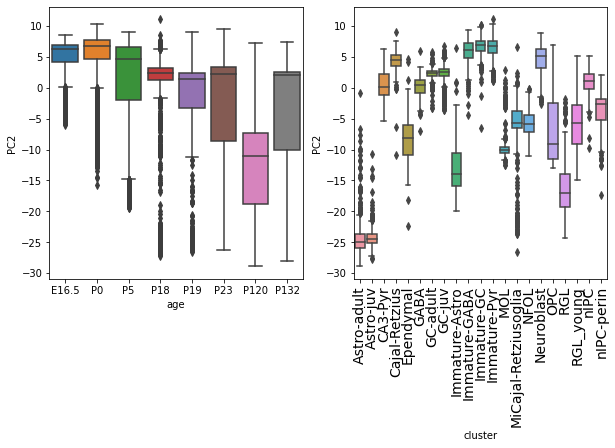

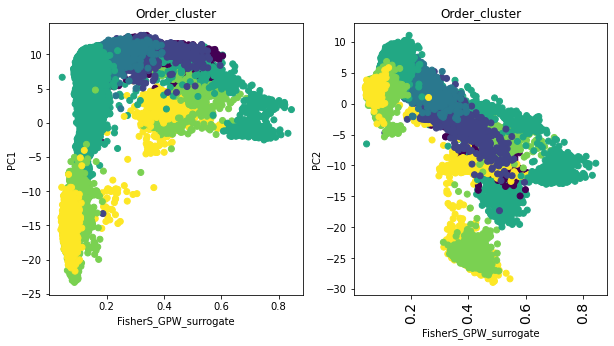

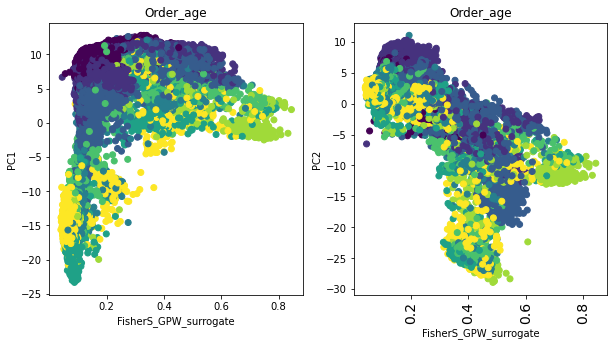

Corr FisherS_GPW_surrogate/PC1 0.4291375738232073
Corr FisherS_GPW_surrogate/PC2 -0.7347661327983017


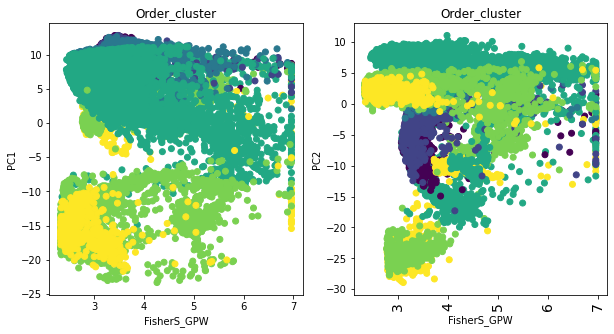

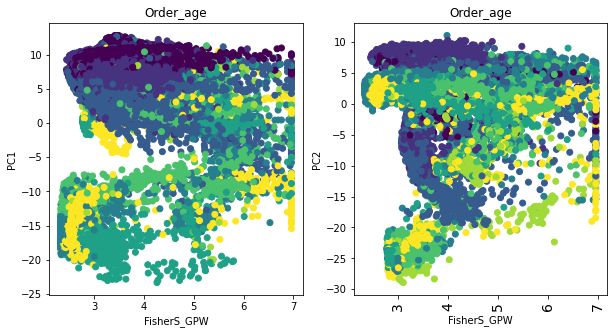

Corr FisherS_GPW/PC1 0.21460390999064577
Corr FisherS_GPW/PC2 -0.11481074502535912


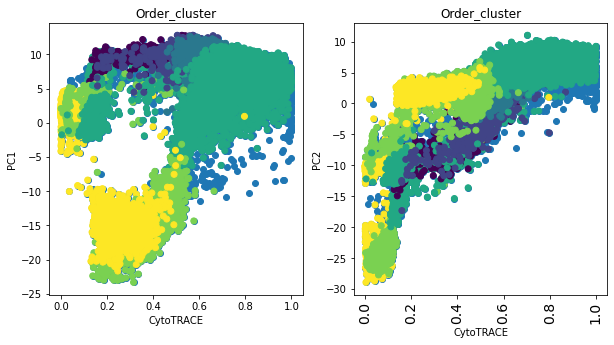

Corr CytoTRACE/PC1 0.47247014441858504
Corr CytoTRACE/PC2 0.7434281630903771


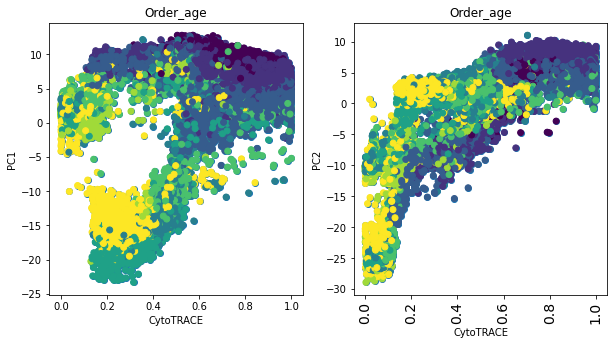

In [25]:
plt.scatter(adata.obs['CytoTRACE'],adata.obs['FisherS_GPW_surrogate'])
plt.xlabel('CytoTRACE')
plt.ylabel('FisherS_GPW_surrogate')
print('Corr CytoTRACE/FisherS_GPW',stats.pearsonr(adata.obs['CytoTRACE'],adata.obs['FisherS_GPW'])[0])
print('Corr CytoTRACE/FisherS_GPW_surrogate',stats.pearsonr(adata.obs['CytoTRACE'],adata.obs['FisherS_GPW_surrogate'])[0])
plt.show()
plt.scatter(adata.obs['n_genes_by_counts'],adata.obs['FisherS_GPW_surrogate'])
plt.xlabel('n_genes_by_counts')
plt.ylabel('FisherS_GPW_surrogate')
print('Corr n_genes_by_counts/FisherS_GPW',stats.pearsonr(adata.obs['n_genes_by_counts'],adata.obs['FisherS_GPW'])[0])
print('Corr n_genes_by_counts/FisherS_GPW_surrogate',stats.pearsonr(adata.obs['n_genes_by_counts'],adata.obs['FisherS_GPW_surrogate'])[0])
plt.show()
plt.figure(figsize=(10,10))
plt.subplot(221)
sns.boxplot(data=adata.obs,x='Order_cluster',y='CytoTRACE')
plt.subplot(222)
sns.boxplot(data=adata.obs,x='Order_age',y='CytoTRACE')
plt.subplot(223)
sns.boxplot(data=adata.obs,x='Order_age1',y='CytoTRACE')
plt.subplot(224)
sns.boxplot(data=adata.obs,x='Order_age2',y='CytoTRACE')
plt.show()

cytotrace_cluster = np.array(adata.obs['CytoTRACE'][inds_cluster])
order_cluster = np.array(adata.obs['Order_cluster'][inds_cluster])
print('Corr CytoTRACE/Order_cluster',spearman_inversely_weighted_by_classes(cytotrace_cluster,order_cluster,order_cluster))
cytotrace = np.array(adata.obs['CytoTRACE'])
order = np.array(adata.obs['Order_age'])
print('Corr CytoTRACE/Order_age',spearman_inversely_weighted_by_classes(cytotrace,order,order))
order = np.array(adata.obs['Order_age1'])
print('Corr CytoTRACE/Order_age1',spearman_inversely_weighted_by_classes(cytotrace,order,order))
order = np.array(adata.obs['Order_age2'])
print('Corr CytoTRACE/Order_age2',spearman_inversely_weighted_by_classes(cytotrace,order,order))

plt.figure(figsize=(10,10))
plt.subplot(221)
sns.boxplot(data=adata.obs,x='Order_cluster',y='FisherS_GPW_vis')
plt.subplot(222)
sns.boxplot(data=adata.obs,x='Order_age',y='FisherS_GPW_vis')
plt.subplot(223)
sns.boxplot(data=adata.obs,x='Order_age1',y='FisherS_GPW_vis')
plt.subplot(224)
sns.boxplot(data=adata.obs,x='Order_age2',y='FisherS_GPW_vis')
plt.show()

FisherS_GPW = np.array(adata.obs['FisherS_GPW'][inds_cluster])
order_cluster = np.array(adata.obs['Order_cluster'][inds_cluster])
print('Corr FisherS_GPW/Order_cluster',spearman_inversely_weighted_by_classes(FisherS_GPW,order_cluster,order_cluster))
FisherS_GPW = np.array(adata.obs['FisherS_GPW'])
order_age = np.array(adata.obs['Order_age'])
print('Corr FisherS_GPW/Order_age',spearman_inversely_weighted_by_classes(FisherS_GPW,order_age,order_age))
order_age = np.array(adata.obs['Order_age1'])
print('Corr FisherS_GPW/Order_age1',spearman_inversely_weighted_by_classes(FisherS_GPW,order_age,order_age))
order_age = np.array(adata.obs['Order_age2'])
print('Corr FisherS_GPW/Order_age2',spearman_inversely_weighted_by_classes(FisherS_GPW,order_age,order_age))


plt.figure(figsize=(10,10))
plt.subplot(221)
sns.boxplot(data=adata.obs,x='Order_cluster',y='FisherS_GPW_surrogate_vis')
plt.subplot(222)
sns.boxplot(data=adata.obs,x='Order_age',y='FisherS_GPW_surrogate_vis')
plt.subplot(223)
sns.boxplot(data=adata.obs,x='Order_age1',y='FisherS_GPW_surrogate_vis')
plt.subplot(224)
sns.boxplot(data=adata.obs,x='Order_age2',y='FisherS_GPW_surrogate_vis')
plt.show()

FisherS_GPW = np.array(adata.obs['FisherS_GPW_surrogate'][inds_cluster])
order_cluster = np.array(adata.obs['Order_cluster'][inds_cluster])
print('Corr FisherS_GPW_surrogate/Order_cluster',spearman_inversely_weighted_by_classes(FisherS_GPW,order_cluster,order_cluster))
FisherS_GPW = np.array(adata.obs['FisherS_GPW_surrogate'])
order_age = np.array(adata.obs['Order_age'])
print('Corr FisherS_GPW_surrogate/Order_age',spearman_inversely_weighted_by_classes(FisherS_GPW,order_age,order_age))
order_age = np.array(adata.obs['Order_age1'])
print('Corr FisherS_GPW_surrogate/Order_age1',spearman_inversely_weighted_by_classes(FisherS_GPW,order_age,order_age))
order_age = np.array(adata.obs['Order_age2'])
print('Corr FisherS_GPW_surrogate/Order_age2',spearman_inversely_weighted_by_classes(FisherS_GPW,order_age,order_age))


plt.figure(figsize=(10,5))
plt.subplot(121)
sns.boxplot(data=adata.obs,x='age',y='FisherS_GPW_vis')
plt.subplot(122)
sns.boxplot(data=adata.obs,x='cluster',y='FisherS_GPW_vis')
plt.xticks(rotation='vertical',fontsize=14)
plt.show()
plt.figure(figsize=(10,5))
plt.subplot(121)
sns.boxplot(data=adata.obs,x='age',y='FisherS_GPW_surrogate_vis')
plt.subplot(122)
sns.boxplot(data=adata.obs,x='cluster',y='FisherS_GPW_surrogate_vis')
plt.xticks(rotation='vertical',fontsize=14)
plt.show()

plt.figure(figsize=(10,10))
plt.subplot(221)
sns.boxplot(data=adata.obs,x='Order_cluster',y='PC1')
plt.subplot(222)
sns.boxplot(data=adata.obs,x='Order_age',y='PC1')
plt.subplot(223)
sns.boxplot(data=adata.obs,x='Order_age1',y='PC1')
plt.subplot(224)
sns.boxplot(data=adata.obs,x='Order_age2',y='PC1')
plt.show()

temp = np.array(adata.obs['PC1'][inds_cluster])
order = np.array(adata.obs['Order_cluster'][inds_cluster])
print('Corr PC1/Order_cluster',spearman_inversely_weighted_by_classes(temp,order,order))
temp = np.array(adata.obs['PC1'])
order = np.array(adata.obs['Order_age'])
print('Corr PC1/Order_age',spearman_inversely_weighted_by_classes(temp,order,order))
order = np.array(adata.obs['Order_age1'])
print('Corr PC1/Order_age1',spearman_inversely_weighted_by_classes(temp,order,order))
order = np.array(adata.obs['Order_age2'])
print('Corr PC1/Order_age2',spearman_inversely_weighted_by_classes(temp,order,order))


plt.figure(figsize=(10,10))
plt.subplot(221)
sns.boxplot(data=adata.obs,x='Order_cluster',y='PC2')
plt.subplot(222)
sns.boxplot(data=adata.obs,x='Order_age',y='PC2')
plt.subplot(223)
sns.boxplot(data=adata.obs,x='Order_age1',y='PC2')
plt.subplot(224)
sns.boxplot(data=adata.obs,x='Order_age2',y='PC2')
plt.show()

temp = np.array(adata.obs['PC2'][inds_cluster])
order = np.array(adata.obs['Order_cluster'][inds_cluster])
print('Corr PC2/Order_cluster',spearman_inversely_weighted_by_classes(temp,order,order))
temp = np.array(adata.obs['PC2'])
order = np.array(adata.obs['Order_age'])
print('Corr PC2/Order_age',spearman_inversely_weighted_by_classes(temp,order,order))
order = np.array(adata.obs['Order_age1'])
print('Corr PC2/Order_age1',spearman_inversely_weighted_by_classes(temp,order,order))
order = np.array(adata.obs['Order_age2'])
print('Corr PC2/Order_age2',spearman_inversely_weighted_by_classes(temp,order,order))


plt.figure(figsize=(10,5))
plt.subplot(121)
sns.boxplot(data=adata.obs,x='age',y='CytoTRACE')
plt.subplot(122)
sns.boxplot(data=adata.obs,x='cluster',y='CytoTRACE')
plt.xticks(rotation='vertical',fontsize=14)
plt.show()


plt.figure(figsize=(10,5))
plt.subplot(121)
sns.boxplot(data=adata.obs,x='age',y='PC1')
plt.subplot(122)
sns.boxplot(data=adata.obs,x='cluster',y='PC1')
plt.xticks(rotation='vertical',fontsize=14)
plt.show()


plt.figure(figsize=(10,5))
plt.subplot(121)
sns.boxplot(data=adata.obs,x='age',y='PC2')
plt.subplot(122)
sns.boxplot(data=adata.obs,x='cluster',y='PC2')
plt.xticks(rotation='vertical',fontsize=14)
plt.show()

plt.figure(figsize=(10,5))
plt.subplot(121)
plt.scatter(adata.obs['FisherS_GPW_surrogate'],adata.obs['PC1'],c=np.array(adata.obs['Order_cluster']))
plt.xlabel('FisherS_GPW_surrogate')
plt.ylabel('PC1')
plt.title('Order_cluster')
plt.subplot(122)
plt.scatter(adata.obs['FisherS_GPW_surrogate'],adata.obs['PC2'],c=np.array(adata.obs['Order_cluster']))
plt.xlabel('FisherS_GPW_surrogate')
plt.ylabel('PC2')
plt.title('Order_cluster')
plt.xticks(rotation='vertical',fontsize=14)
plt.show()

plt.figure(figsize=(10,5))
plt.subplot(121)
plt.scatter(adata.obs['FisherS_GPW_surrogate'],adata.obs['PC1'],c=np.array(adata.obs['Order_age']))
plt.xlabel('FisherS_GPW_surrogate')
plt.ylabel('PC1')
plt.title('Order_age')
plt.subplot(122)
plt.scatter(adata.obs['FisherS_GPW_surrogate'],adata.obs['PC2'],c=np.array(adata.obs['Order_age']))
plt.xlabel('FisherS_GPW_surrogate')
plt.ylabel('PC2')
plt.title('Order_age')
plt.xticks(rotation='vertical',fontsize=14)
plt.show()


print('Corr FisherS_GPW_surrogate/PC1',stats.pearsonr(adata.obs['PC1'],adata.obs['FisherS_GPW_surrogate'])[0])
print('Corr FisherS_GPW_surrogate/PC2',stats.pearsonr(adata.obs['PC2'],adata.obs['FisherS_GPW_surrogate'])[0])


plt.figure(figsize=(10,5))
plt.subplot(121)
plt.scatter(adata.obs['FisherS_GPW'],adata.obs['PC1'],c=np.array(adata.obs['Order_cluster']))
plt.xlabel('FisherS_GPW')
plt.ylabel('PC1')
plt.title('Order_cluster')
plt.subplot(122)
plt.scatter(adata.obs['FisherS_GPW'],adata.obs['PC2'],c=np.array(adata.obs['Order_cluster']))
plt.xlabel('FisherS_GPW')
plt.ylabel('PC2')
plt.title('Order_cluster')
plt.xticks(rotation='vertical',fontsize=14)
plt.show()

plt.figure(figsize=(10,5))
plt.subplot(121)
plt.scatter(adata.obs['FisherS_GPW'],adata.obs['PC1'],c=np.array(adata.obs['Order_age']))
plt.xlabel('FisherS_GPW')
plt.ylabel('PC1')
plt.title('Order_age')
plt.subplot(122)
plt.scatter(adata.obs['FisherS_GPW'],adata.obs['PC2'],c=np.array(adata.obs['Order_age']))
plt.xlabel('FisherS_GPW')
plt.ylabel('PC2')
plt.title('Order_age')
plt.xticks(rotation='vertical',fontsize=14)
plt.show()

print('Corr FisherS_GPW/PC1',stats.pearsonr(adata.obs['PC1'],adata.obs['FisherS_GPW'])[0])
print('Corr FisherS_GPW/PC2',stats.pearsonr(adata.obs['PC2'],adata.obs['FisherS_GPW'])[0])

plt.figure(figsize=(10,5))
plt.subplot(121)
plt.scatter(adata.obs['CytoTRACE'],adata.obs['PC1'])
plt.scatter(adata.obs['CytoTRACE'],adata.obs['PC1'],c=np.array(adata.obs['Order_cluster']))
plt.xlabel('CytoTRACE')
plt.ylabel('PC1')
plt.title('Order_cluster')
plt.subplot(122)
plt.scatter(adata.obs['CytoTRACE'],adata.obs['PC2'])
plt.scatter(adata.obs['CytoTRACE'],adata.obs['PC2'],c=np.array(adata.obs['Order_cluster']))
plt.xticks(rotation='vertical',fontsize=14)
plt.xlabel('CytoTRACE')
plt.ylabel('PC2')
plt.title('Order_cluster')
plt.show()

print('Corr CytoTRACE/PC1',stats.pearsonr(adata.obs['PC1'],adata.obs['CytoTRACE'])[0])
print('Corr CytoTRACE/PC2',stats.pearsonr(adata.obs['PC2'],adata.obs['CytoTRACE'])[0])

plt.figure(figsize=(10,5))
plt.subplot(121)
plt.scatter(adata.obs['CytoTRACE'],adata.obs['PC1'])
plt.scatter(adata.obs['CytoTRACE'],adata.obs['PC1'],c=np.array(adata.obs['Order_age']))
plt.xlabel('CytoTRACE')
plt.ylabel('PC1')
plt.title('Order_age')
plt.subplot(122)
plt.scatter(adata.obs['CytoTRACE'],adata.obs['PC2'])
plt.scatter(adata.obs['CytoTRACE'],adata.obs['PC2'],c=np.array(adata.obs['Order_age']))
plt.xticks(rotation='vertical',fontsize=14)
plt.xlabel('CytoTRACE')
plt.ylabel('PC2')
plt.title('Order_age')
plt.show()


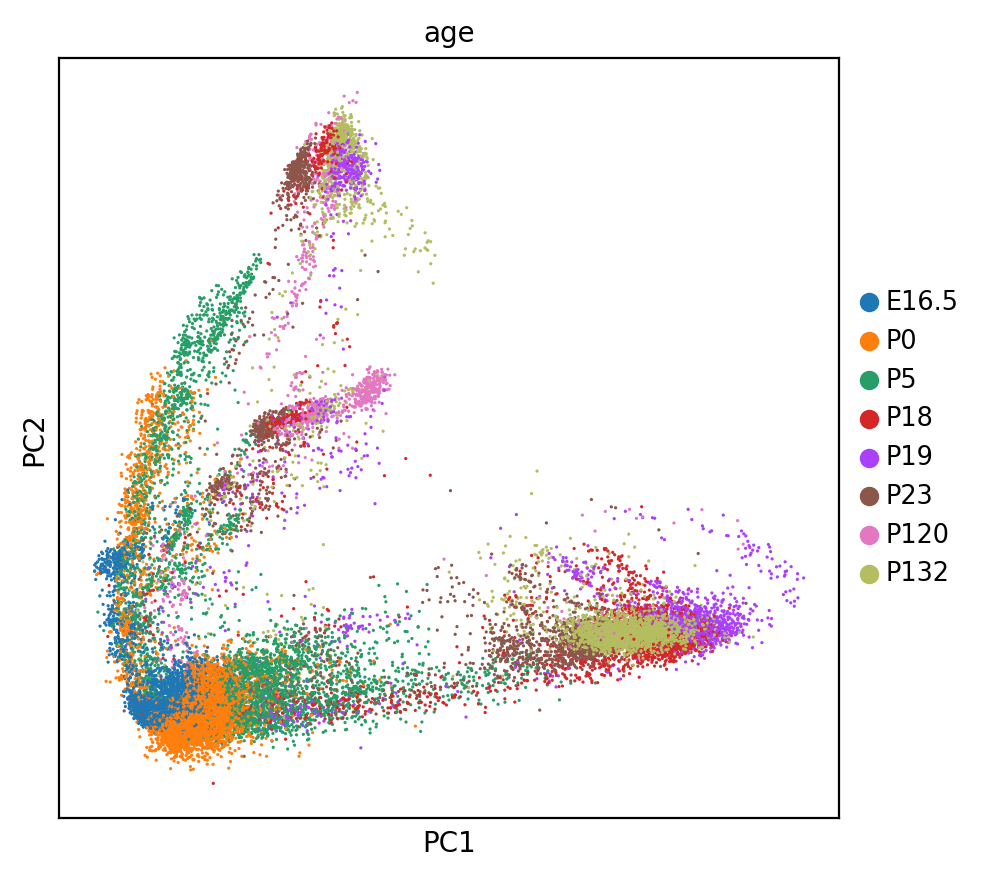

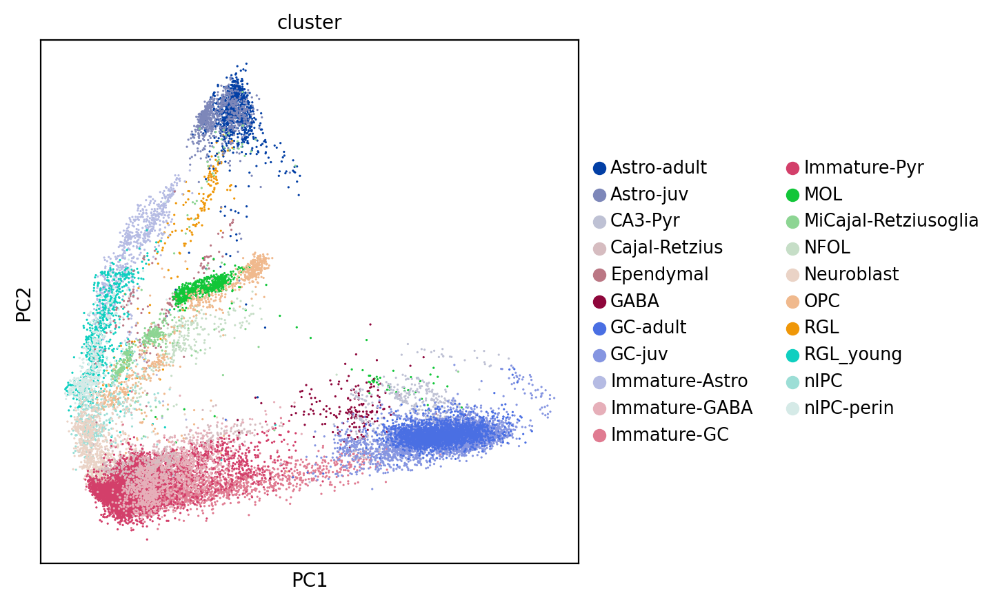

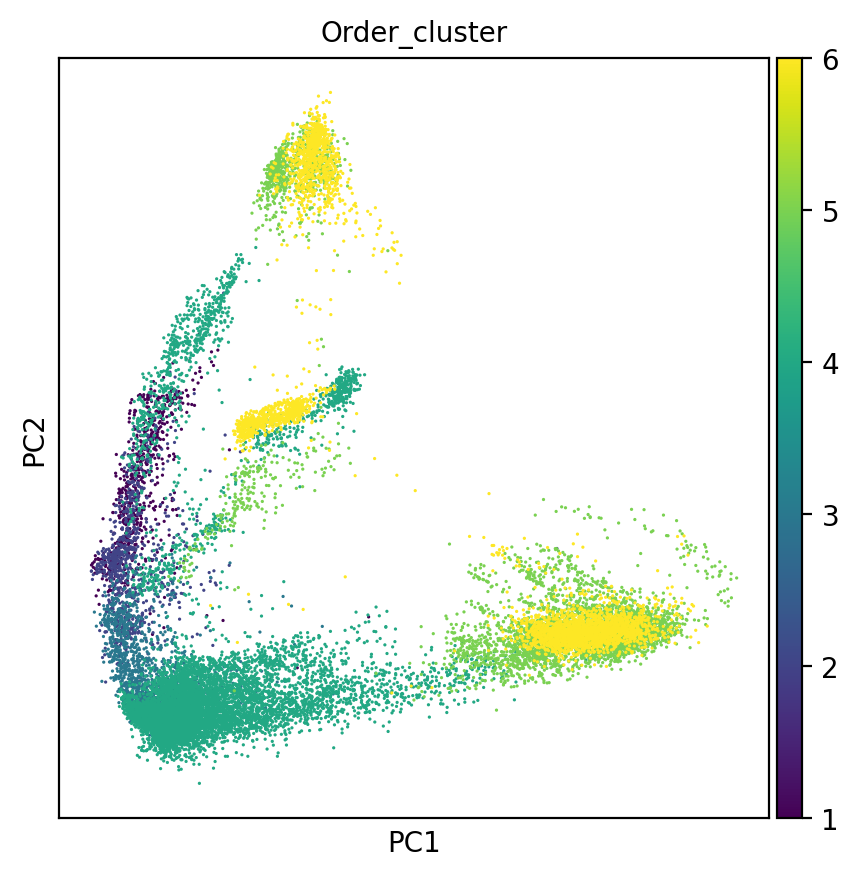

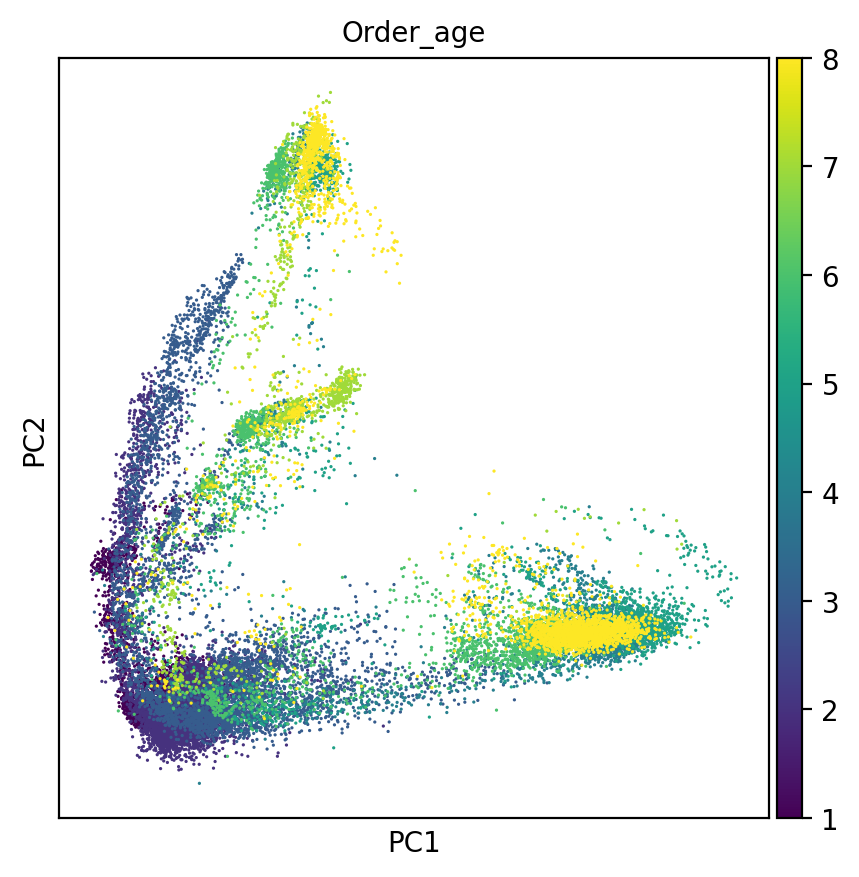

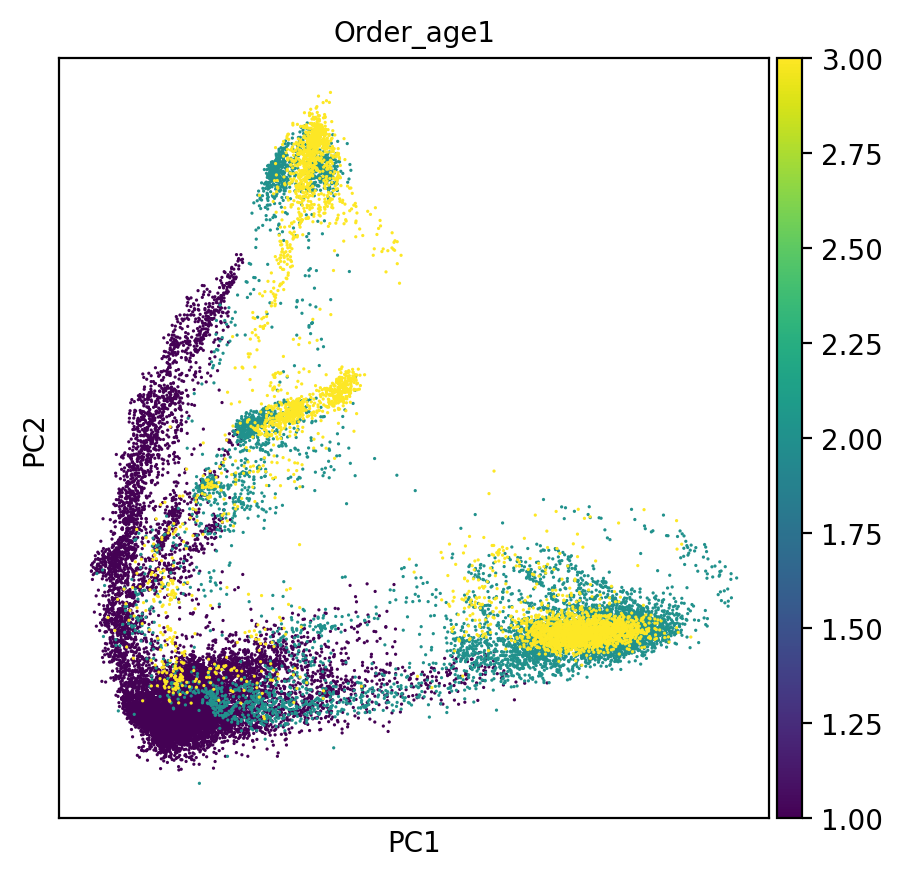

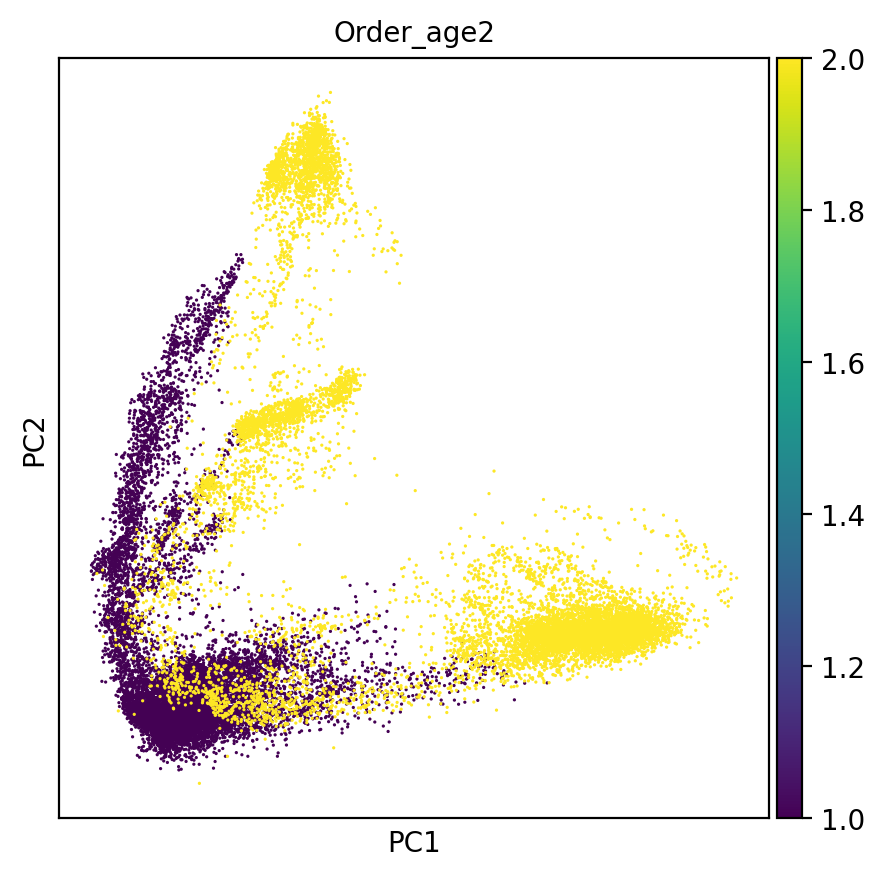

Trying to set attribute `.uns` of view, copying.


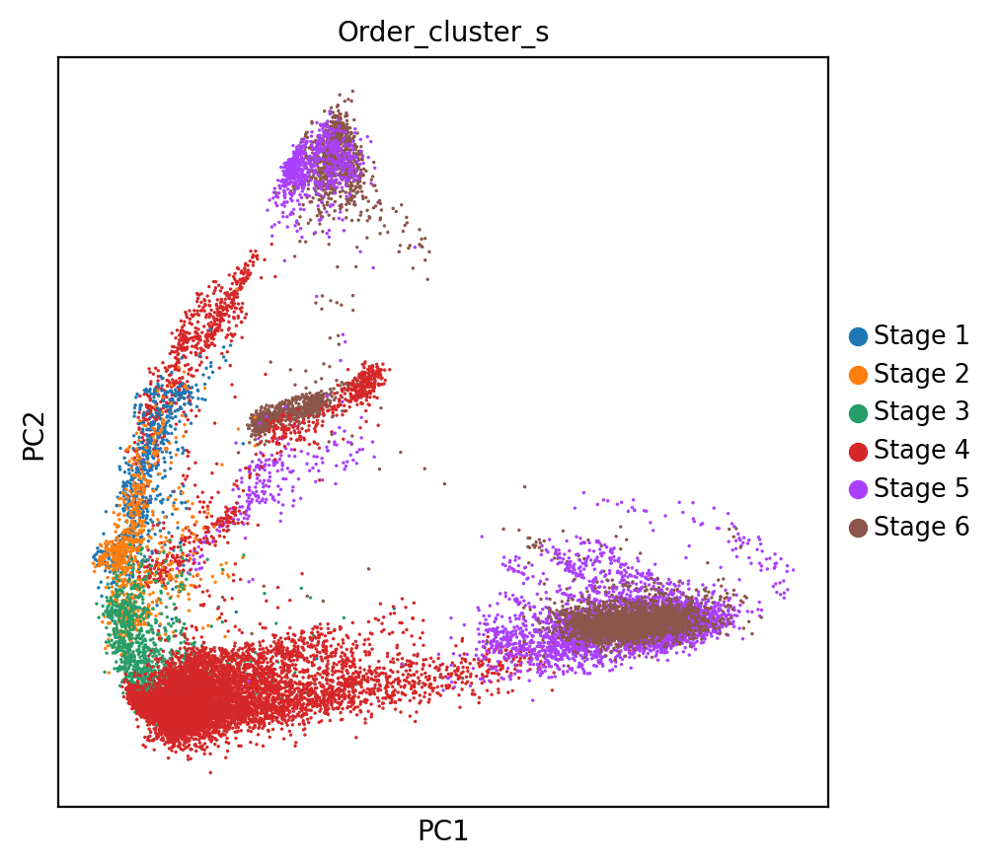

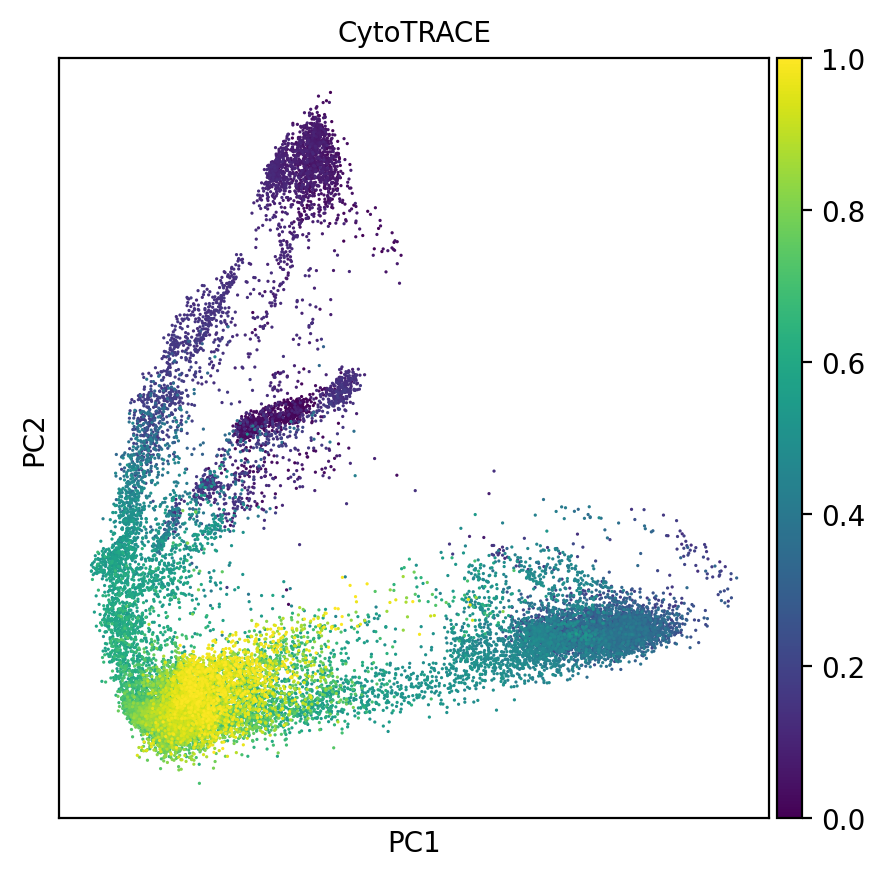

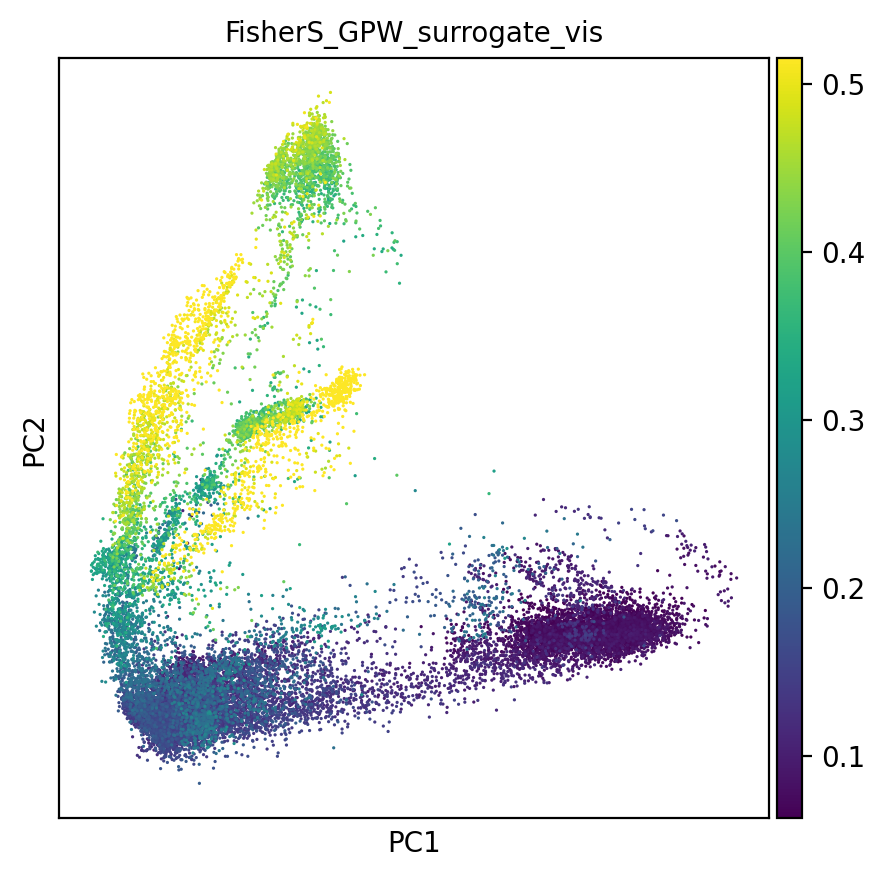

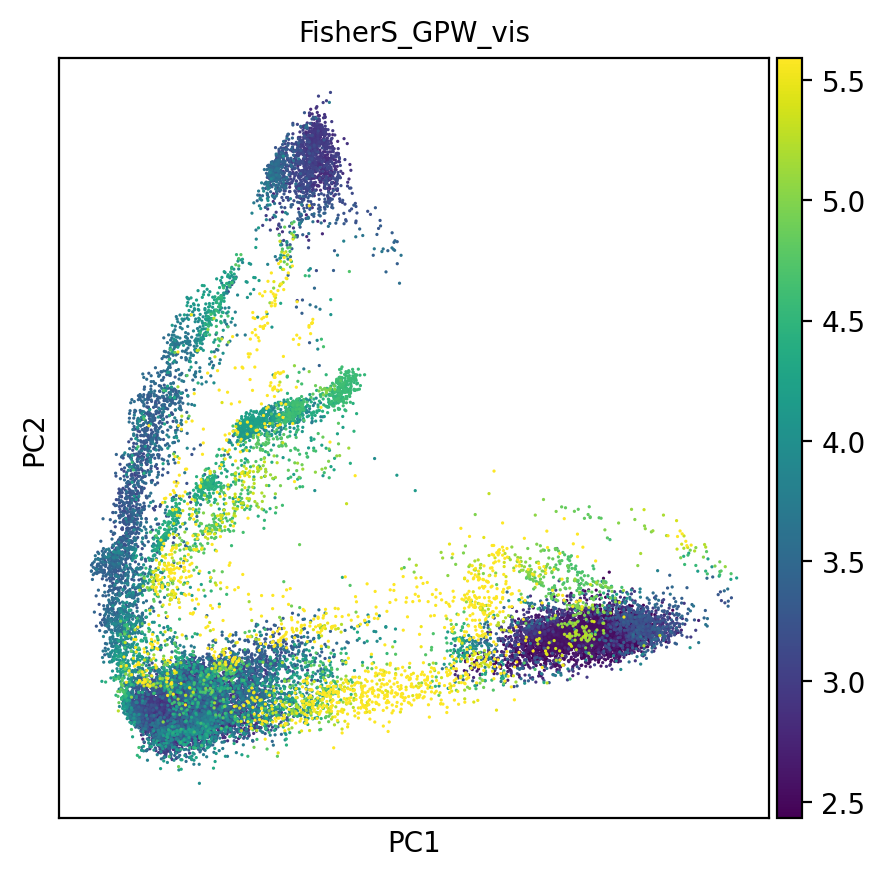

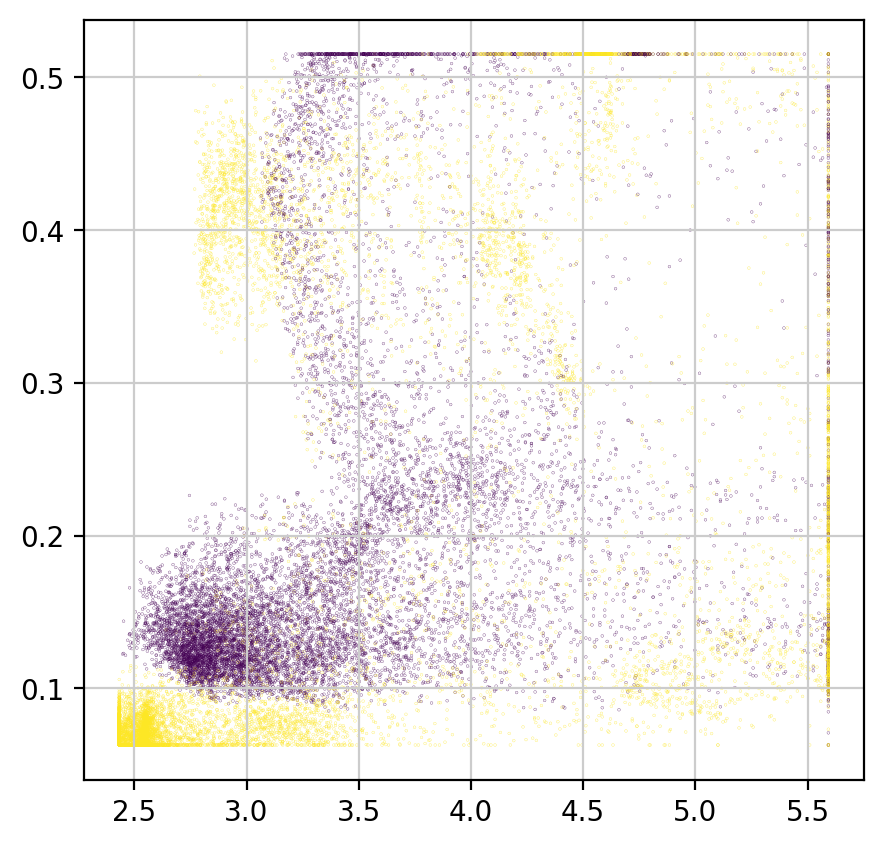

In [28]:
# PCA visualization

sc.set_figure_params(dpi=100, fontsize=10, figsize=(5,5))
sc.pl.pca(adata,color='age')
sc.pl.pca(adata,color='cluster')
sc.pl.pca(adata,color='Order_cluster')
sc.pl.pca(adata,color='Order_age')
sc.pl.pca(adata,color='Order_age1')
sc.pl.pca(adata,color='Order_age2')
sc.pl.pca(adata[inds_cluster,:],color='Order_cluster_s')
sc.pl.pca(adata,color='CytoTRACE')
sc.pl.pca(adata,color='FisherS_GPW_surrogate_vis')
sc.pl.pca(adata,color='FisherS_GPW_vis')
plt.scatter(adata.obs['FisherS_GPW_vis'],adata.obs['FisherS_GPW_surrogate_vis'],c=adata.obs['Order_age2'],s=0.01)
plt.show()


In [23]:
n_df_comps = 10
sc.tl.diffmap(adata,n_comps=n_df_comps)

In [157]:
#n_neighbors_umap = max(10,int(len(adata.X)/100))
n_neighbors_umap = 200
print('n_neighbors_umap=',n_neighbors_umap)
sc.pp.neighbors(adata,n_neighbors=n_neighbors_umap)
sc.tl.umap(adata,n_components=2)

n_neighbors_umap= 200


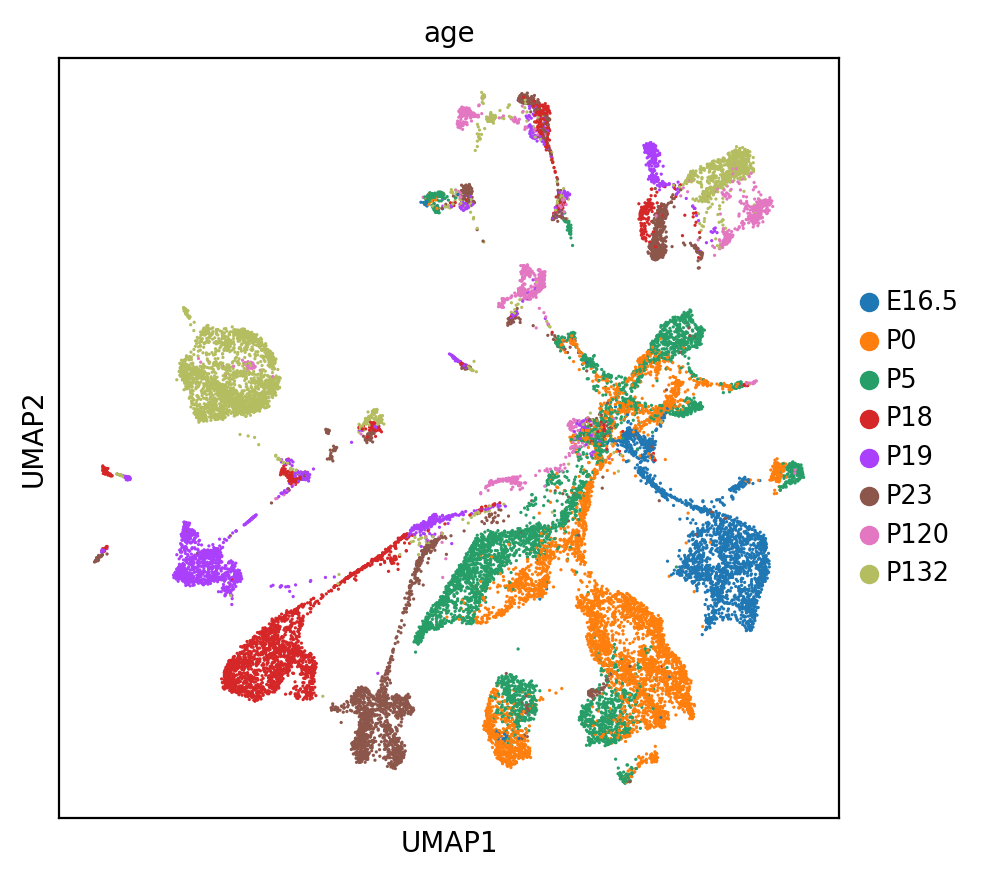

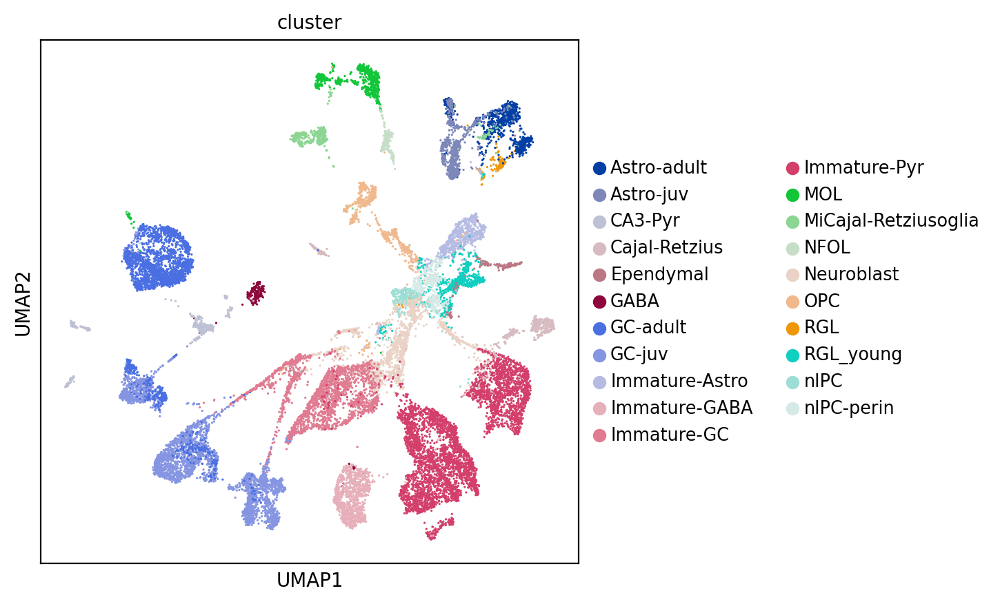

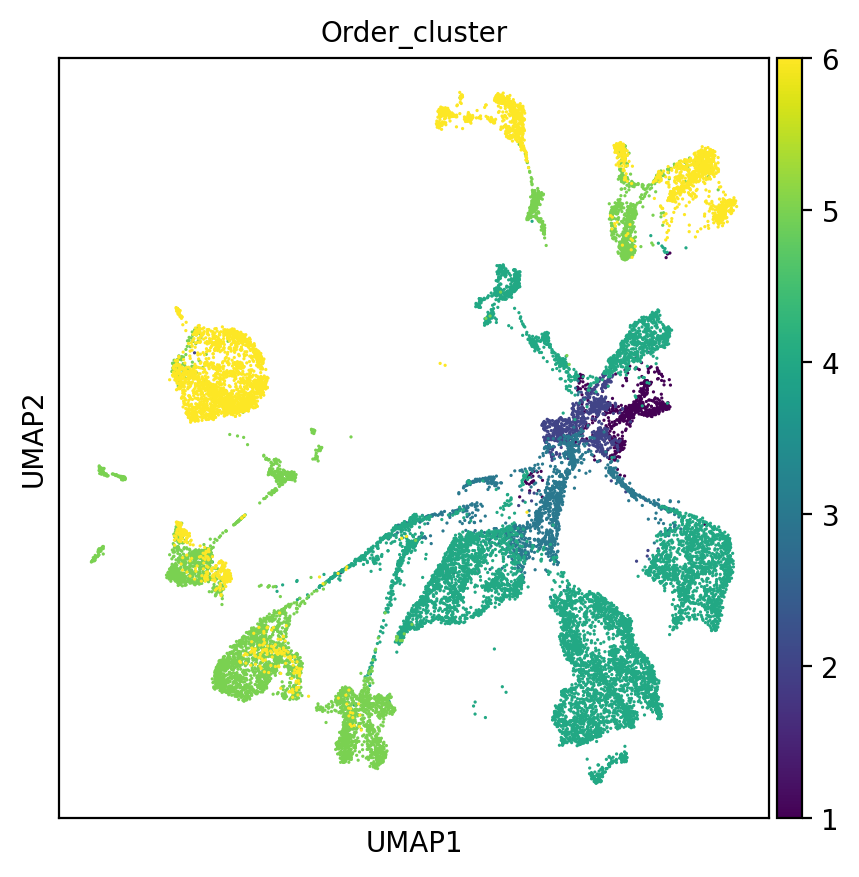

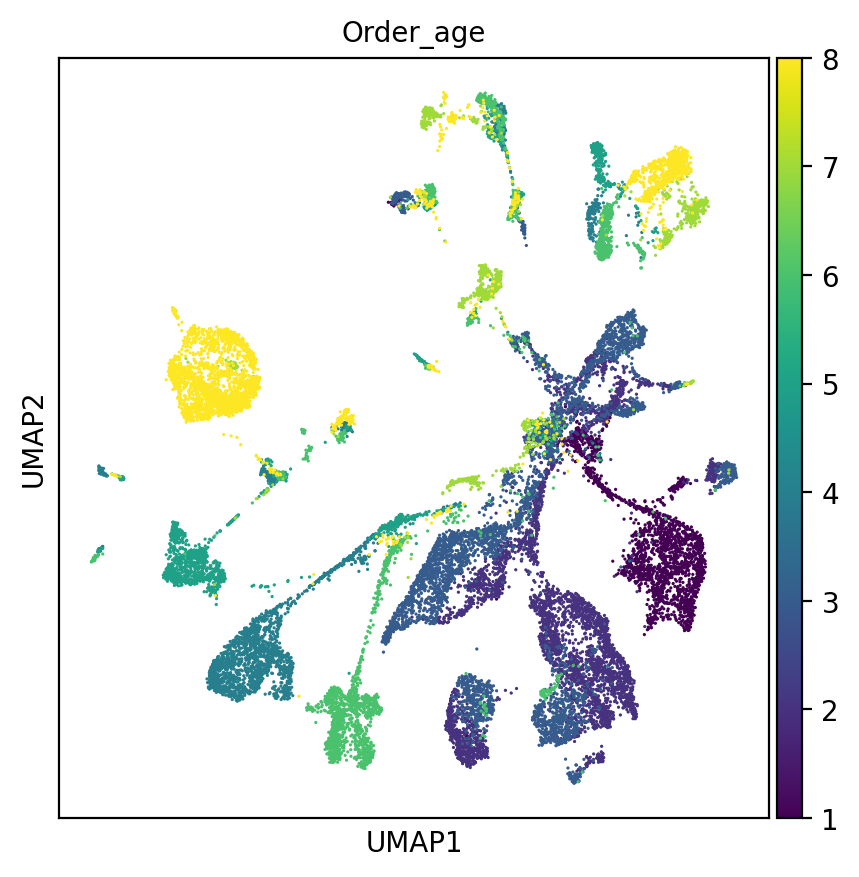

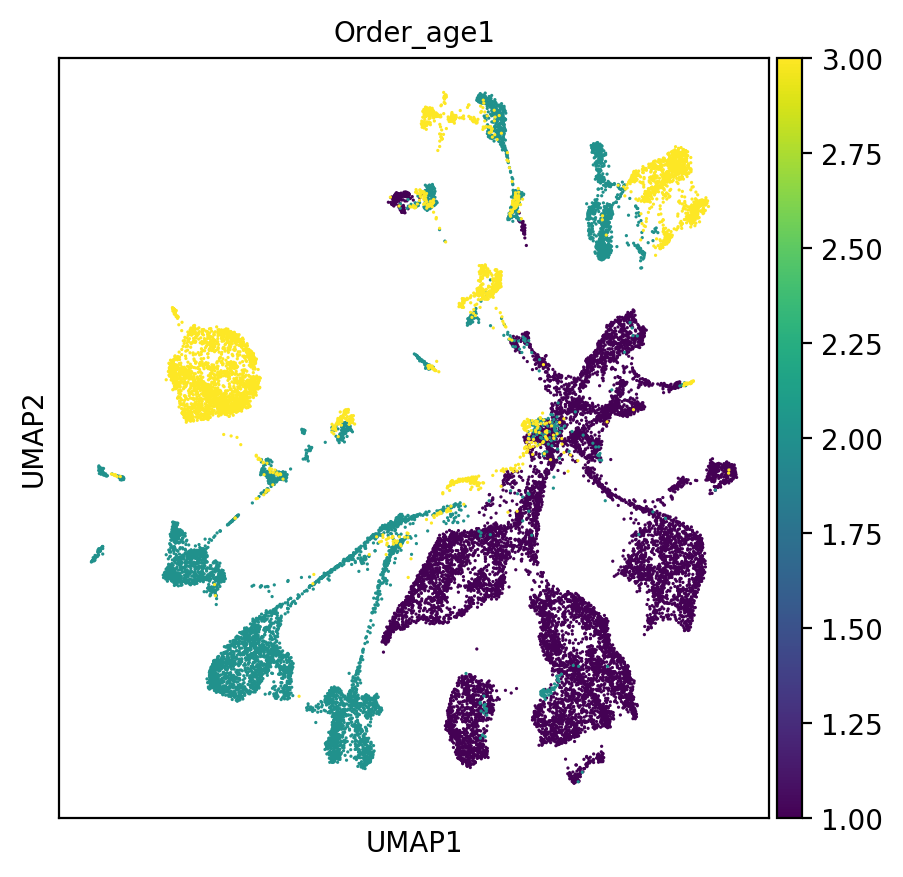

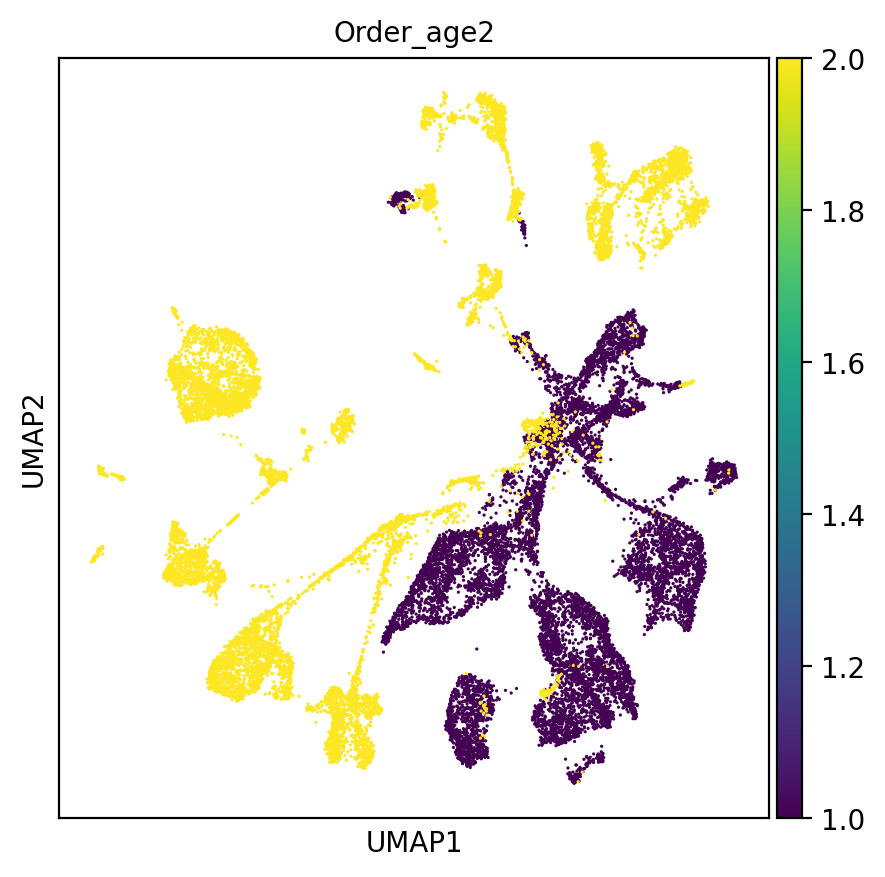

Trying to set attribute `.uns` of view, copying.


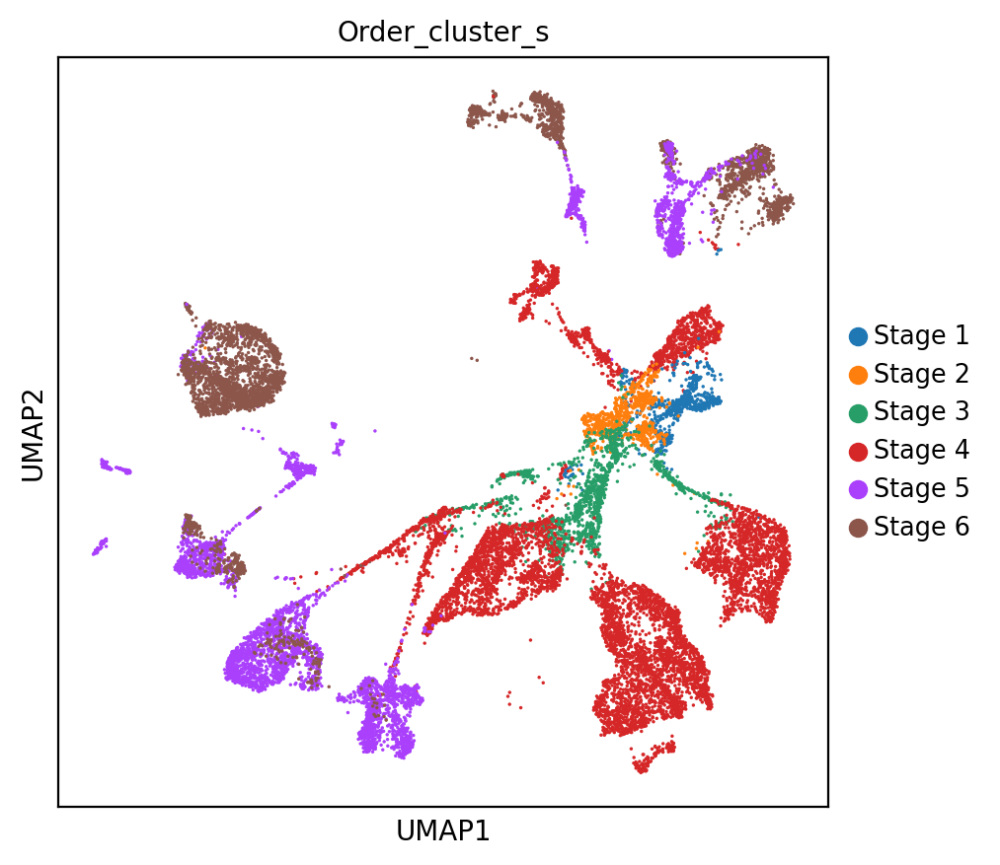

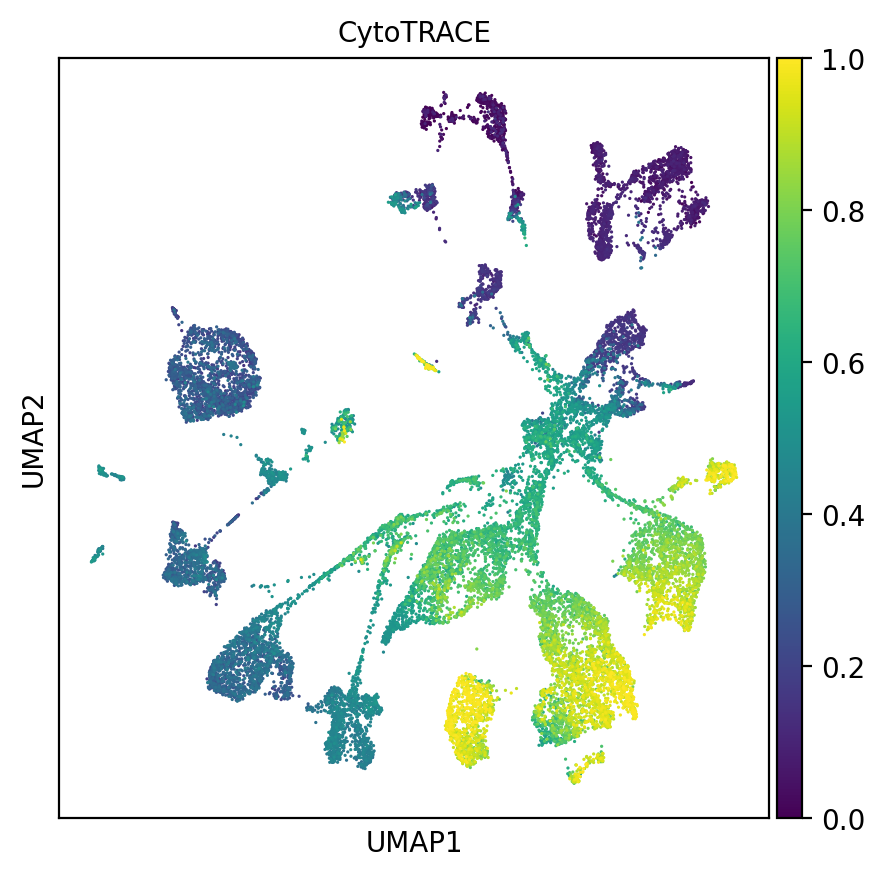

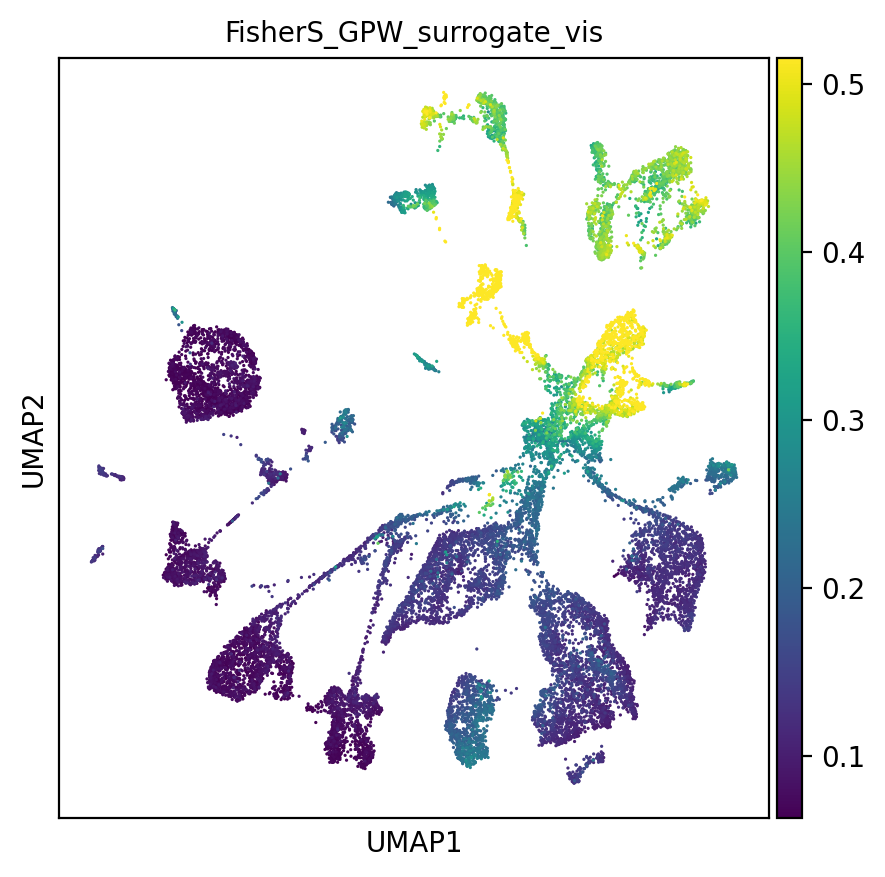

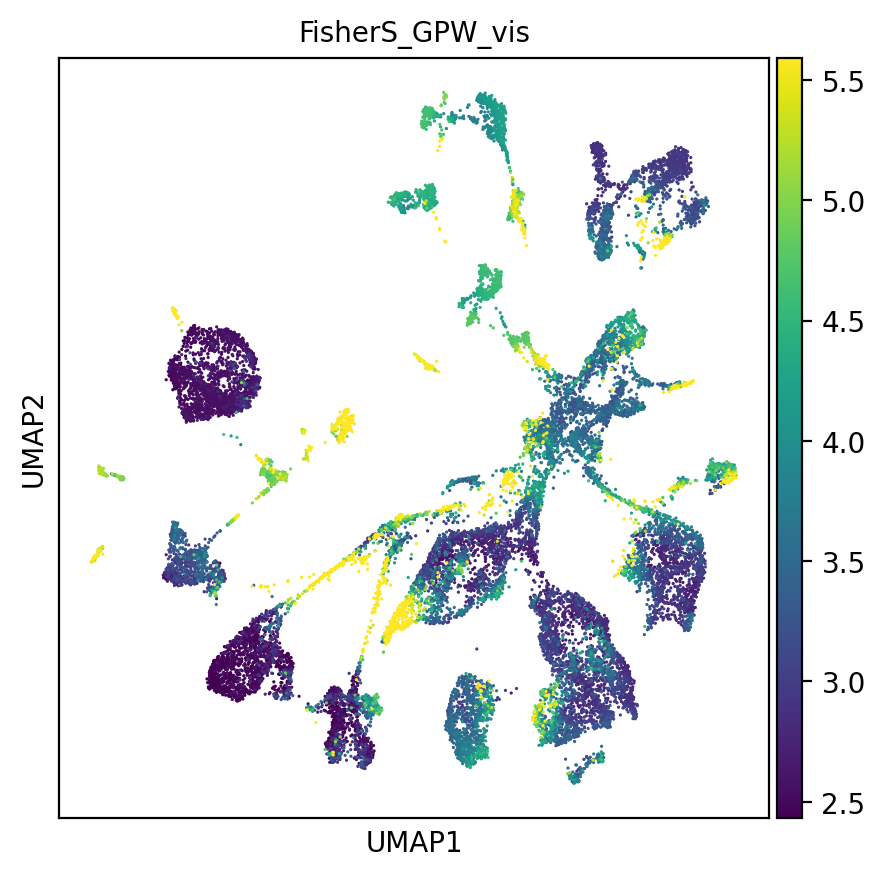

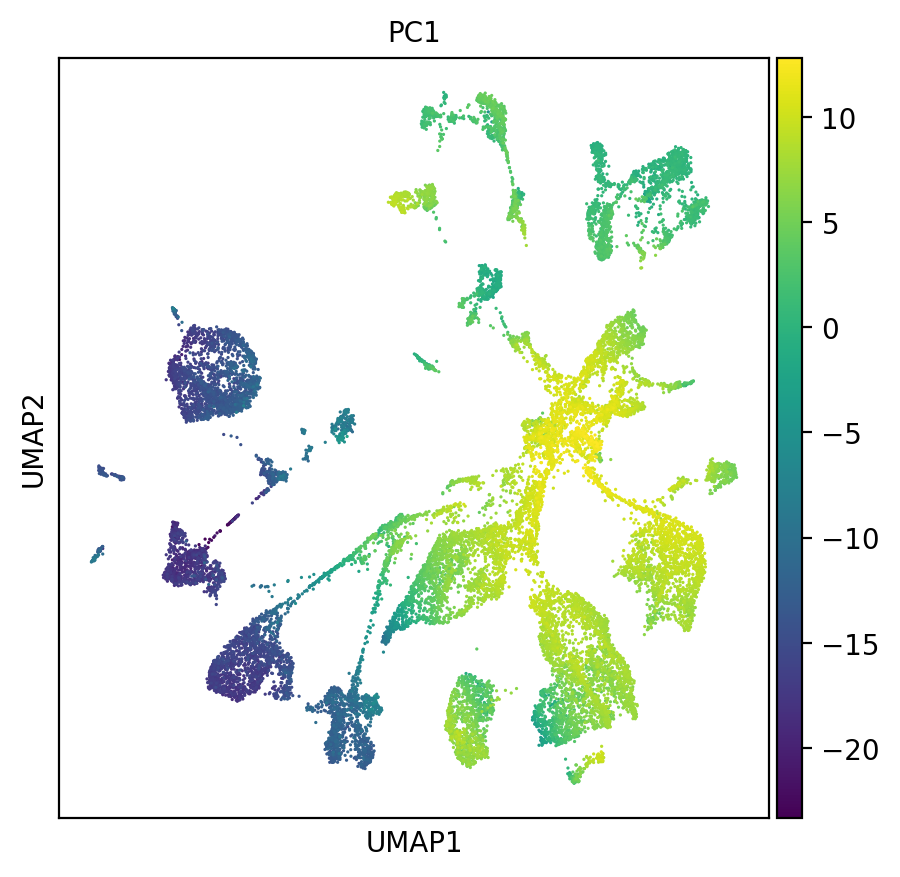

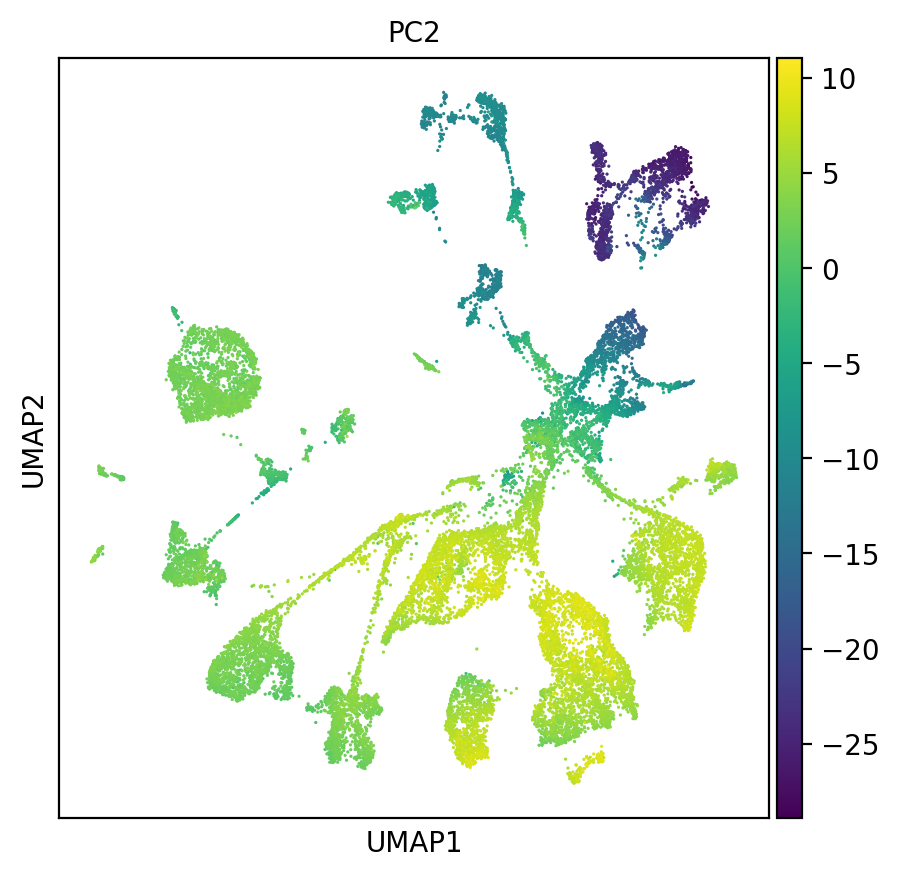

In [158]:
# UMAP visualization

sc.set_figure_params(dpi=100, fontsize=10, figsize=(5,5))
sc.pl.umap(adata,color='age')
sc.pl.umap(adata,color='cluster')
sc.pl.umap(adata,color='Order_cluster')
sc.pl.umap(adata,color='Order_age')
sc.pl.umap(adata,color='Order_age1')
sc.pl.umap(adata,color='Order_age2')
sc.pl.umap(adata[inds_cluster,:],color='Order_cluster_s')
sc.pl.umap(adata,color='CytoTRACE')
sc.pl.umap(adata,color='FisherS_GPW_surrogate_vis')
sc.pl.umap(adata,color='FisherS_GPW_vis')
sc.pl.umap(adata,color='PC1')
sc.pl.umap(adata,color='PC2')


In [18]:
adata.obsm['X_umap']

array([[ 9.419555 , 12.201172 , -1.0488904],
       [11.532655 ,  6.4767275,  3.9926214],
       [11.313402 ,  6.4082813,  3.6120448],
       ...,
       [-2.2811563,  9.001211 ,  4.2569895],
       [ 1.0598297, -3.2174823,  4.7275233],
       [-2.9612768,  7.4909806,  3.4917836]], dtype=float32)

In [23]:
n_neighbors_graph = 500
print('n_neighbors_graph=',n_neighbors_graph)
#sc.pp.neighbors(adata,n_neighbors=n_neighbors_graph,use_rep='X_diffmap')
#sc.pp.neighbors(adata,n_neighbors=n_neighbors_graph,use_rep='X_pca')
sc.pp.neighbors(adata,n_neighbors=n_neighbors_graph,use_rep='X_umap')
#sc.tl.draw_graph(adata,layout='fa')
sc.tl.draw_graph(adata,layout='grid_f')

n_neighbors_graph= 500


KeyboardInterrupt: 

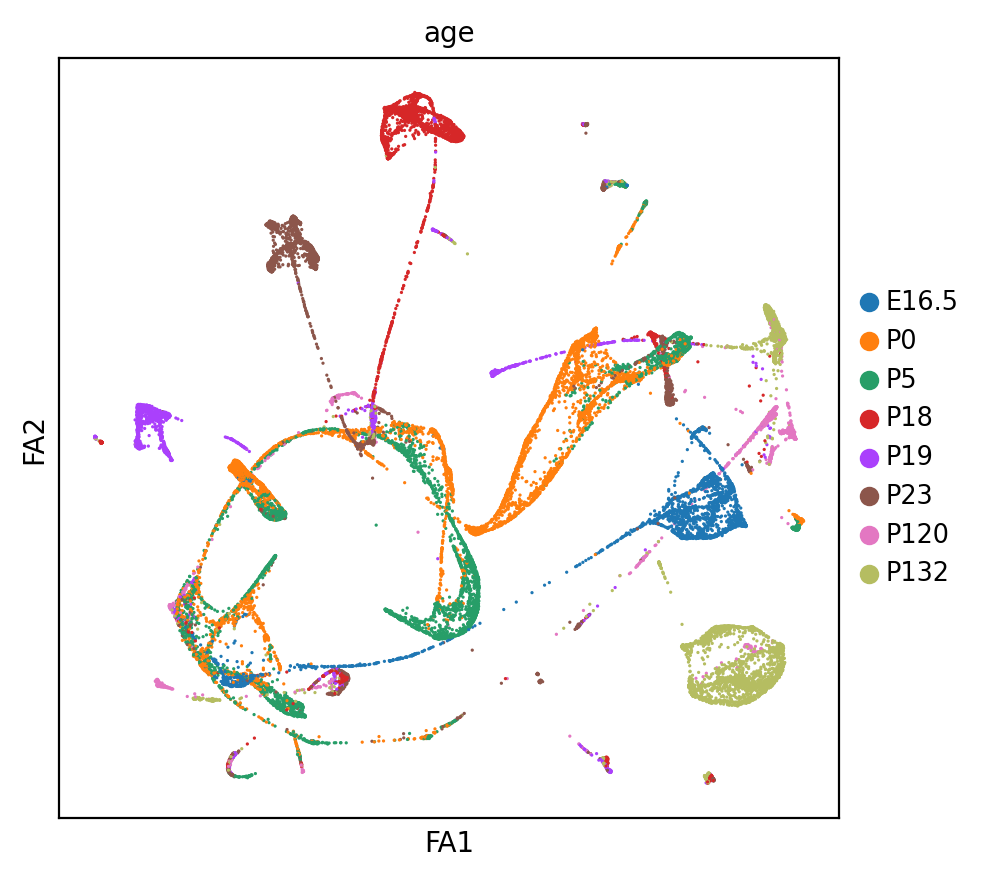

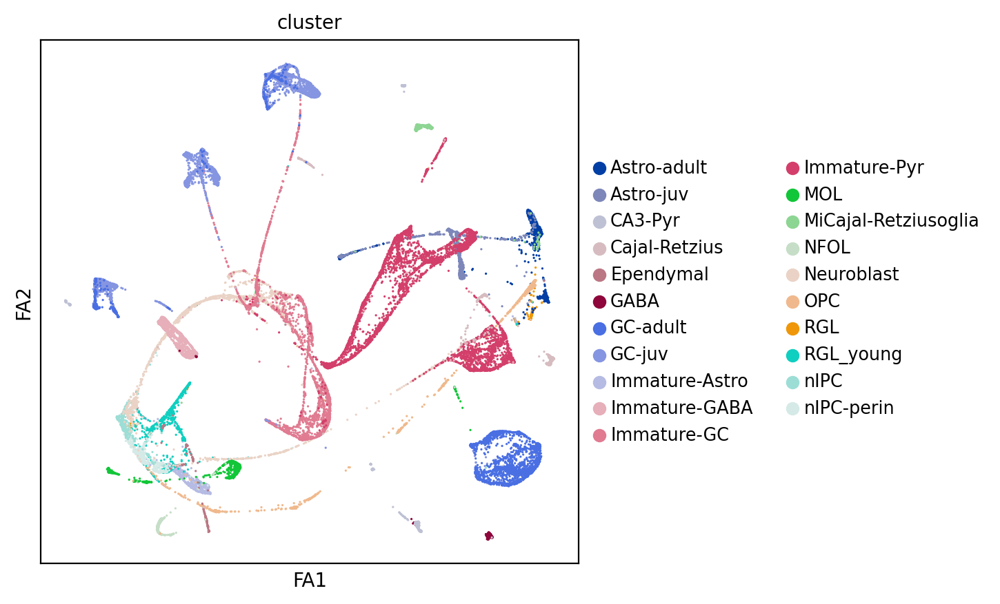

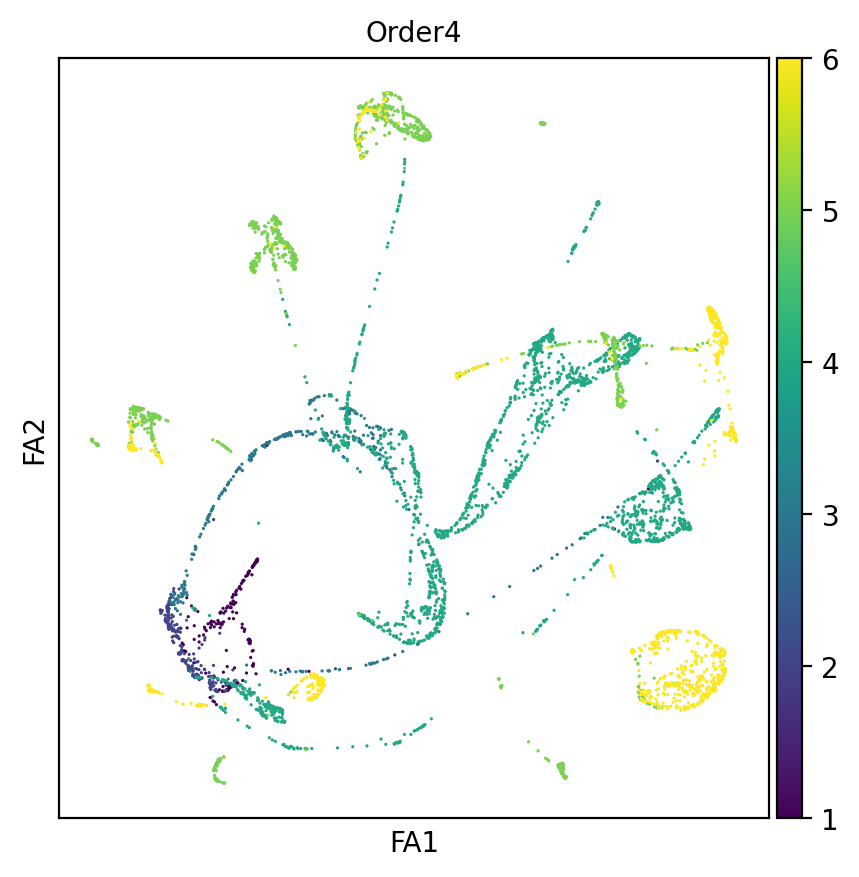

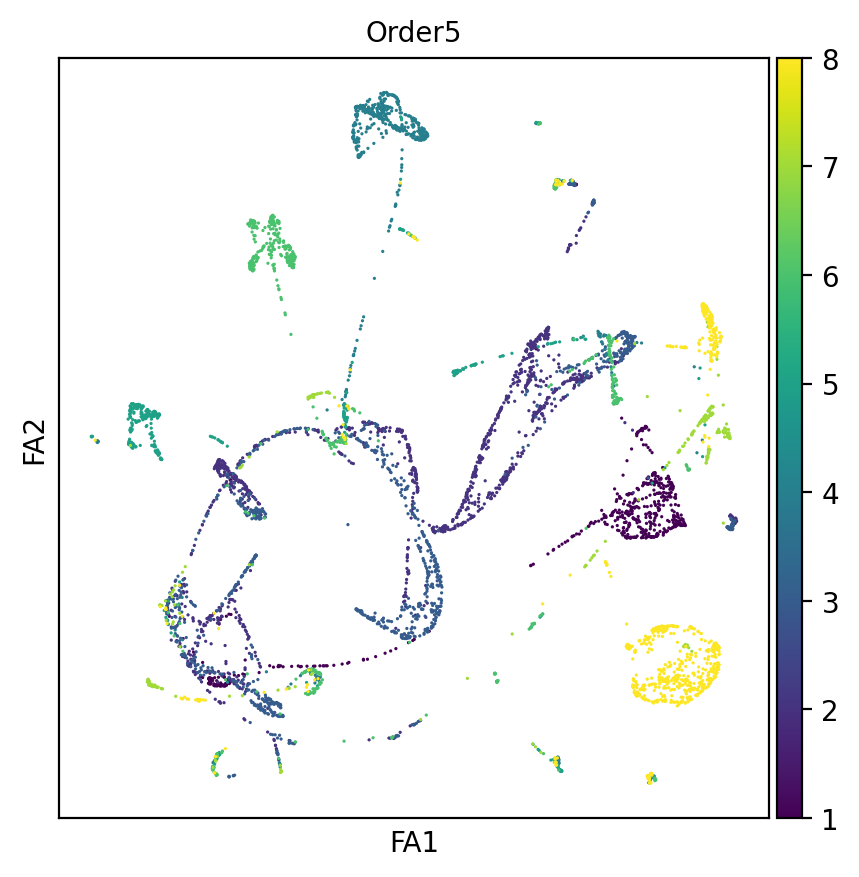

Trying to set attribute `.uns` of view, copying.


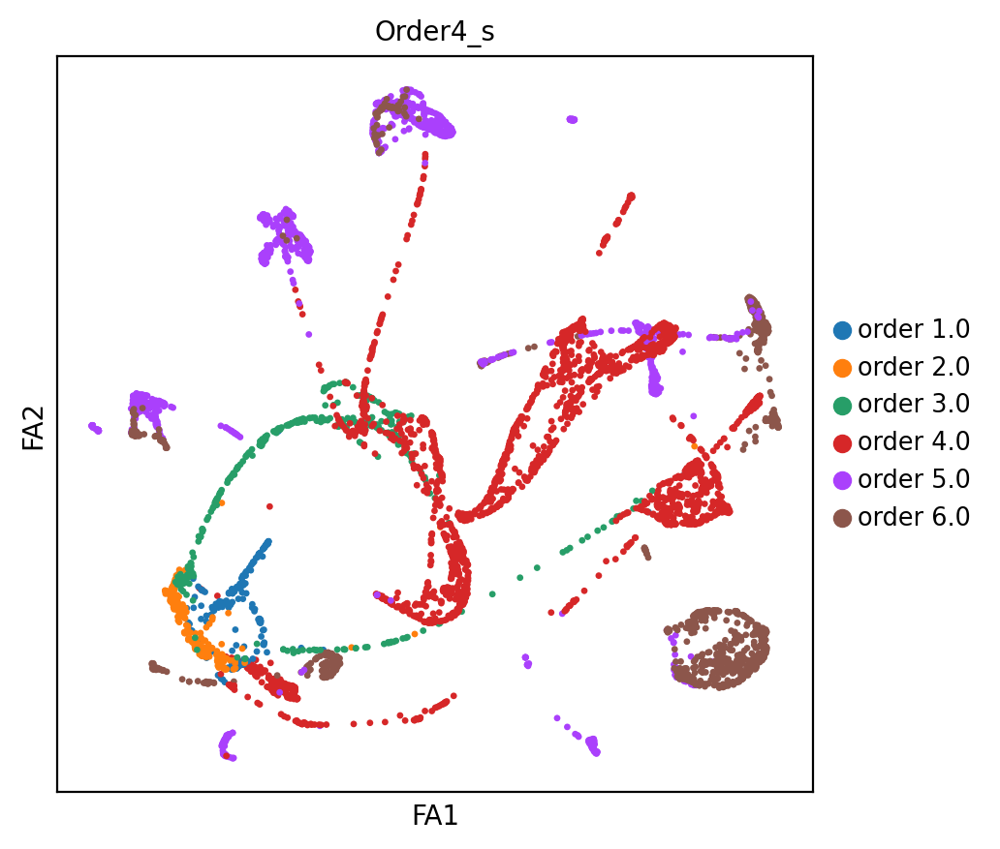

Trying to set attribute `.uns` of view, copying.


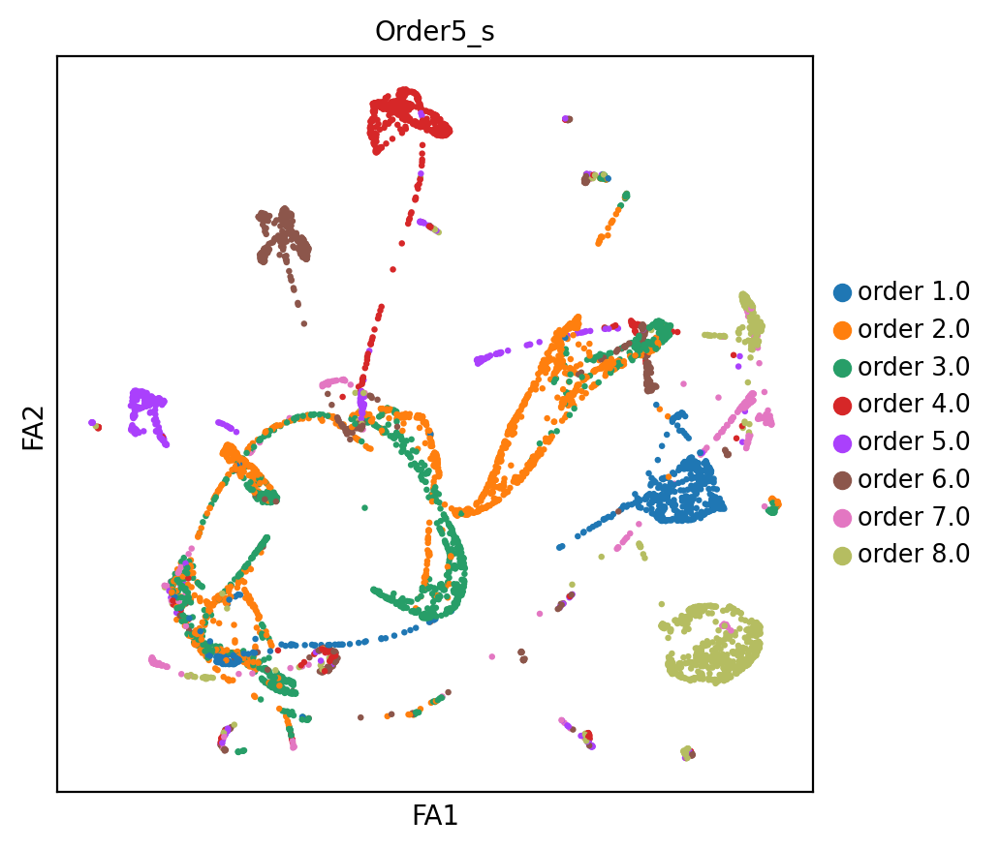

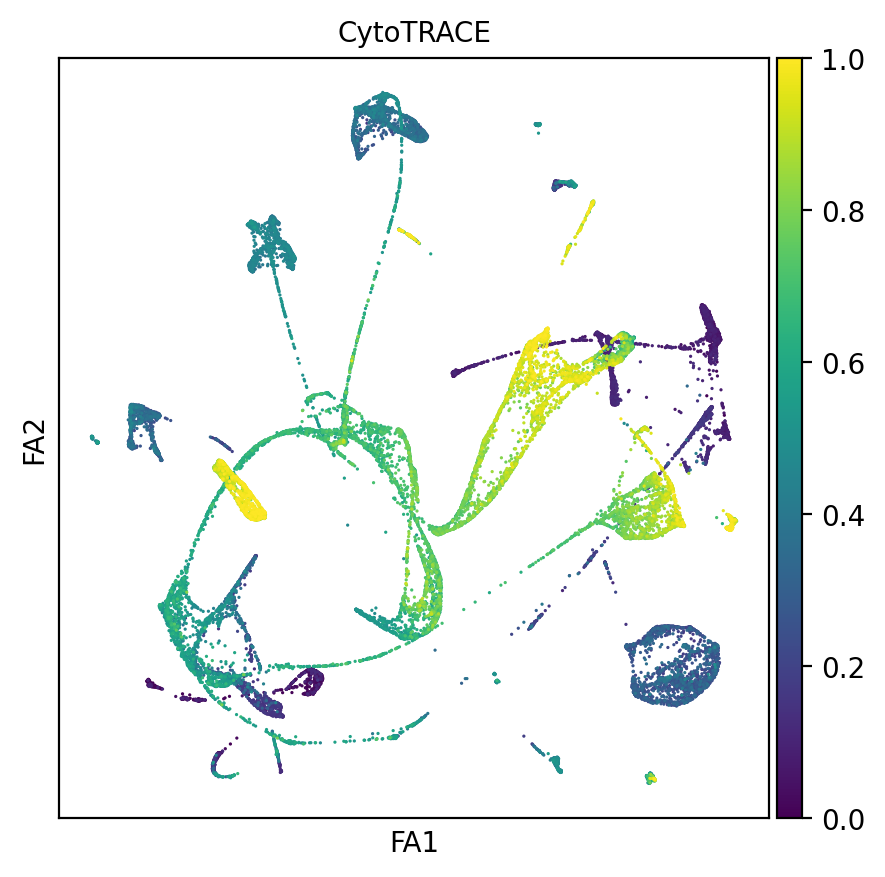

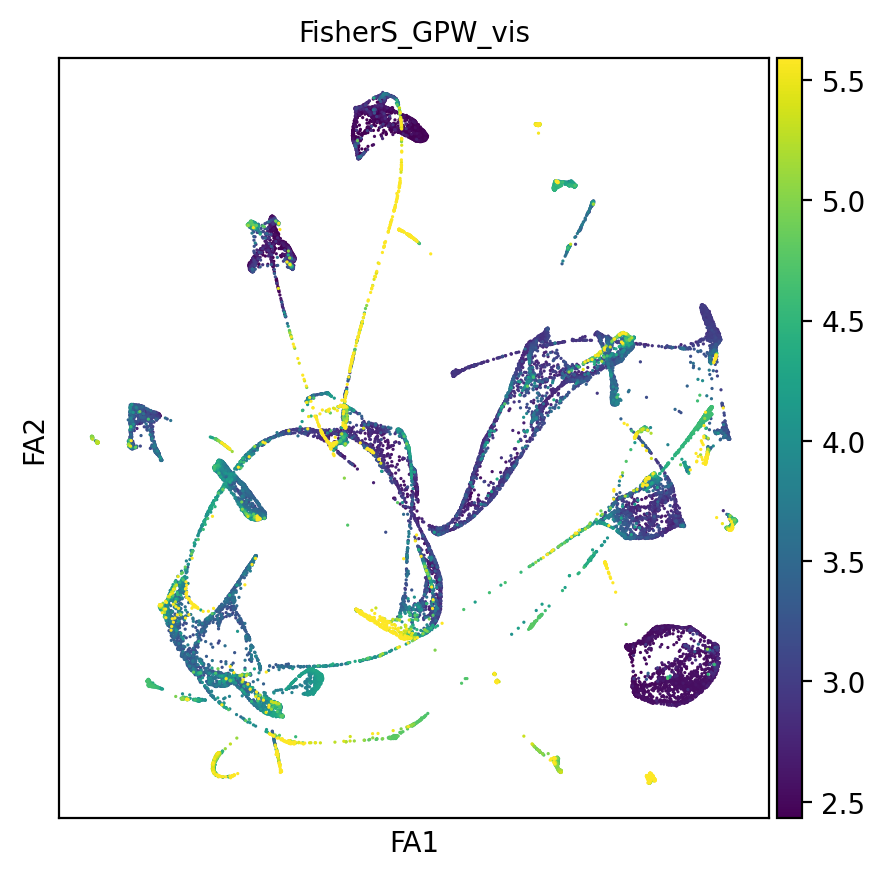

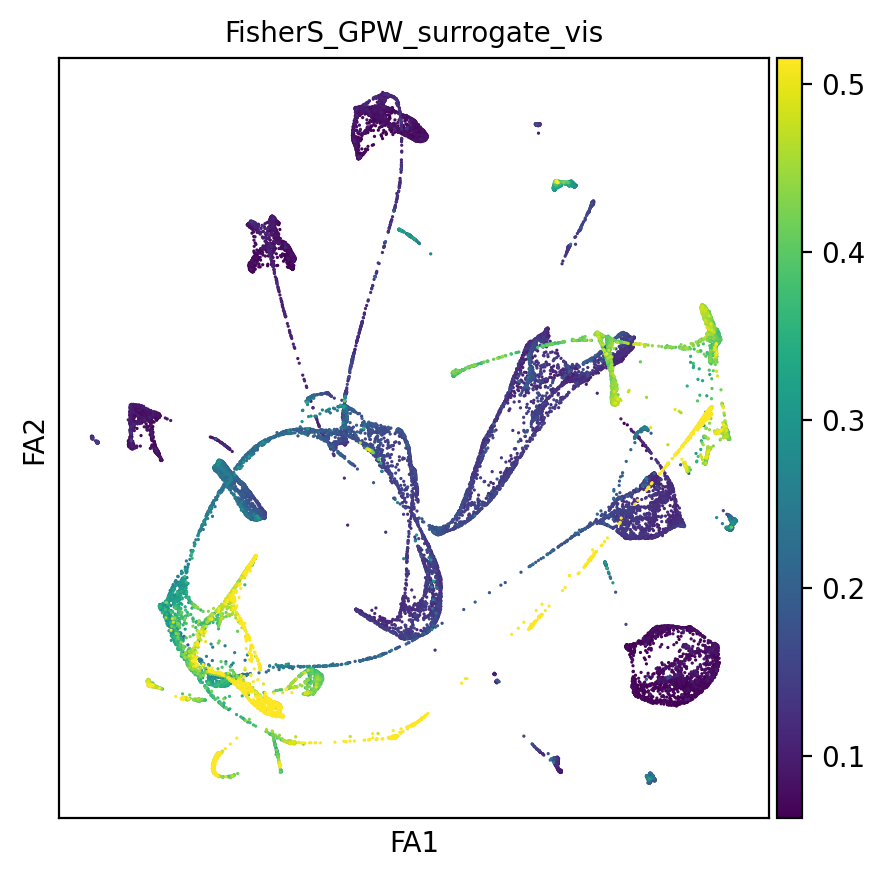

In [22]:
sc.set_figure_params(dpi=100, fontsize=10, figsize=(5,5))
sc.pl.draw_graph(adata,color='age')
sc.pl.draw_graph(adata,color='cluster')
sc.pl.draw_graph(adata,color='Order4')
sc.pl.draw_graph(adata,color='Order5')
sc.pl.draw_graph(adata[inds4,:],color='Order4_s')
sc.pl.draw_graph(adata[inds5,:],color='Order5_s')
sc.pl.draw_graph(adata,color='CytoTRACE')
sc.pl.draw_graph(adata,color='FisherS_GPW_vis')
sc.pl.draw_graph(adata,color='FisherS_GPW_surrogate_vis')

Order_age,1,2,3,4,5,6,7,8
cluster,,,,,,,,
Astro-adult,0,0,0,12,122,10,241,574
Astro-juv,0,0,0,140,131,343,8,65
CA3-Pyr,0,0,1,185,131,103,10,33
Cajal-Retzius,114,136,151,9,47,26,3,22
Ependymal,8,72,45,13,0,6,24,2
GABA,0,0,3,39,15,33,3,96
GC-adult,0,0,0,138,261,17,44,1831
GC-juv,0,0,8,1427,676,1085,5,120
Immature-Astro,0,124,514,1,0,11,0,0


cluster
Astro-adult              959
Astro-juv                687
CA3-Pyr                  463
Cajal-Retzius            508
Ependymal                170
GABA                     189
GC-adult                2291
GC-juv                  3321
Immature-Astro           650
Immature-GABA           1022
Immature-GC             2361
Immature-Pyr            4518
MOL                      688
MiCajal-Retziusoglia     404
NFOL                     226
Neuroblast              1366
OPC                      666
RGL                      159
RGL_young                685
nIPC                     347
nIPC-perin               467
dtype: int64
Order_age
1    2181
2    4749
3    4298
4    2383
5    1795
6    2483
7    1150
8    3108
dtype: int64


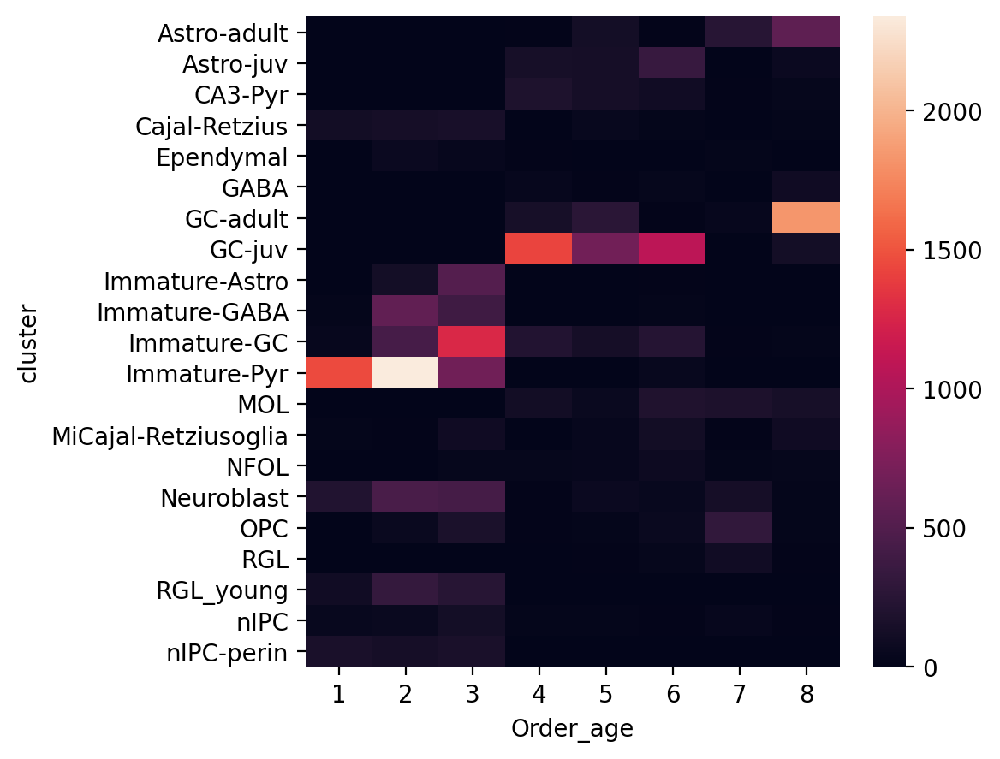

In [156]:
#co_mat = pd.crosstab(adata.obs['cluster'], adata.obs['age'])
co_mat = pd.crosstab(adata.obs['cluster'], adata.obs['Order_age'])
display(co_mat)
sns.heatmap(co_mat)
print(np.sum(co_mat,axis=1))
print(np.sum(co_mat,axis=0))

['Astro-adult' 'Astro-juv' 'CA3-Pyr' 'Cajal-Retzius' 'Ependymal' 'GABA'
 'GC-adult' 'GC-juv' 'Immature-Astro' 'Immature-GABA' 'Immature-GC'
 'Immature-Pyr' 'MOL' 'MiCajal-Retziusoglia' 'NFOL' 'Neuroblast' 'OPC'
 'RGL' 'RGL_young' 'nIPC' 'nIPC-perin']
Astro-adult


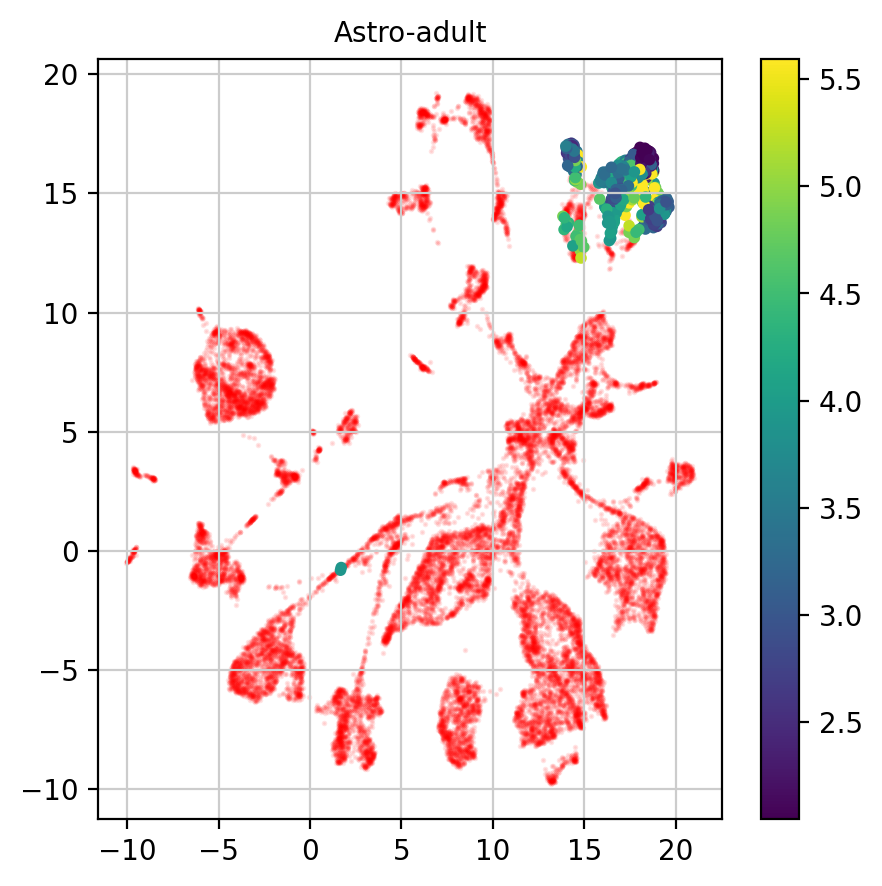

Astro-juv


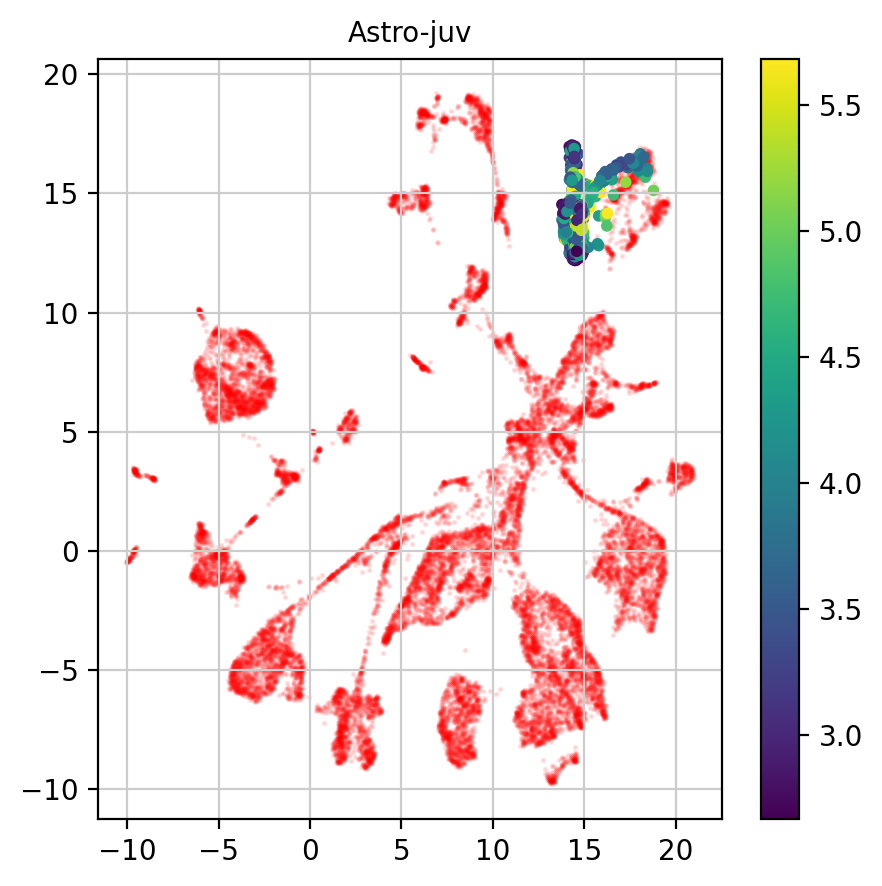

CA3-Pyr


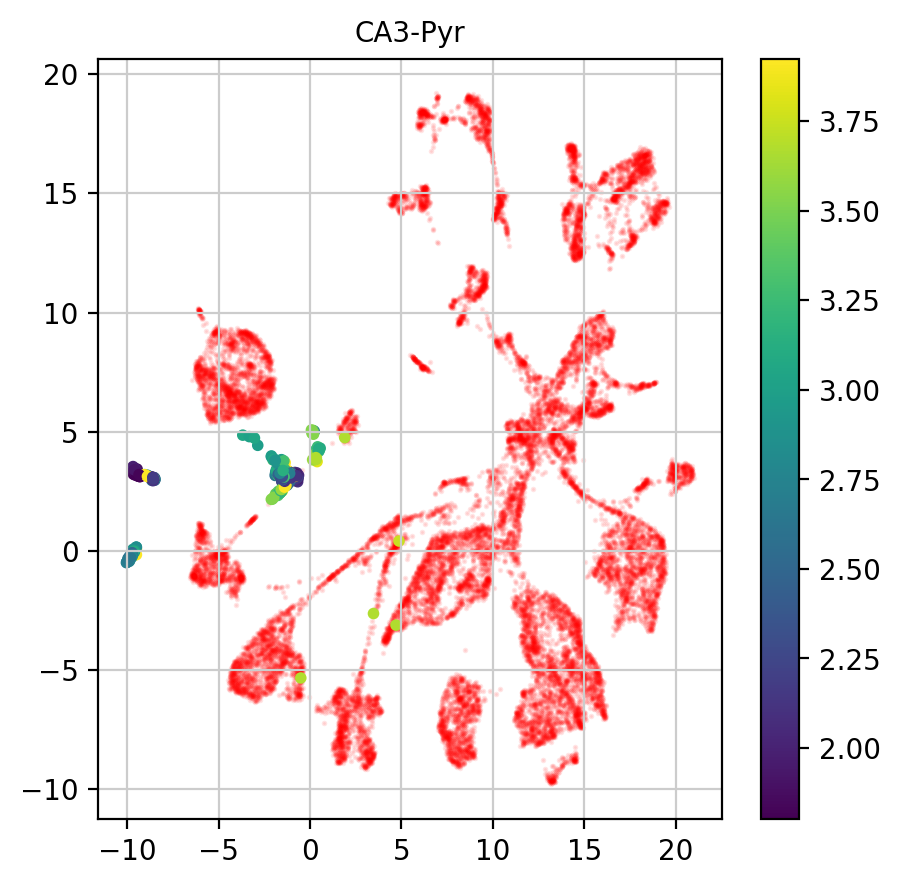

Cajal-Retzius


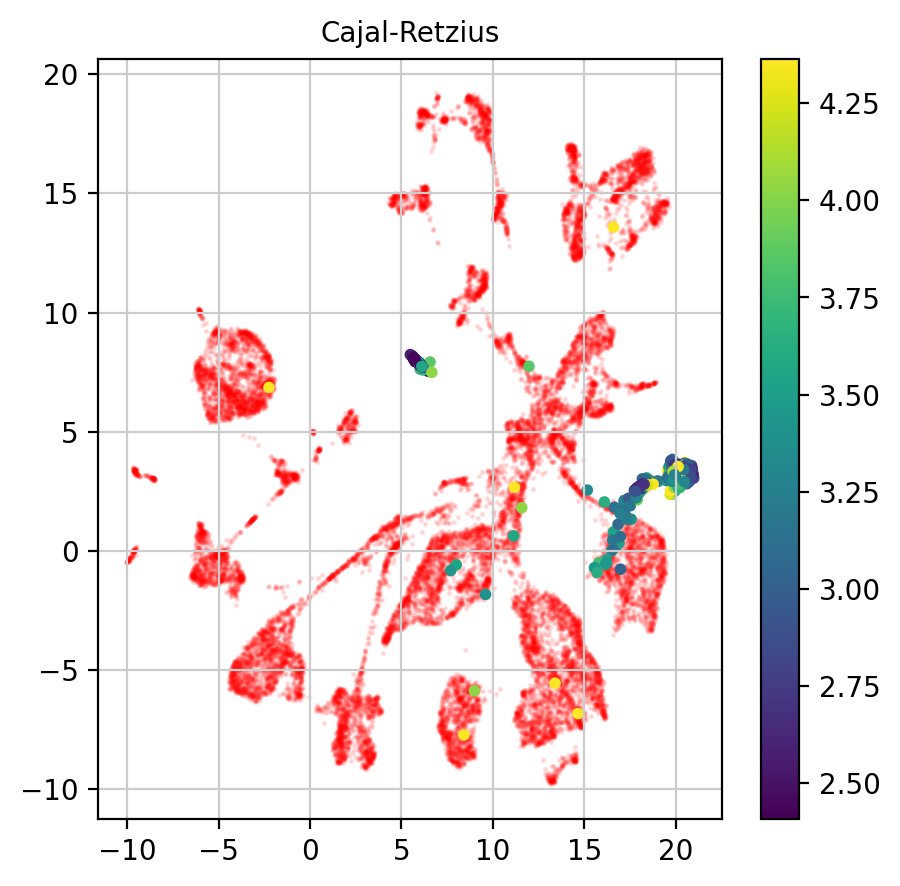

Ependymal


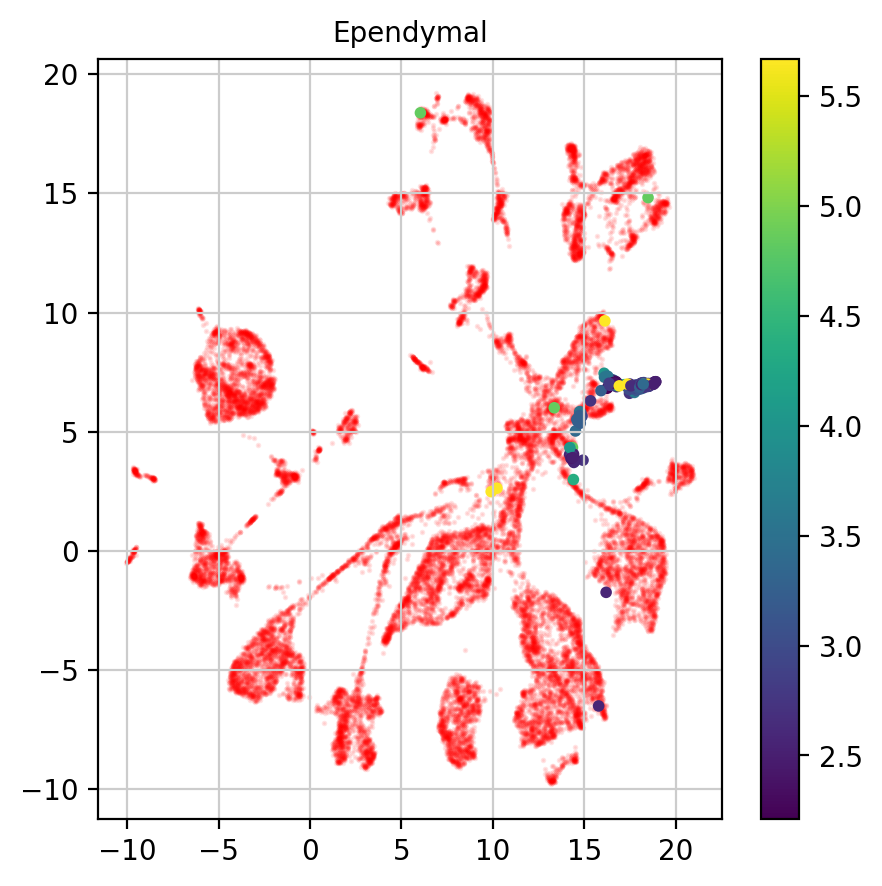

GABA


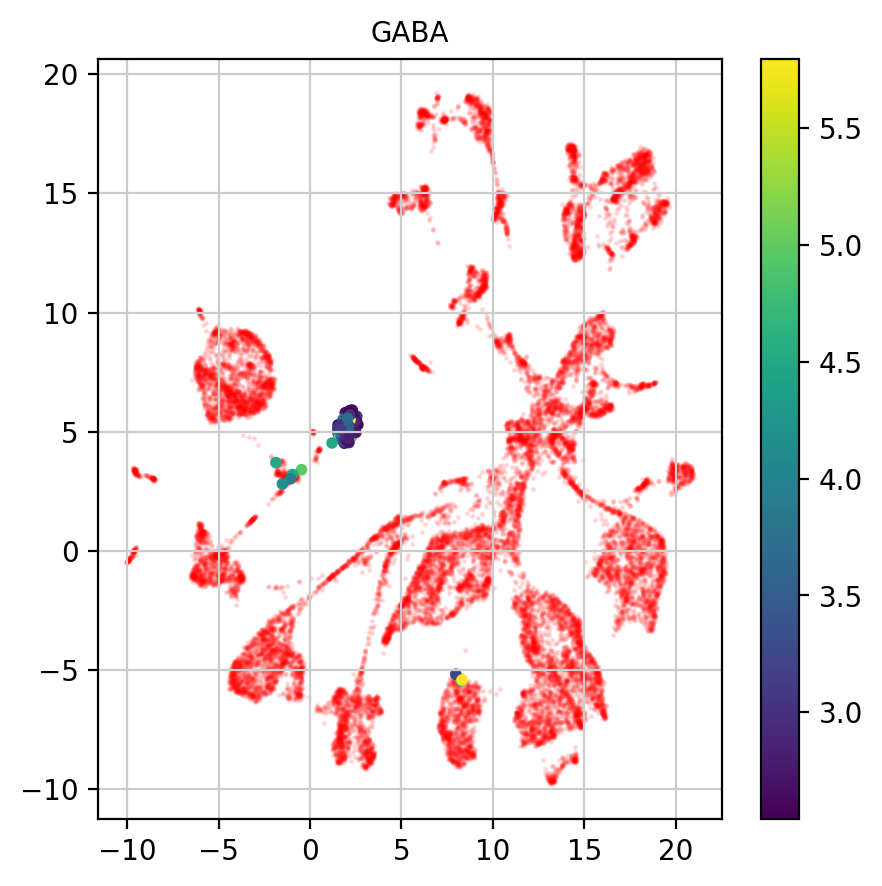

GC-adult


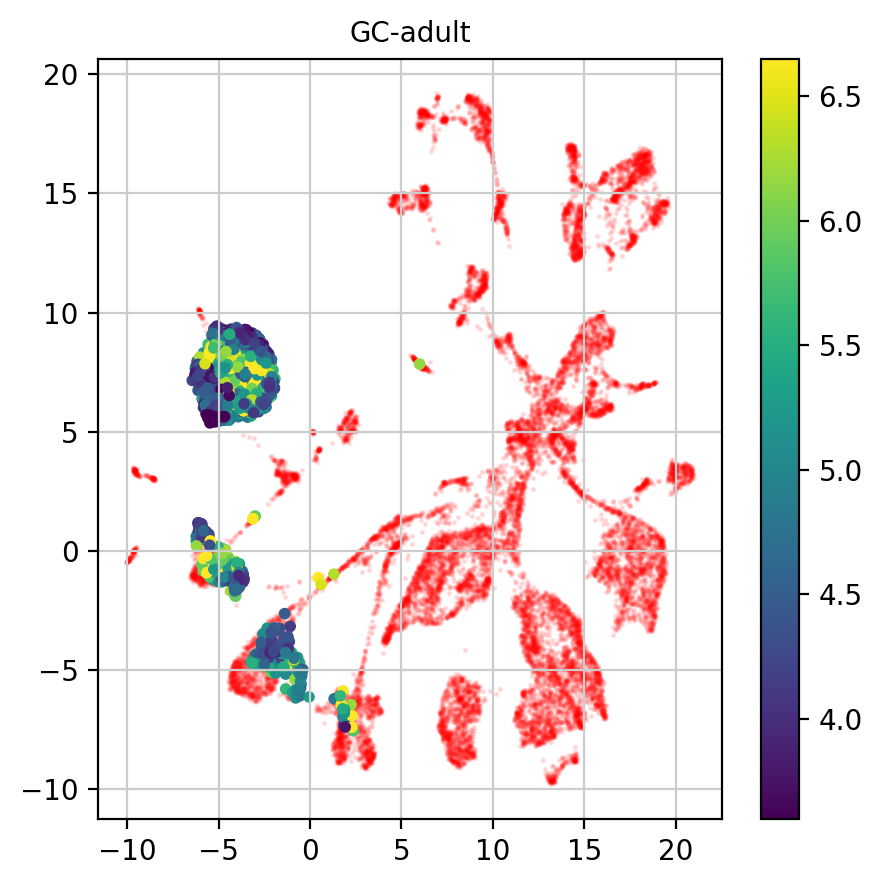

GC-juv


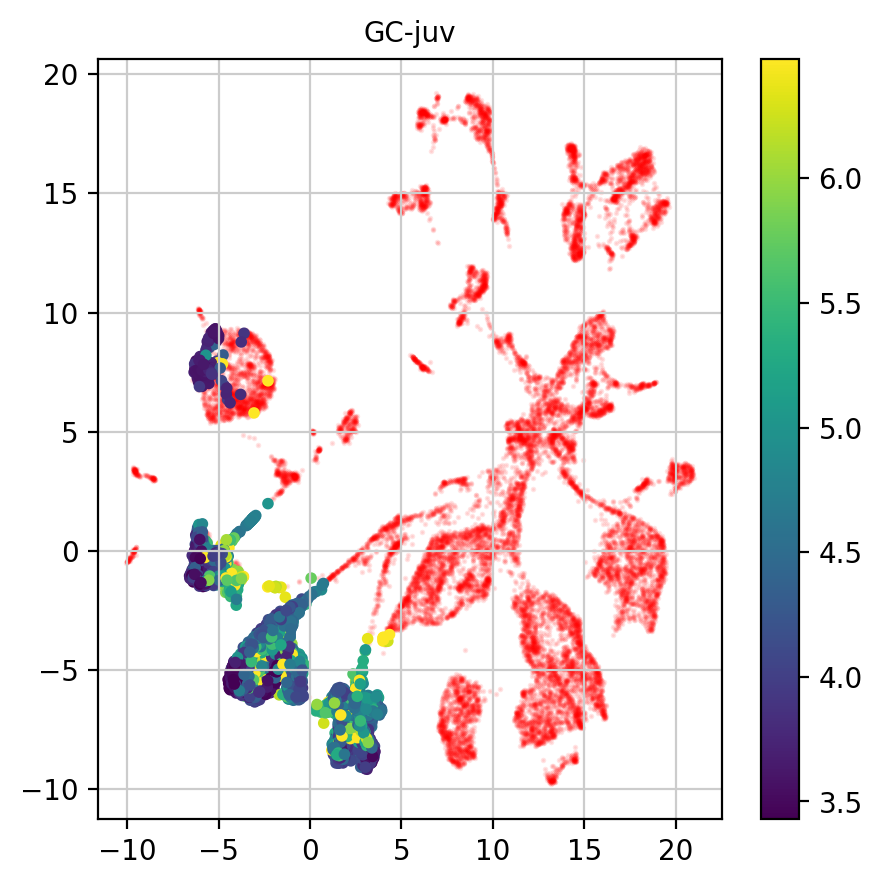

Immature-Astro


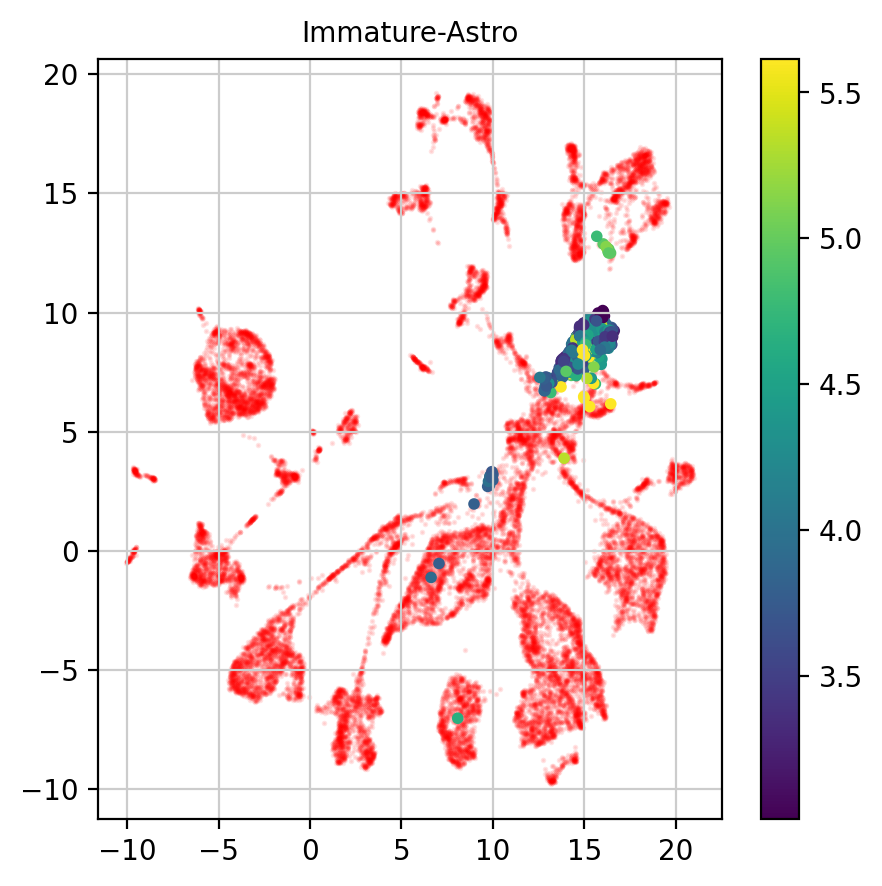

Immature-GABA


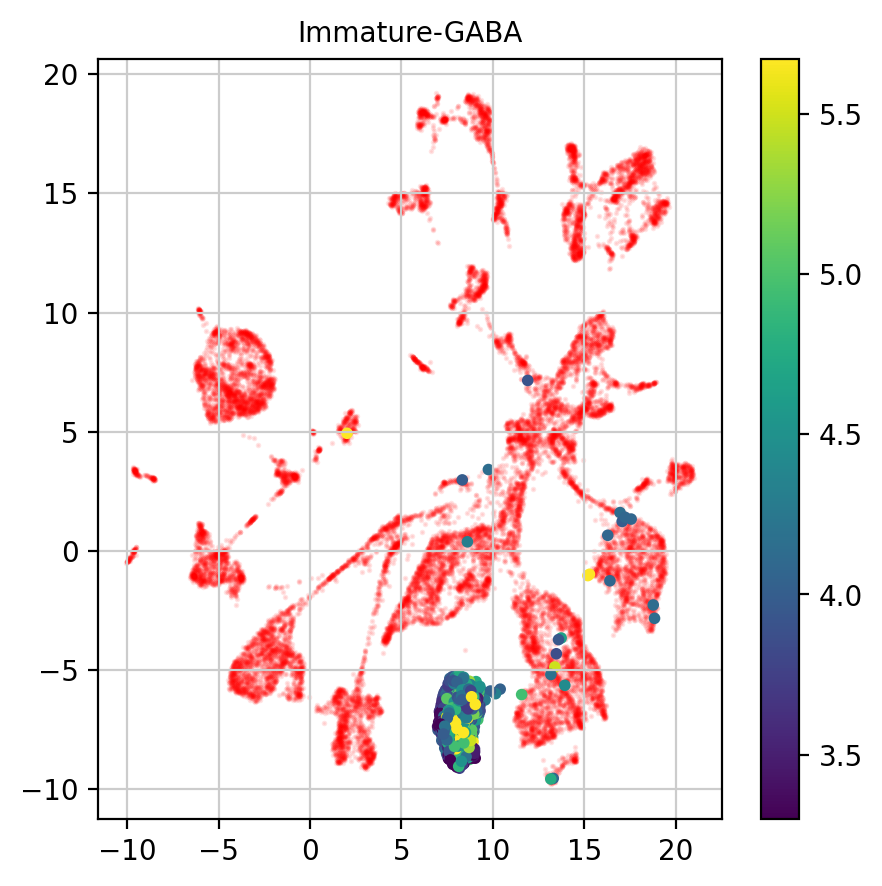

Immature-GC


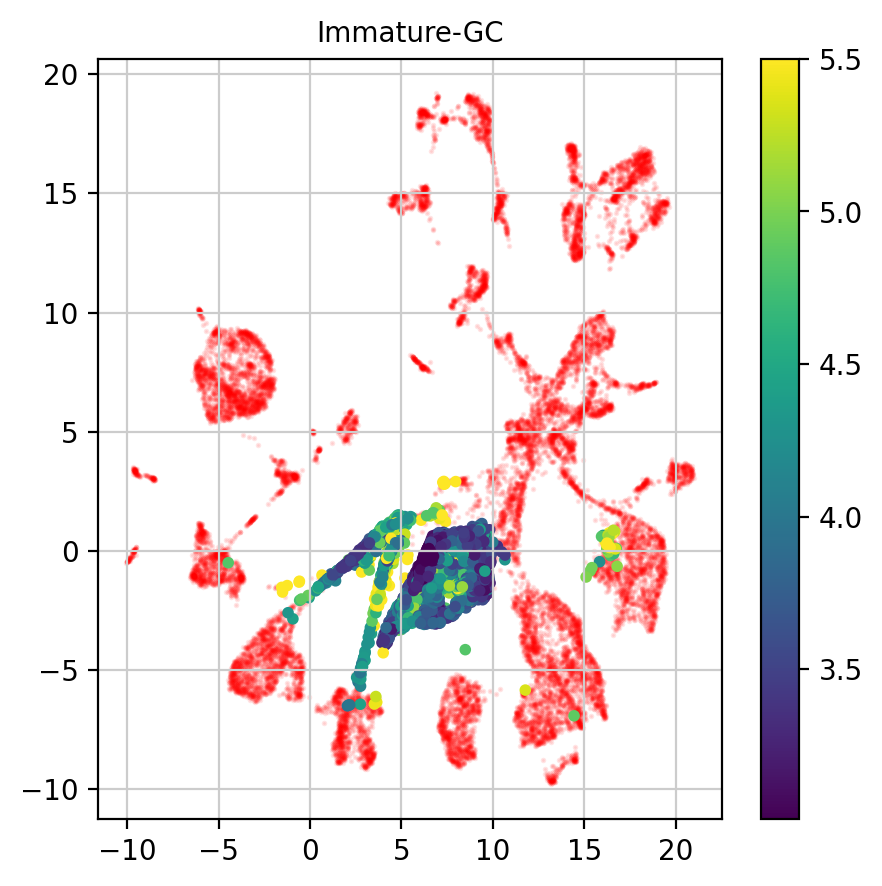

Immature-Pyr


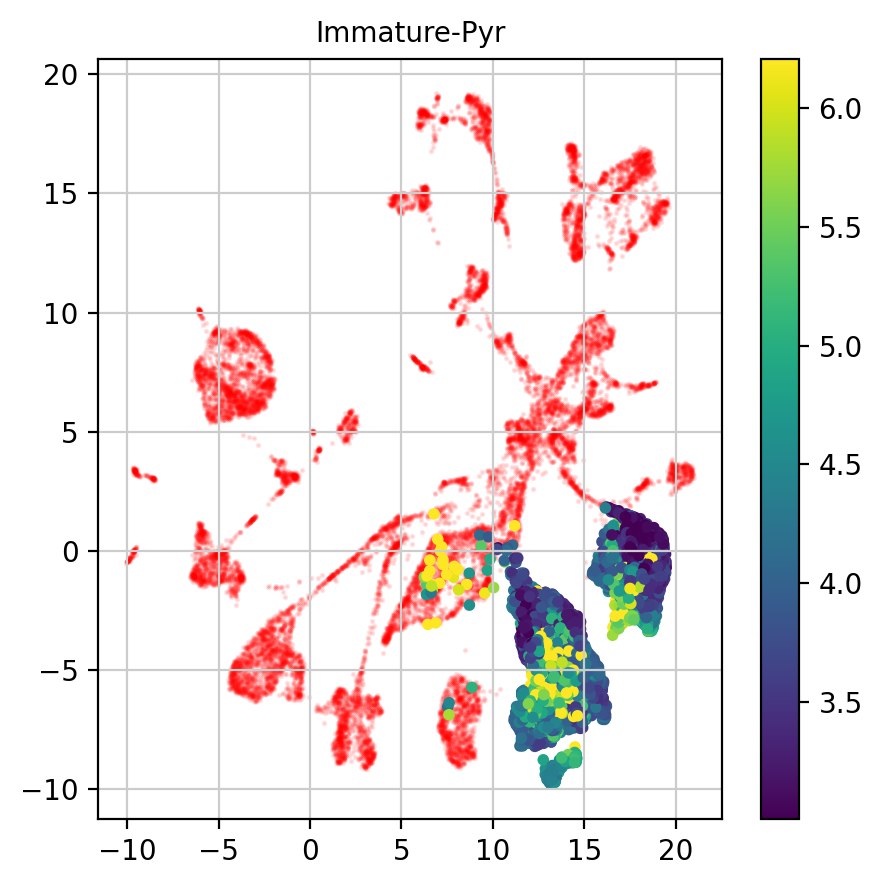

MOL


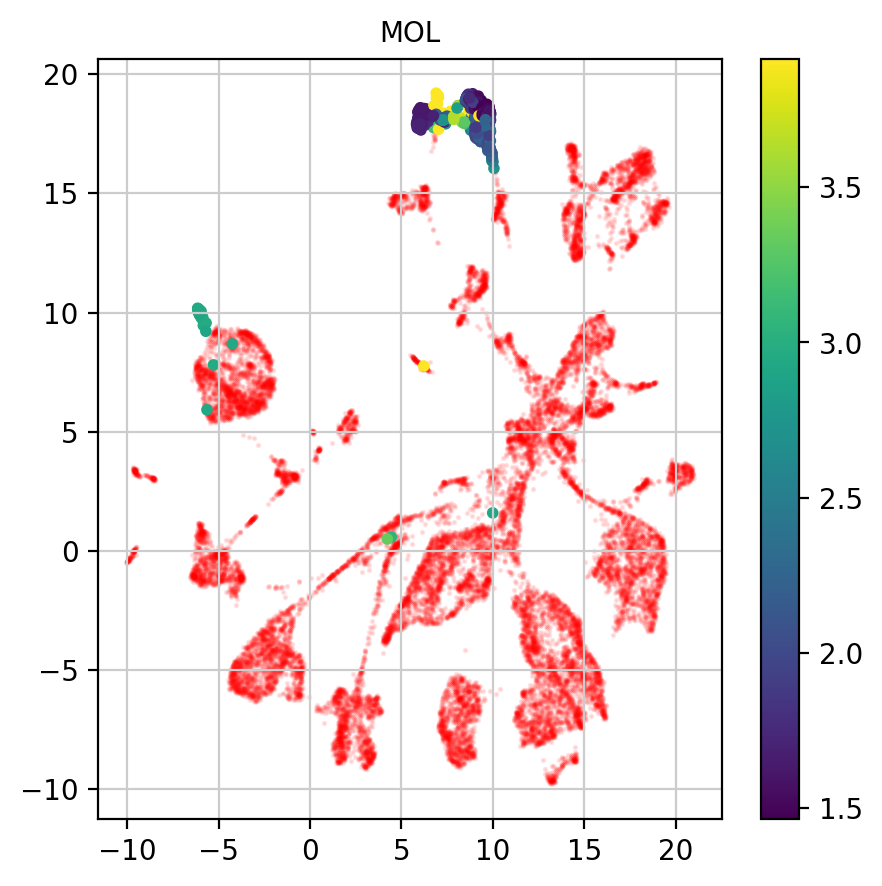

MiCajal-Retziusoglia


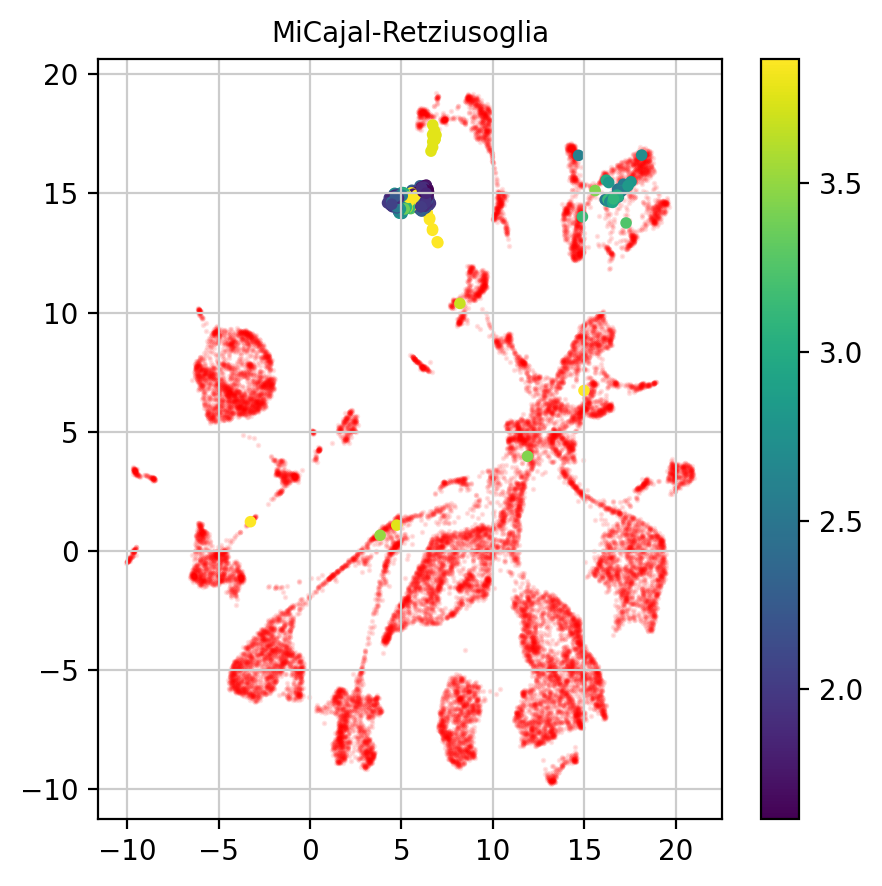

NFOL


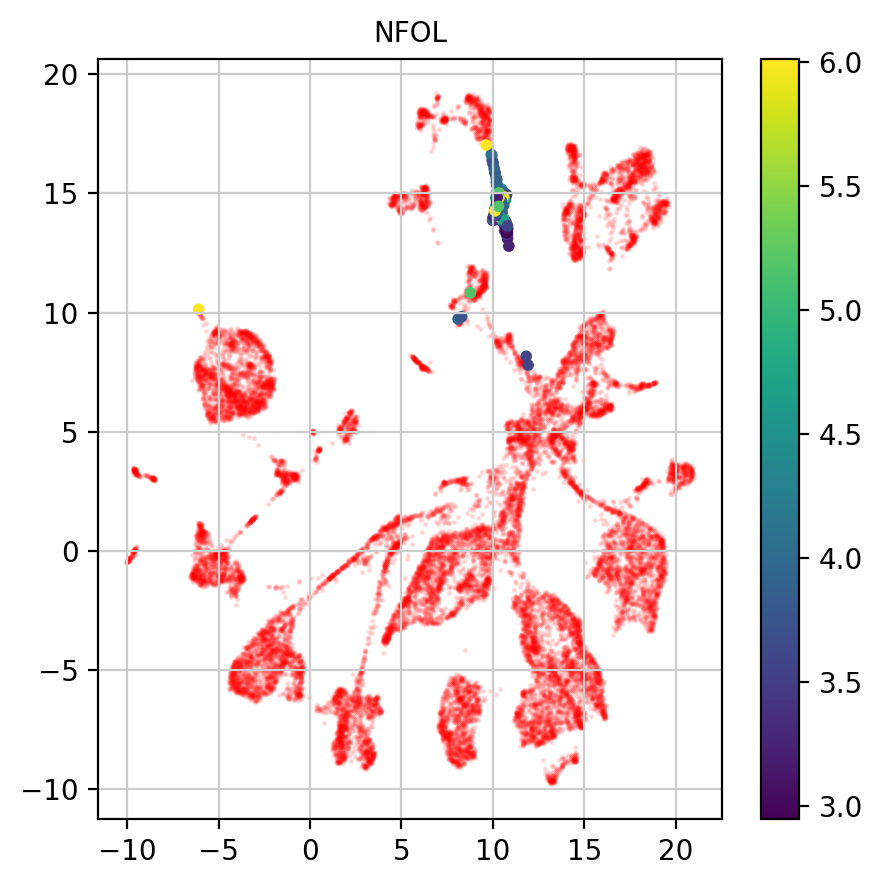

Neuroblast


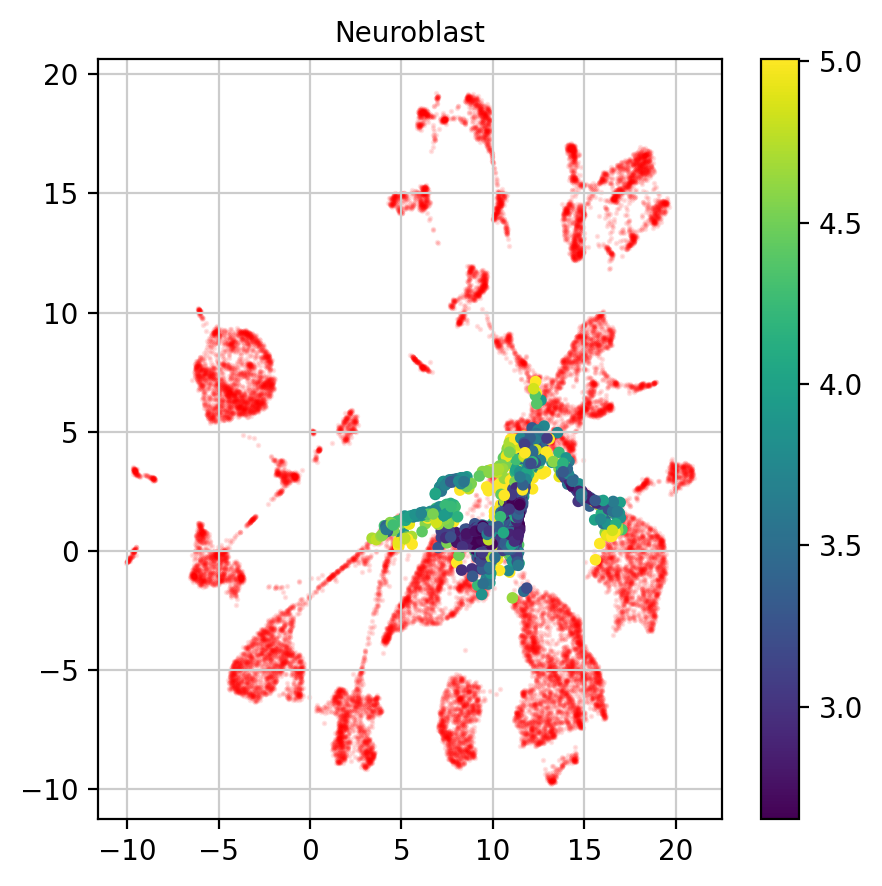

OPC


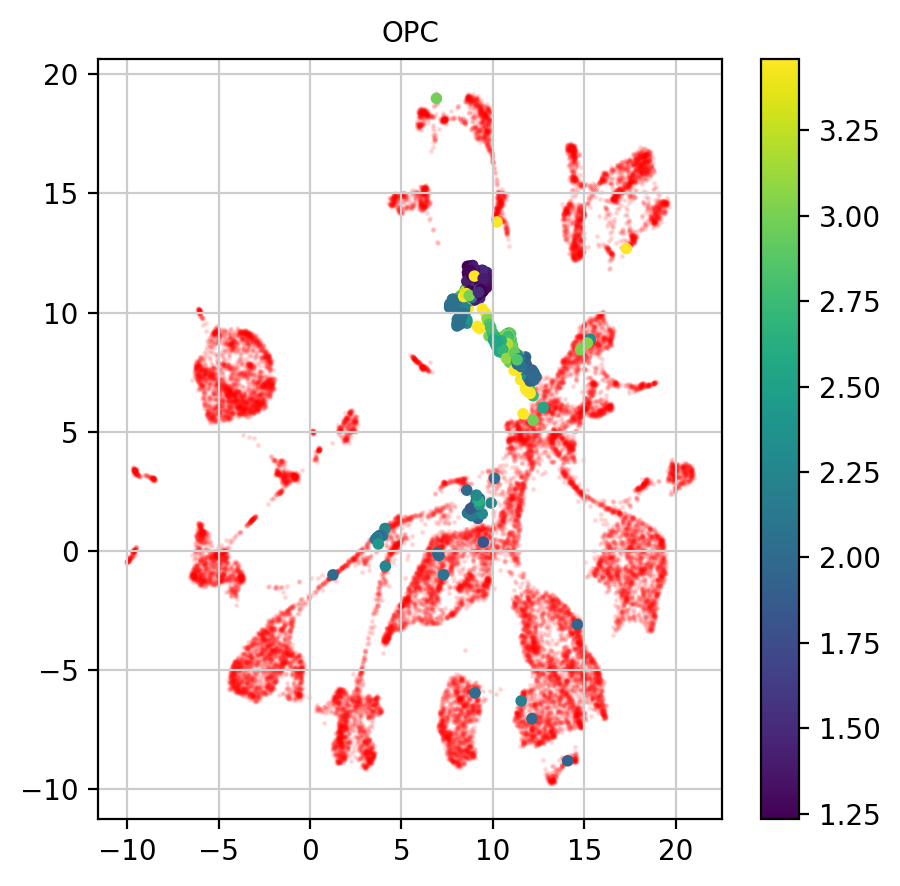

RGL


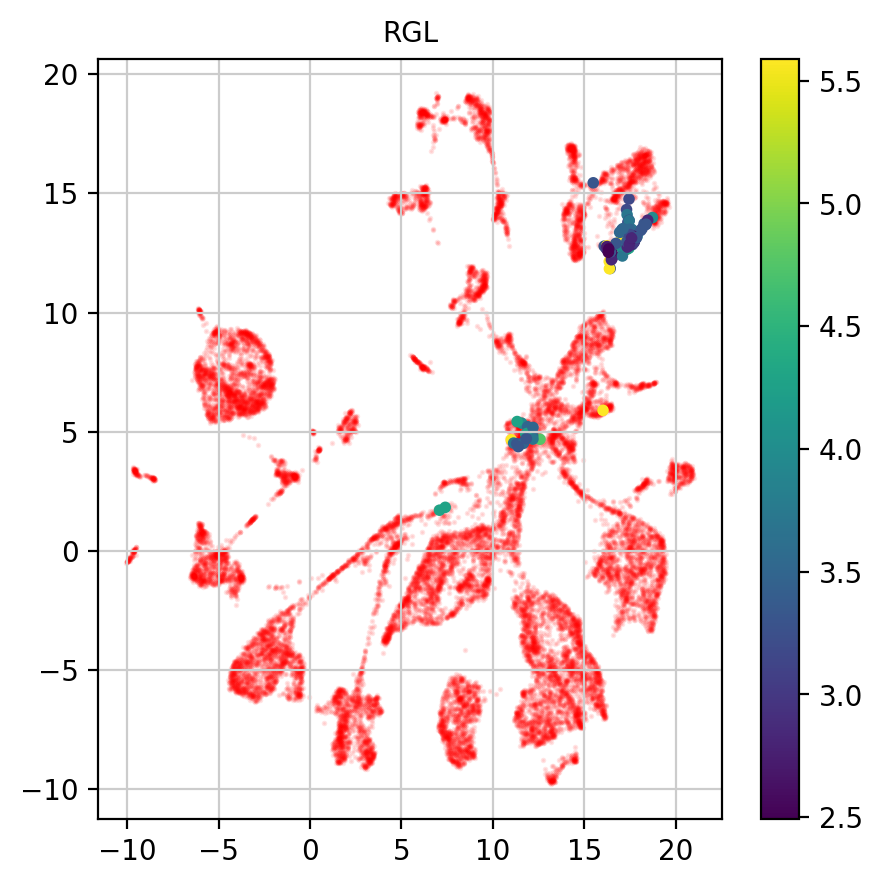

RGL_young


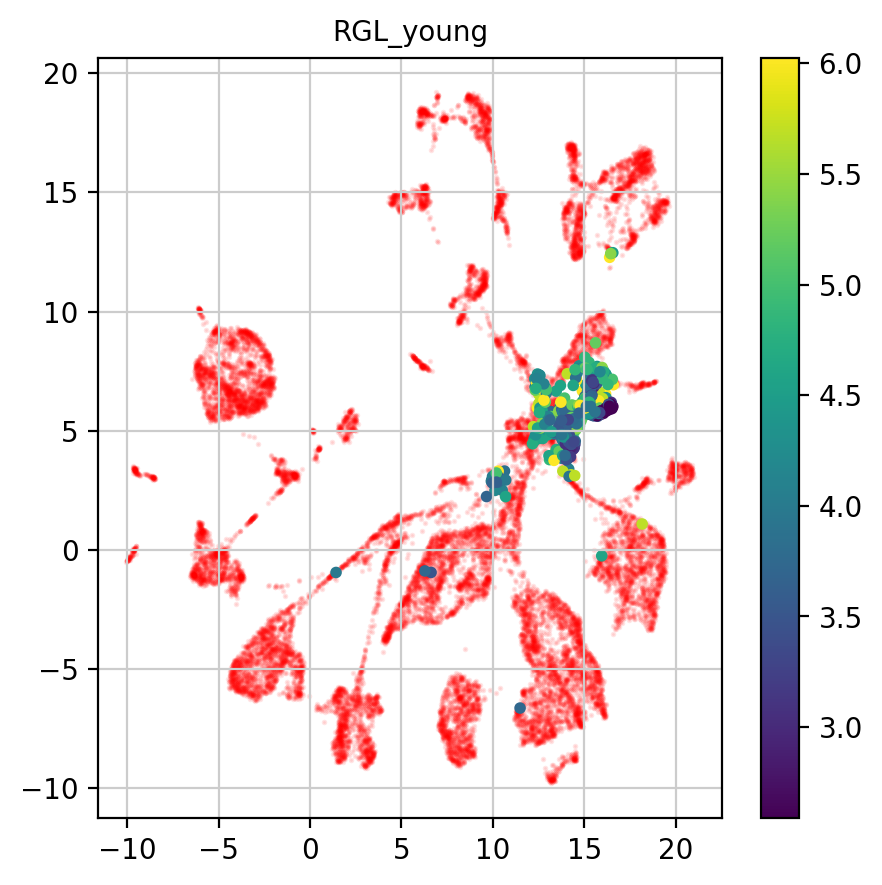

nIPC


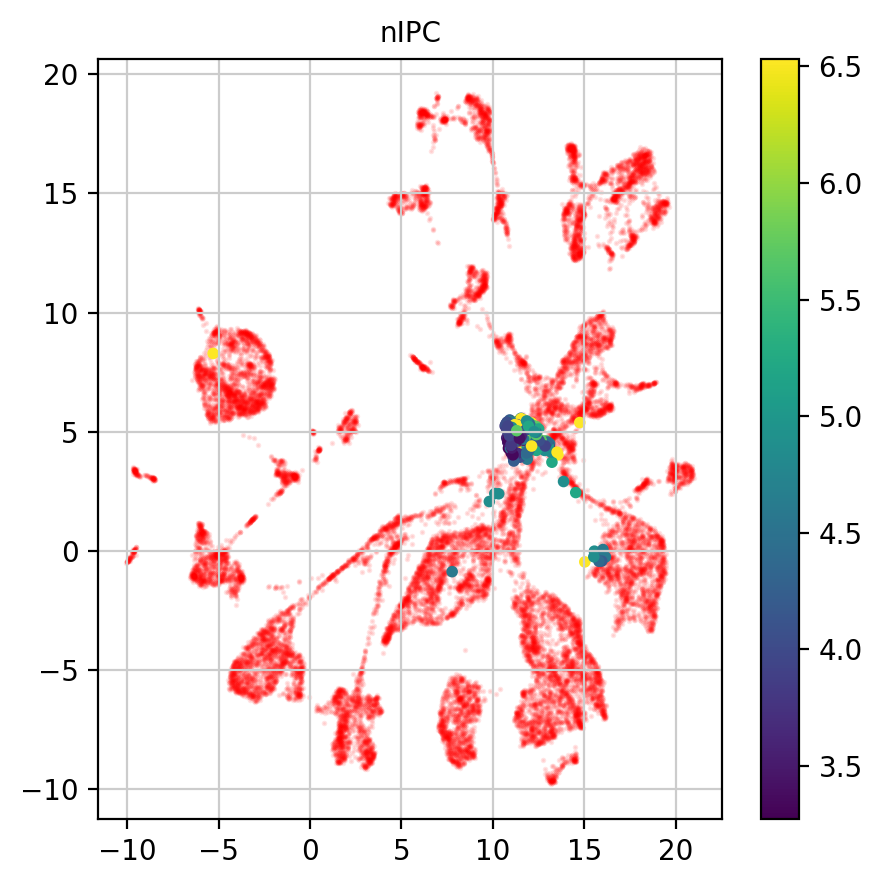

nIPC-perin


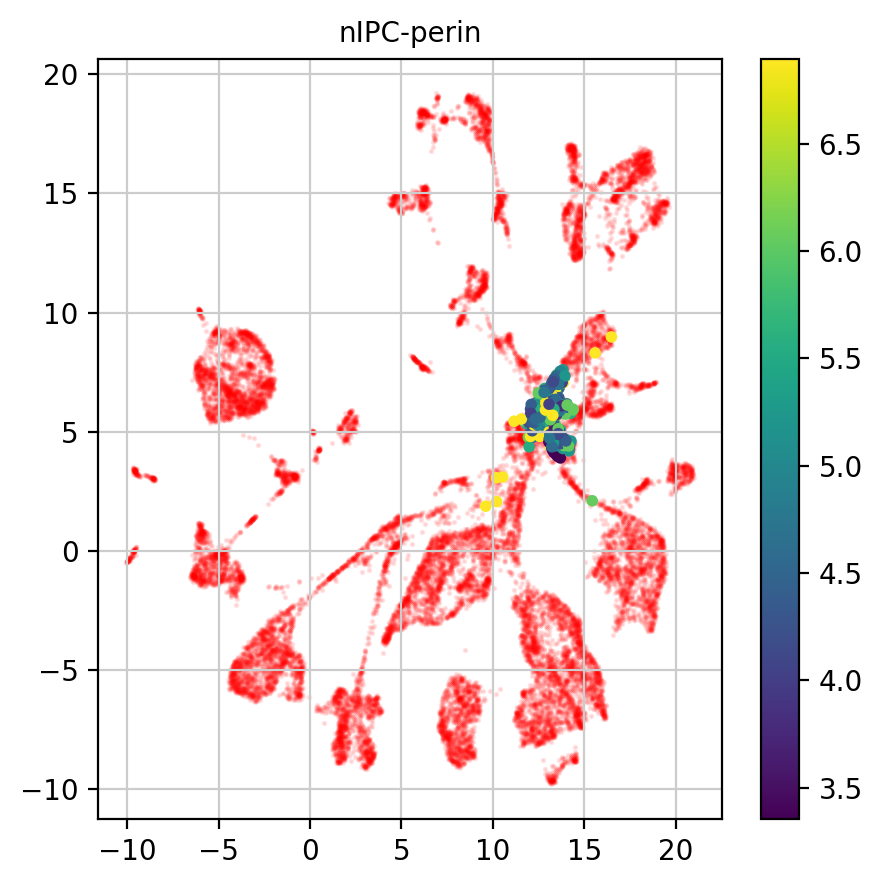

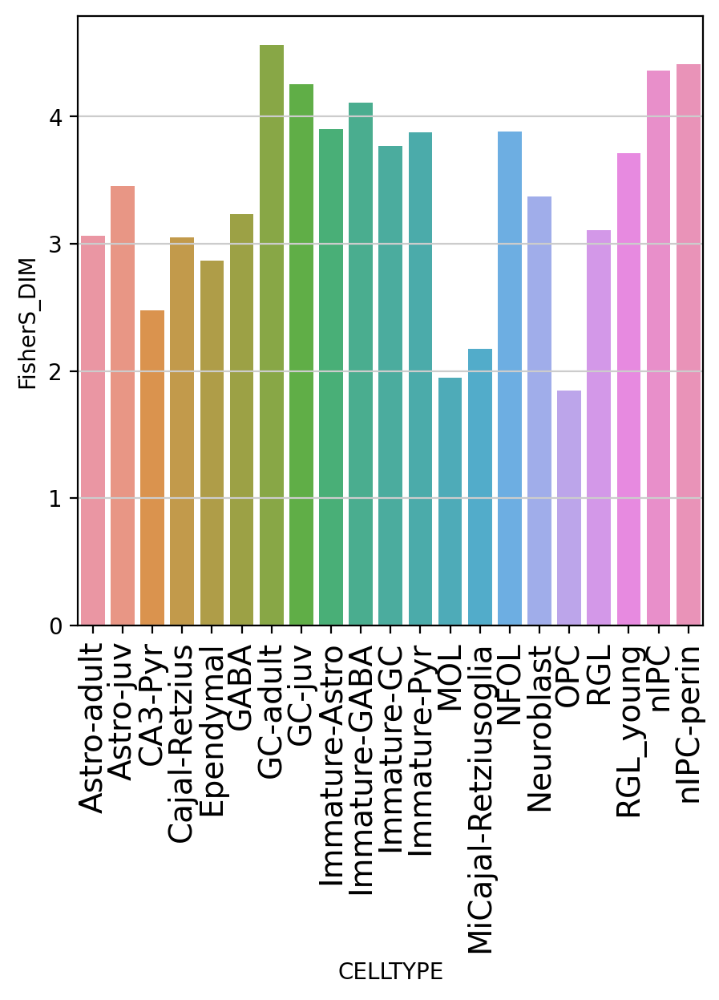

In [159]:
# estimate dimensionality by subsets
celltypes = np.unique(adata.obs['cluster'])
celltype_dimension = []
print(celltypes)
#embedding = 'X_pca'
cond_number = 10
embedding = 'X_umap'
#embedding = 'X_draw_graph_fa'
for ct in celltypes:
    print(ct)
    inds = np.argwhere(np.array(adata.obs['cluster']==ct)).flatten()
    
    fishers = skdim.lid.FisherS(conditional_number=cond_number).fit(X_pca[inds,:])
    glob_pw = fishers.point_inseparability_to_pointID(idx='selected')[0]
    glob_pw = winsorize(glob_pw, limits=(0.01,0.01), inclusive=(True, True), inplace=True)
    glob_pw_vis = winsorize(glob_pw, limits=(0.05,0.05), inclusive=(True, True), inplace=True)
    fisherS_global = fishers.dimension_
    celltype_dimension.append(fisherS_global)
    
    plt.scatter(adata.obsm[embedding][:,0],adata.obsm[embedding][:,1],s=1,c='r',alpha=0.1)
    plt.scatter(adata.obsm[embedding][inds,0],adata.obsm[embedding][inds,1],s=10,c=glob_pw_vis)
    plt.title(ct)
    plt.colorbar()
    plt.show()    

df = pd.DataFrame(data={'CELLTYPE':celltypes,'FisherS_DIM':celltype_dimension})
sns.barplot(data=df,x='CELLTYPE',y='FisherS_DIM')
plt.xticks(rotation='vertical',fontsize=14)
plt.show()

['Astro-adult' 'Astro-juv' 'CA3-Pyr' 'Cajal-Retzius' 'Ependymal' 'GABA'
 'GC-adult' 'GC-juv' 'Immature-Astro' 'Immature-GABA' 'Immature-GC'
 'Immature-Pyr' 'MOL' 'MiCajal-Retziusoglia' 'NFOL' 'Neuroblast' 'OPC'
 'RGL' 'RGL_young' 'nIPC' 'nIPC-perin']


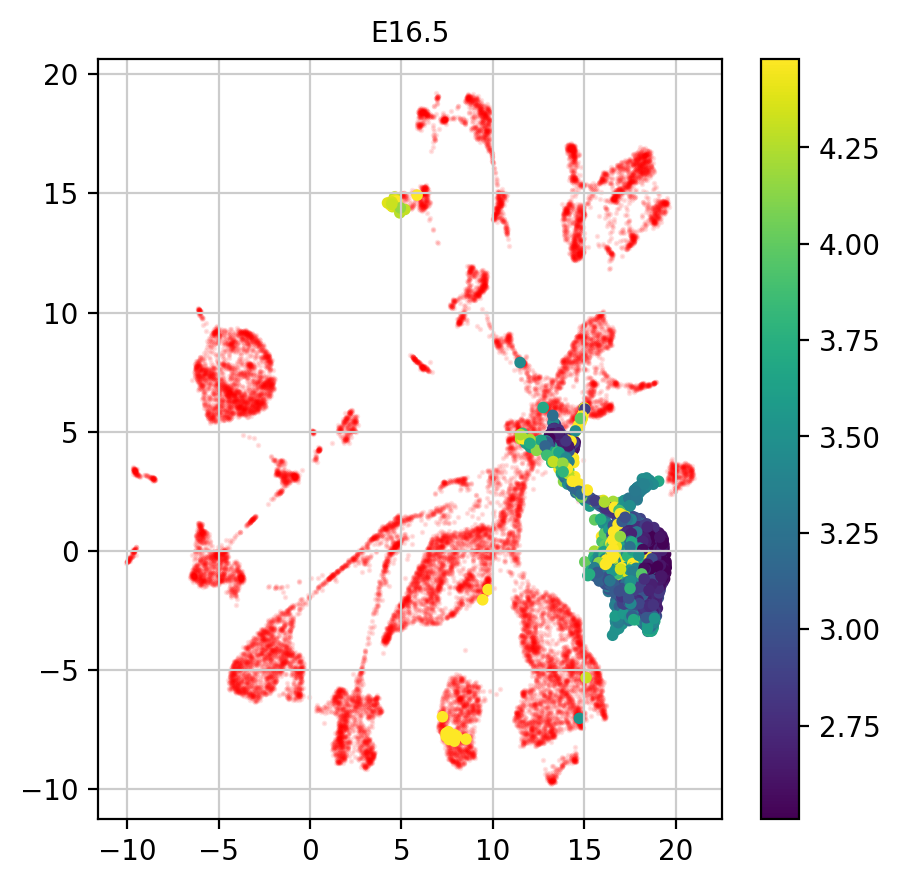

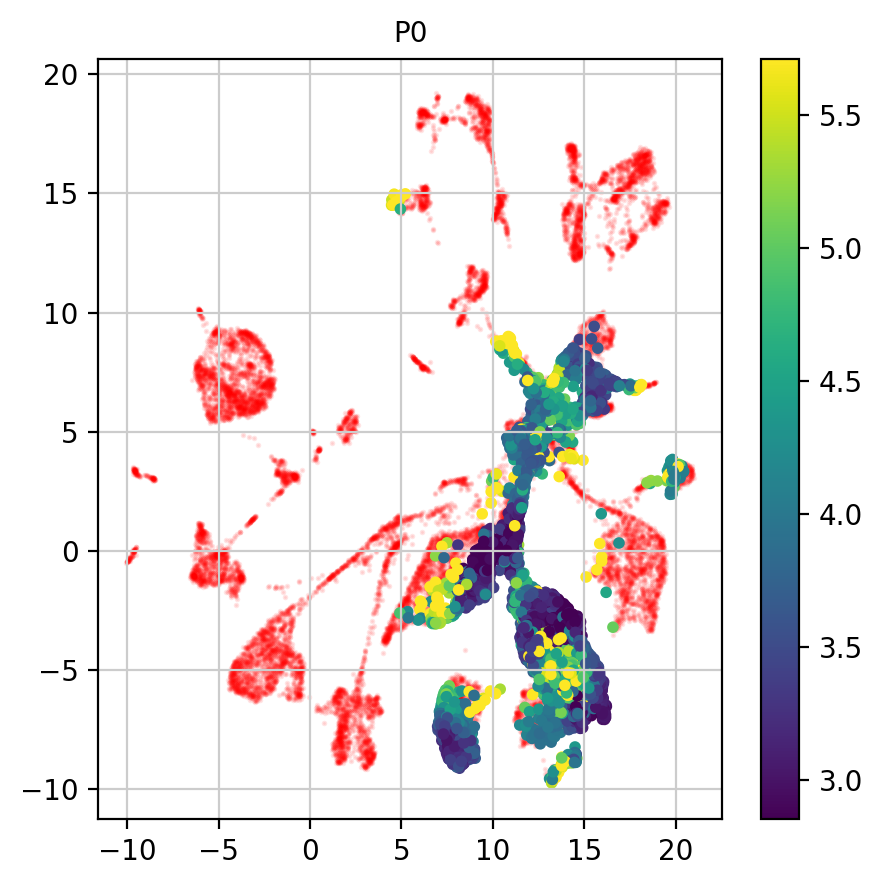

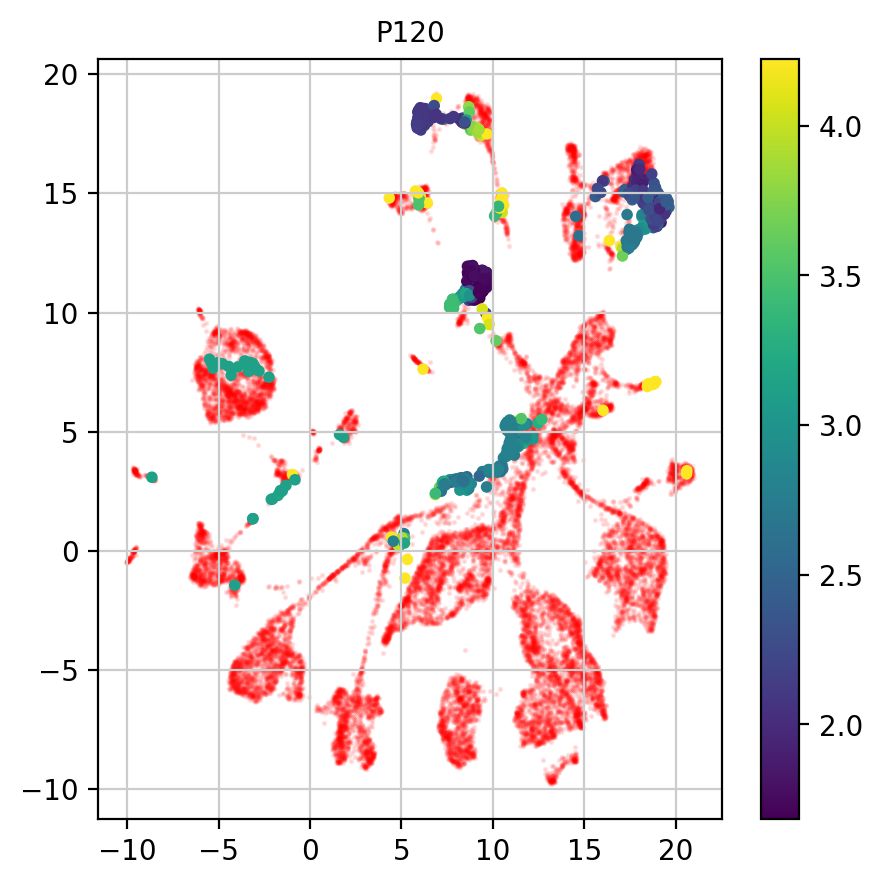

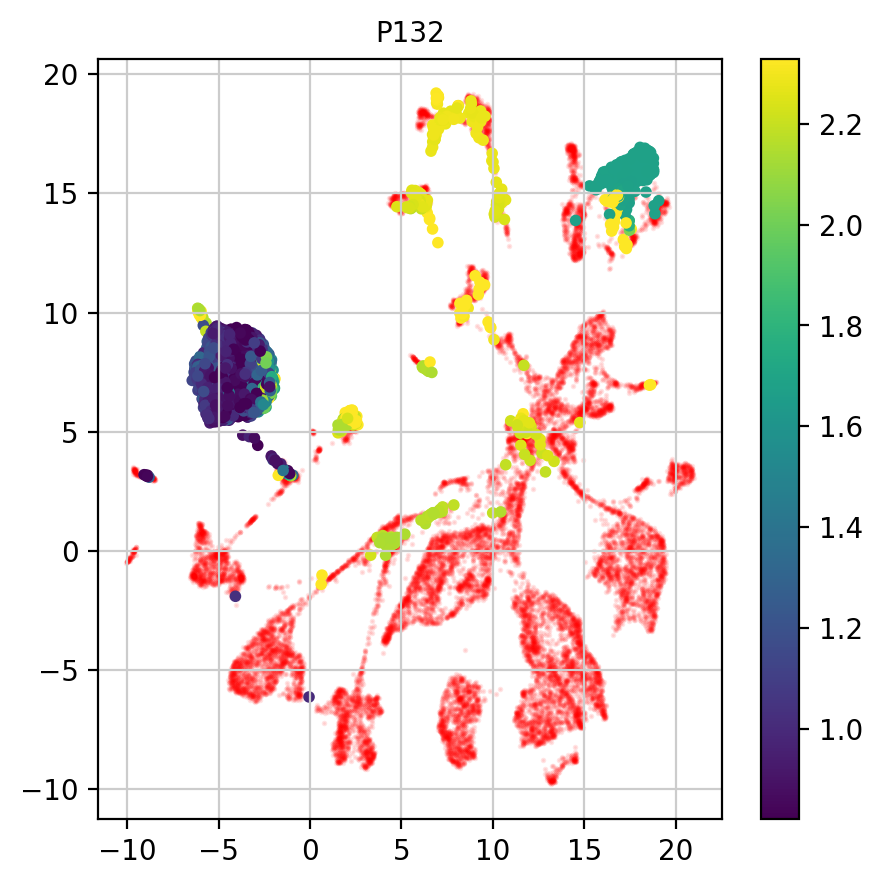

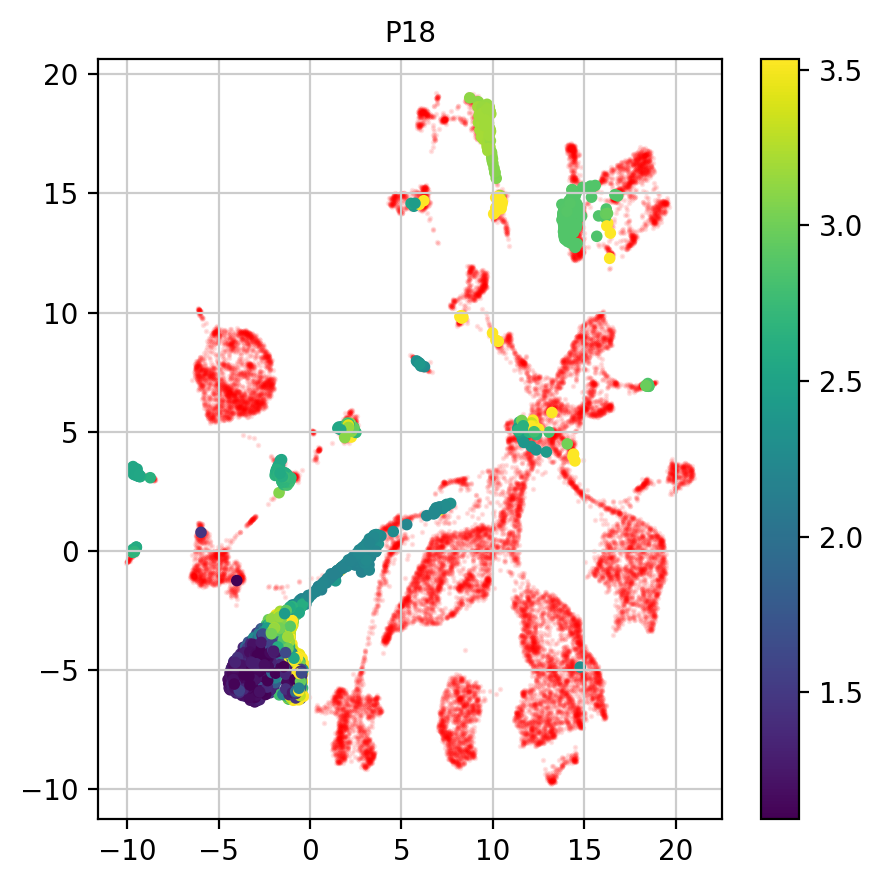

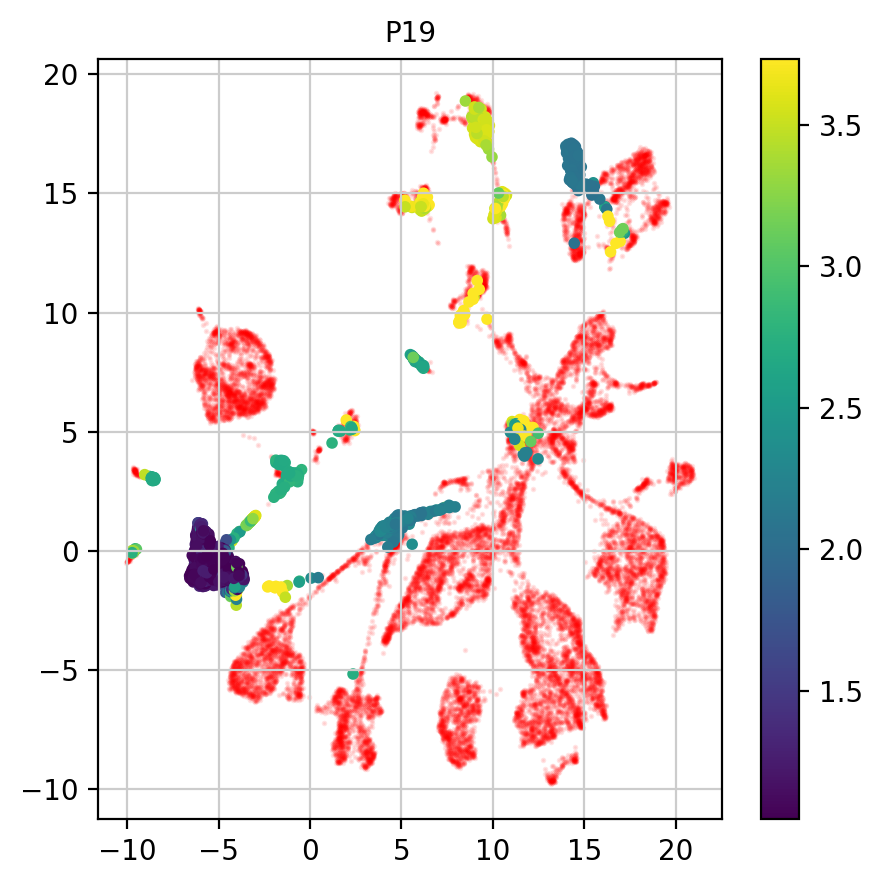

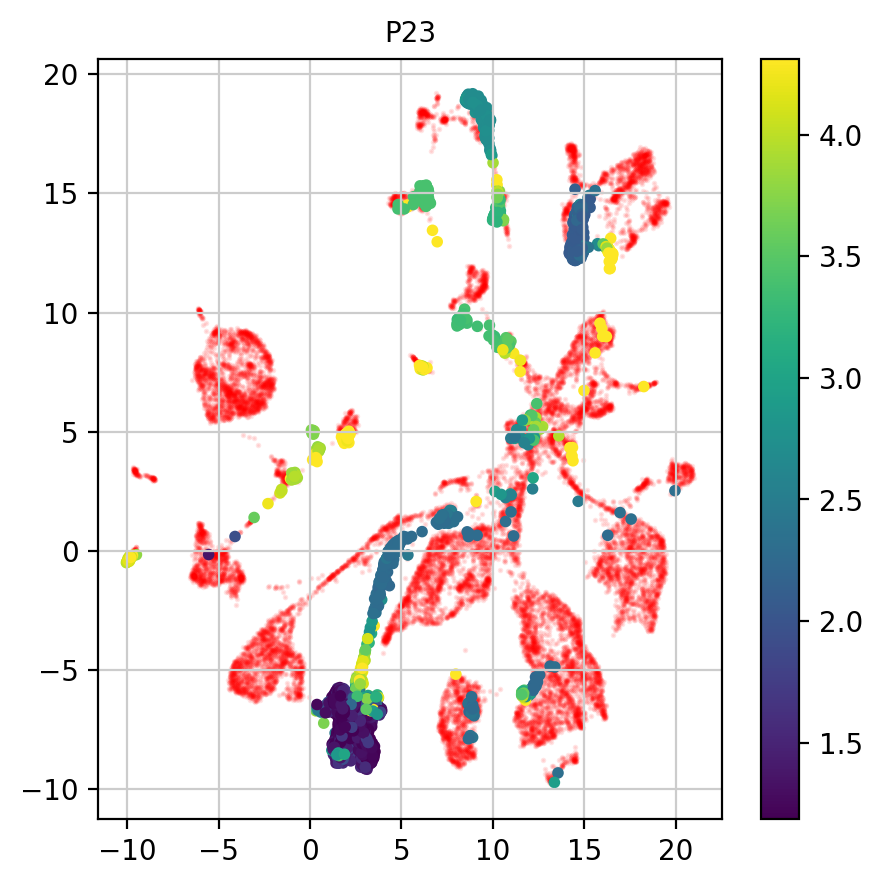

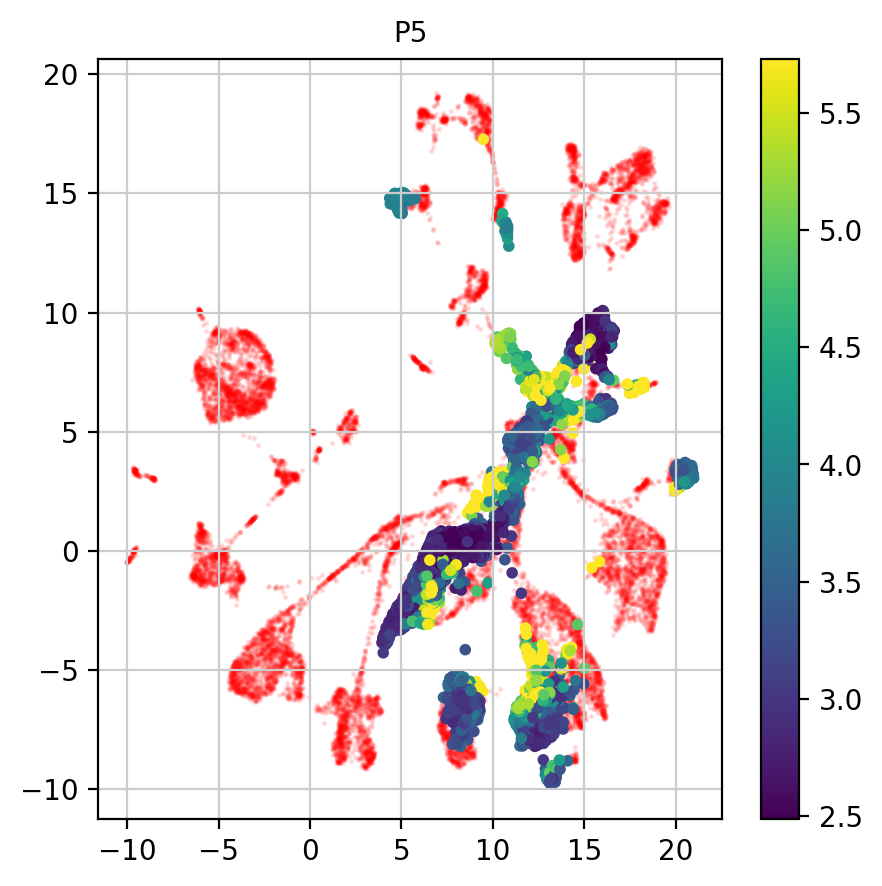

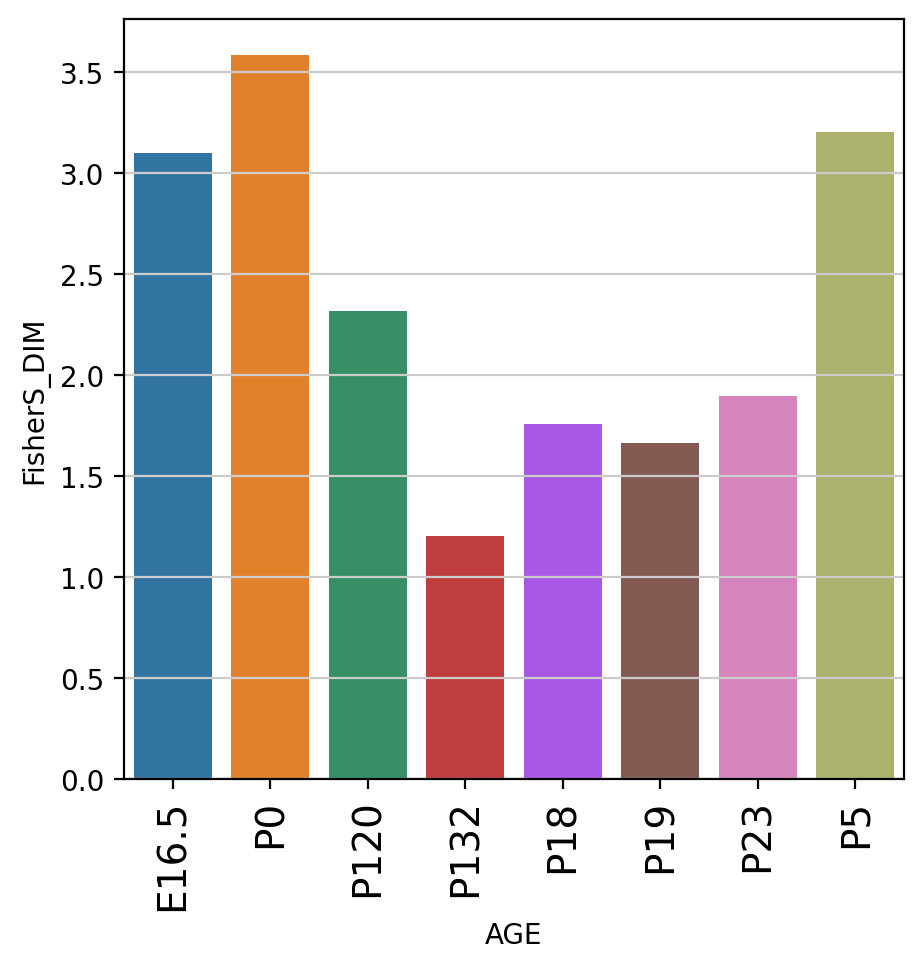

In [194]:
# estimate dimensionality by subsets
ages = np.unique(adata.obs['age'])
order_ages = []
age_dimension = []
print(celltypes)
#embedding = 'X_pca'
cond_number = 10
embedding = 'X_umap'
#embedding = 'X_draw_graph_fa'
for ag in ages:
    inds = np.argwhere(np.array(adata.obs['age']==ag)).flatten()
    
    fishers = skdim.lid.FisherS(conditional_number=cond_number).fit(X_pca[inds,:])
    glob_pw = fishers.point_inseparability_to_pointID(idx='selected')[0]
    glob_pw = winsorize(glob_pw, limits=(0.01,0.01), inclusive=(True, True), inplace=True)
    glob_pw_vis = winsorize(glob_pw, limits=(0.05,0.05), inclusive=(True, True), inplace=True)
    fisherS_global = fishers.dimension_
    age_dimension.append(fisherS_global)
    
    plt.scatter(adata.obsm[embedding][:,0],adata.obsm[embedding][:,1],s=1,c='r',alpha=0.1)
    plt.scatter(adata.obsm[embedding][inds,0],adata.obsm[embedding][inds,1],s=10,c=glob_pw_vis)
    plt.title(ag)
    plt.colorbar()
    plt.show()    

df = pd.DataFrame(data={'AGE':ages,'FisherS_DIM':age_dimension})
sns.barplot(data=df,x='AGE',y='FisherS_DIM')
plt.xticks(rotation='vertical',fontsize=14)
plt.show()


1.0


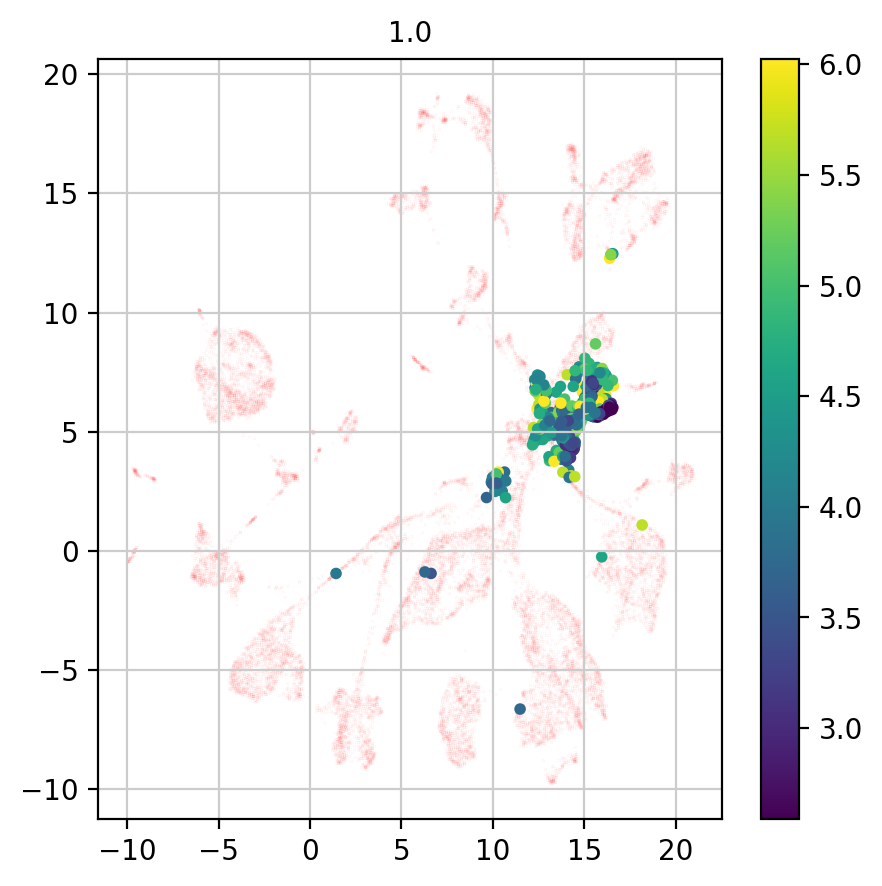

2.0


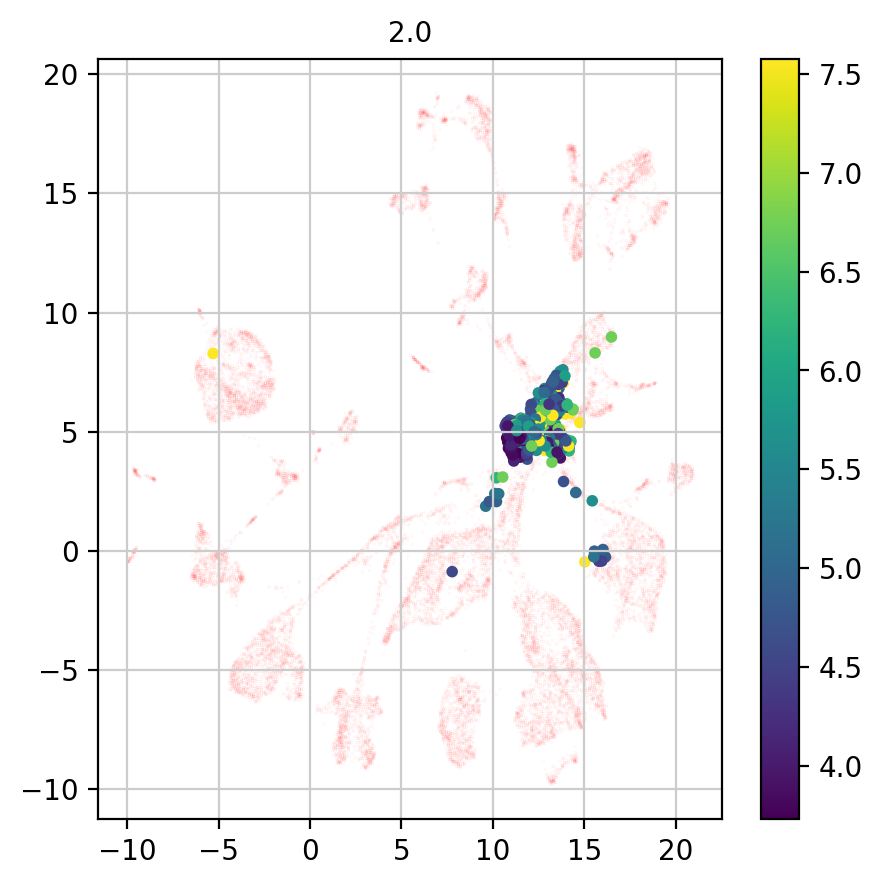

3.0


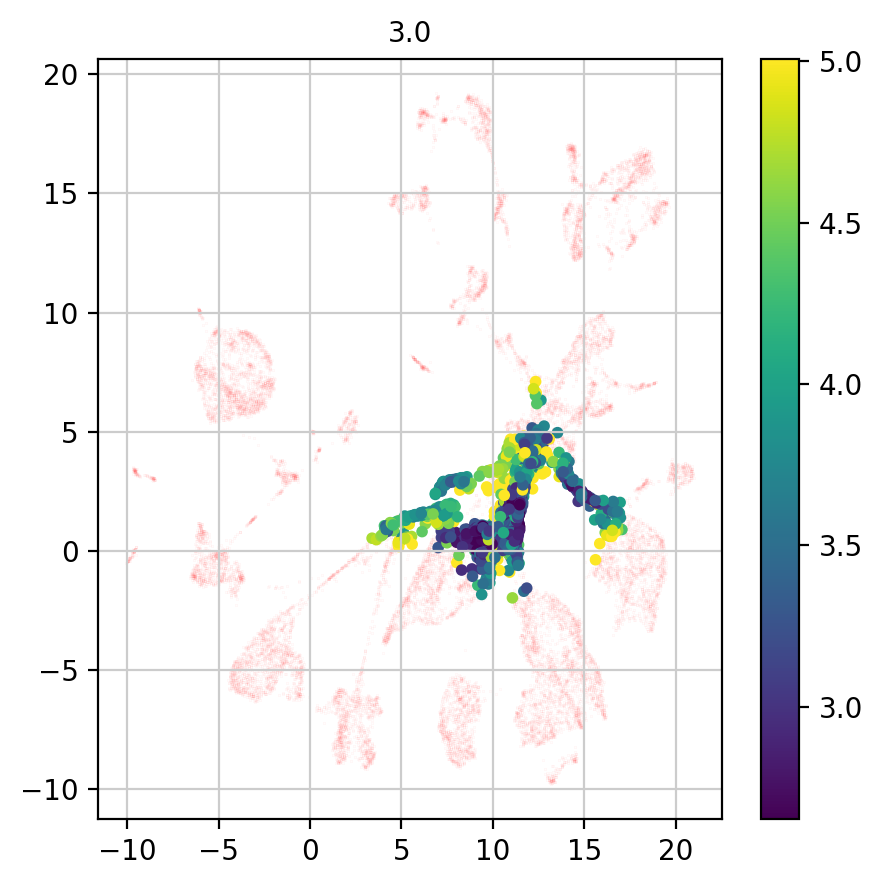

4.0


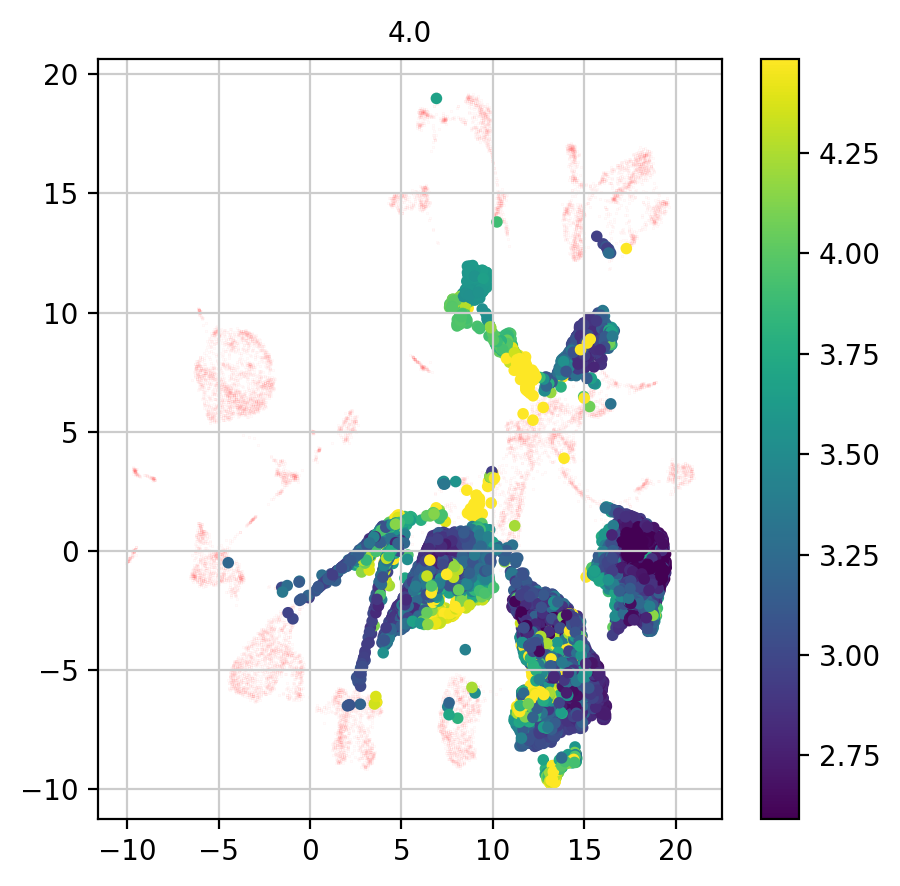

5.0


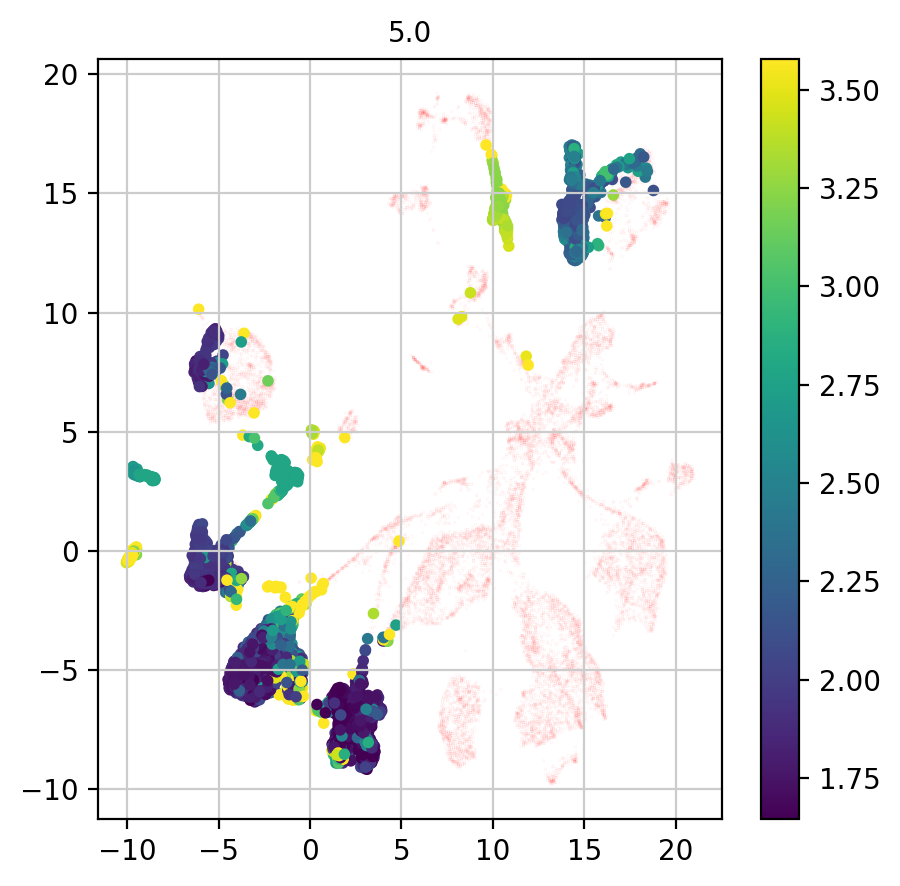

6.0


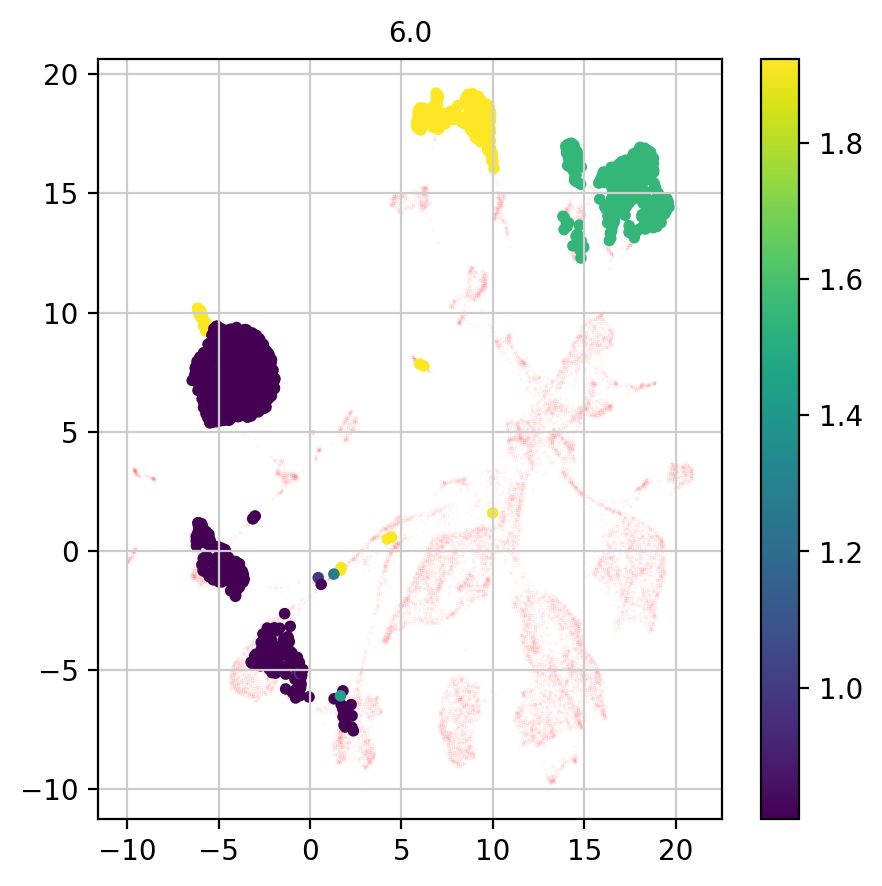

[1. 2. 3. 4. 5. 6.]
[3.7101353381131945, 4.737214111562829, 3.374751694359645, 3.1578124523194857, 2.091446897139963, 1.0535584763757602]


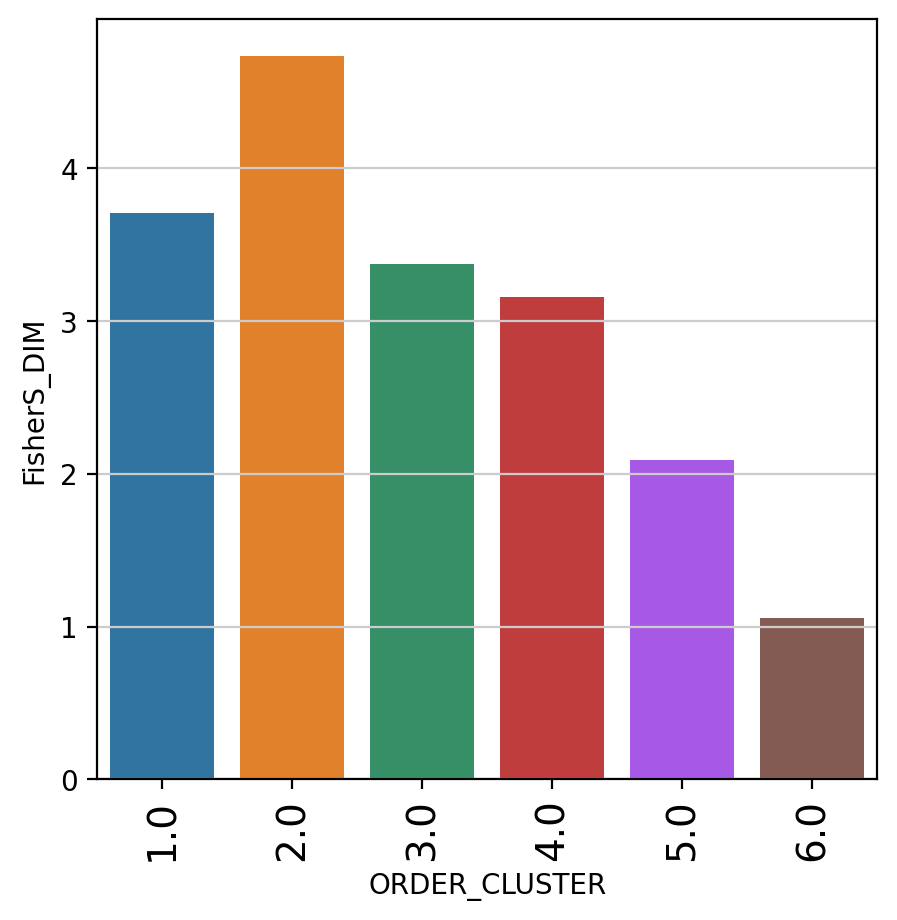

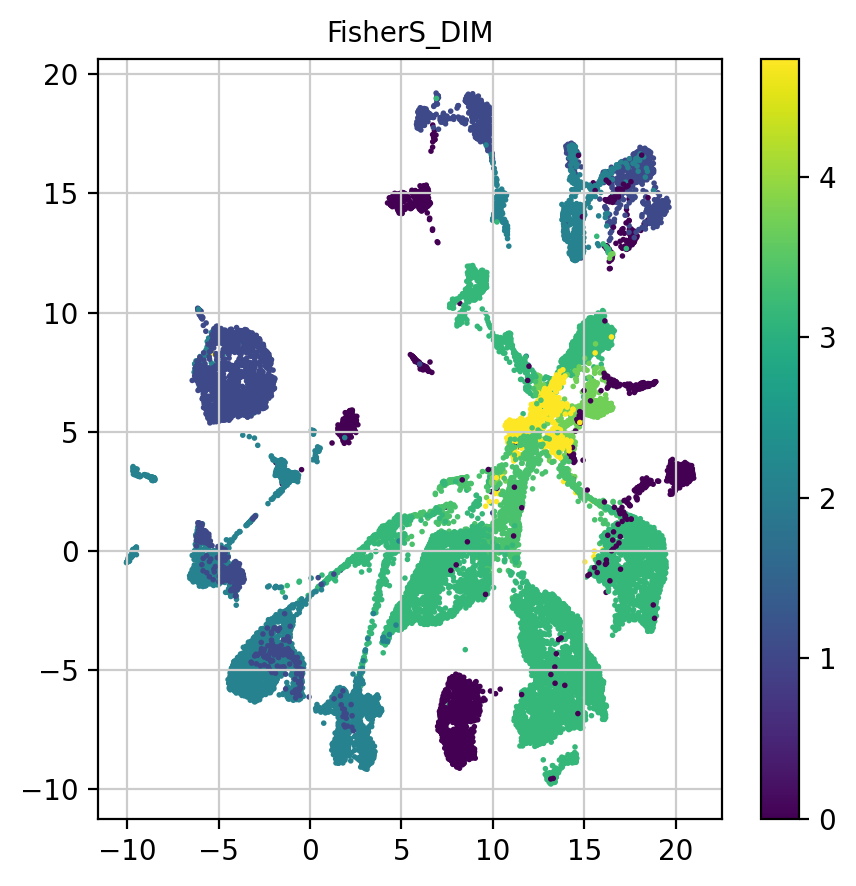

In [195]:
# estimate dimensionality by subsets
orders = np.unique(adata.obs['Order_cluster'])[0:6]
order_dimension = []
#embedding = 'X_pca'
cond_number = 10
embedding = 'X_umap'
col_dims = np.zeros(len(adata))
#embedding = 'X_draw_graph_fa'
for ordr in orders:
    if not np.isnan(ordr):
        print(ordr)
        inds = np.argwhere(np.array(adata.obs['Order_cluster']==ordr)).flatten()
        
        fishers = skdim.lid.FisherS(conditional_number=cond_number).fit(X_pca[inds,:])
        glob_pw = fishers.point_inseparability_to_pointID(idx='selected')[0]
        glob_pw = winsorize(glob_pw, limits=(0.01,0.01), inclusive=(True, True), inplace=True)
        glob_pw_vis = winsorize(glob_pw, limits=(0.05,0.05), inclusive=(True, True), inplace=True)
        fisherS_global = fishers.dimension_
        order_dimension.append(fisherS_global)
        
        plt.scatter(adata.obsm[embedding][:,0],adata.obsm[embedding][:,1],s=0.01,c='r',alpha=0.1)
        plt.scatter(adata.obsm[embedding][inds,0],adata.obsm[embedding][inds,1],s=10,c=glob_pw_vis)
        plt.title(ordr)
        plt.colorbar()
        plt.show()    
        
        col_dims[inds] = fisherS_global
        

print(orders)
print(order_dimension)

df = pd.DataFrame(data={'ORDER_CLUSTER':orders,'FisherS_DIM':order_dimension})
sns.barplot(data=df,x='ORDER_CLUSTER',y='FisherS_DIM')
plt.xticks(rotation='vertical',fontsize=14)
plt.show()

plt.scatter(adata.obsm[embedding][:,0],adata.obsm[embedding][:,1],s=1,c=col_dims)
plt.colorbar()
plt.title('FisherS_DIM')
plt.show()

1


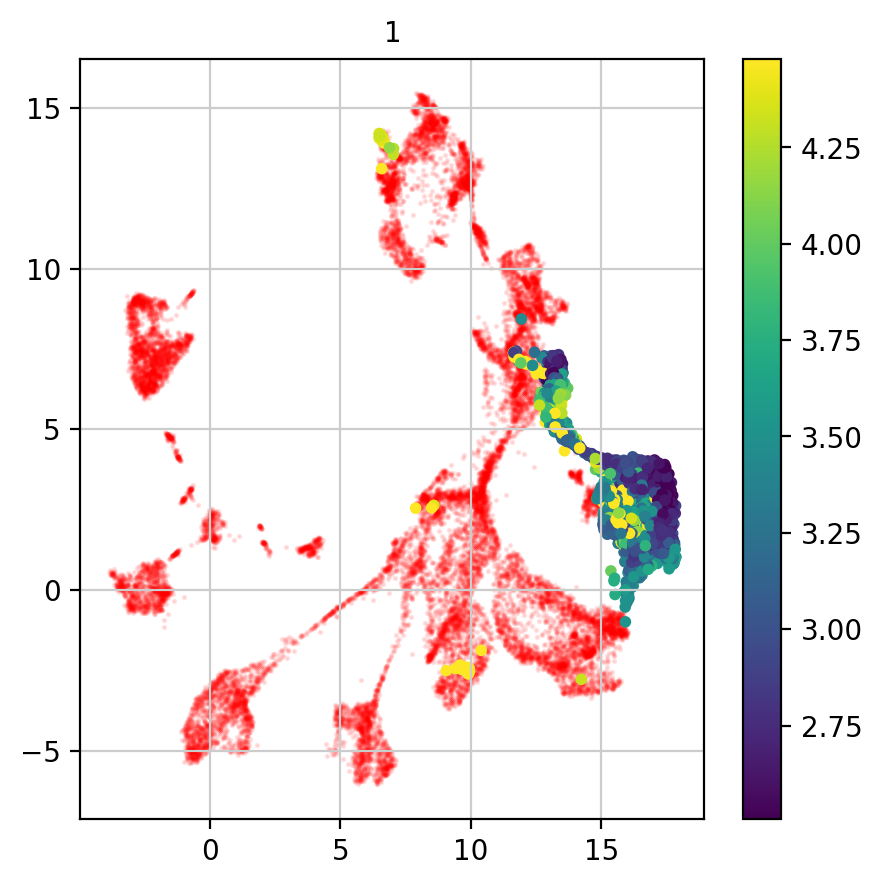

2


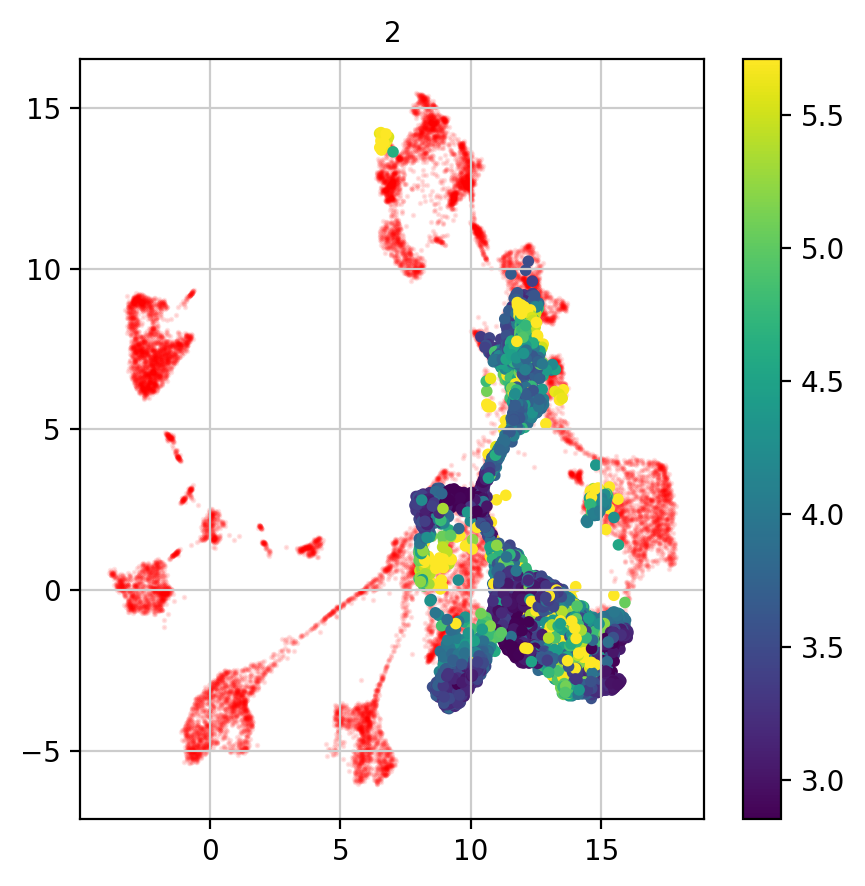

3


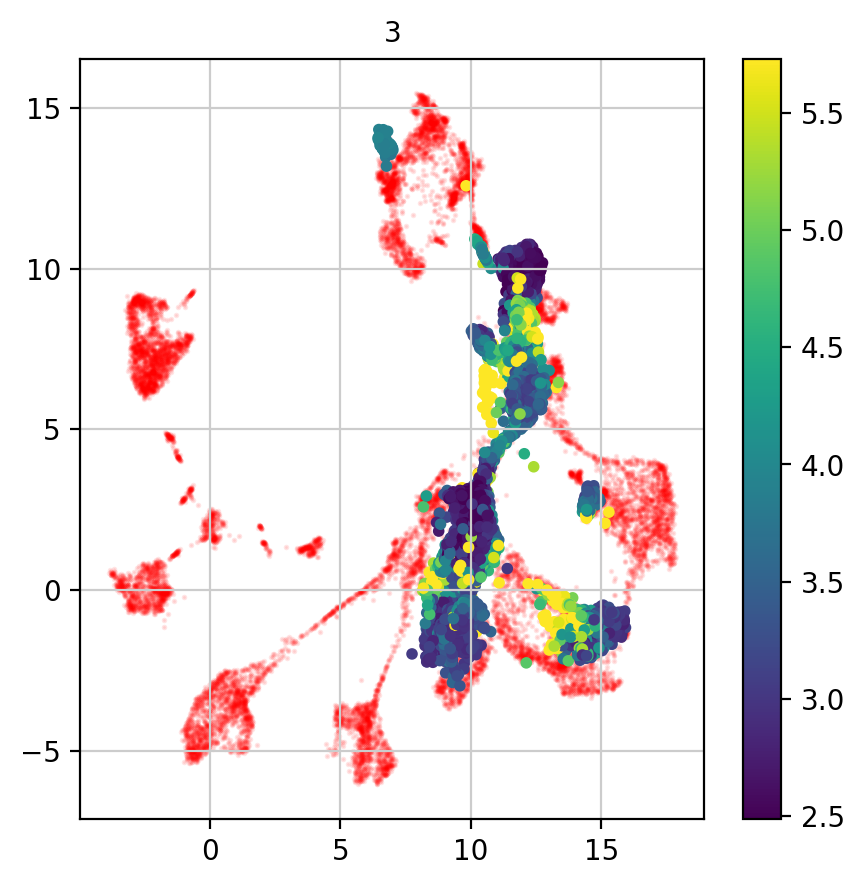

4


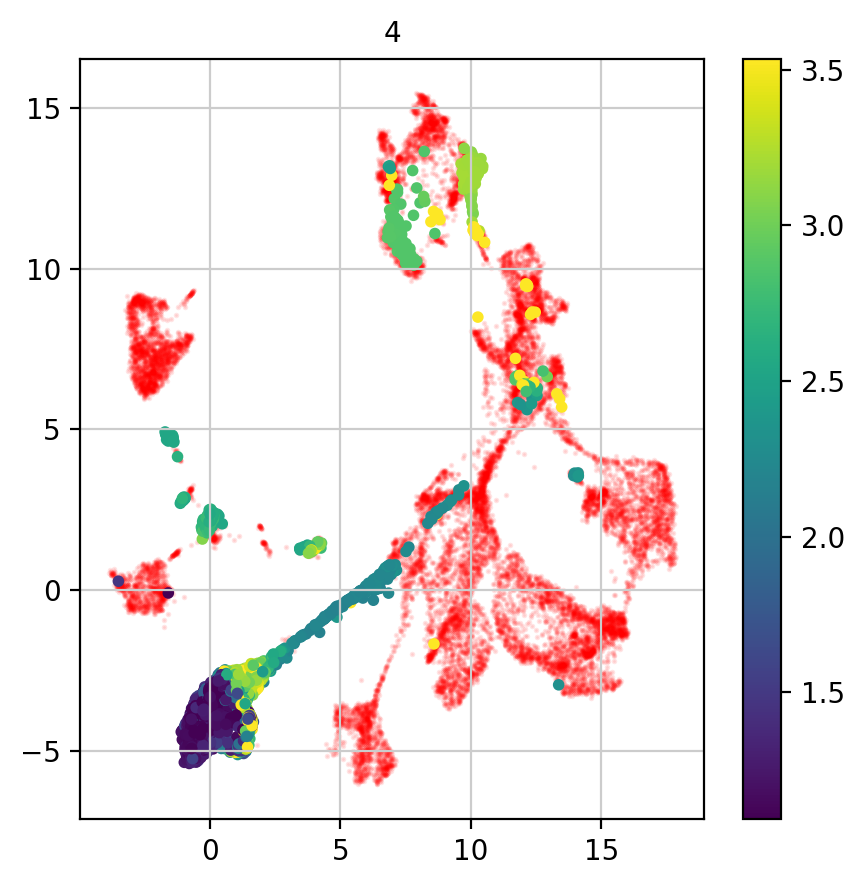

5


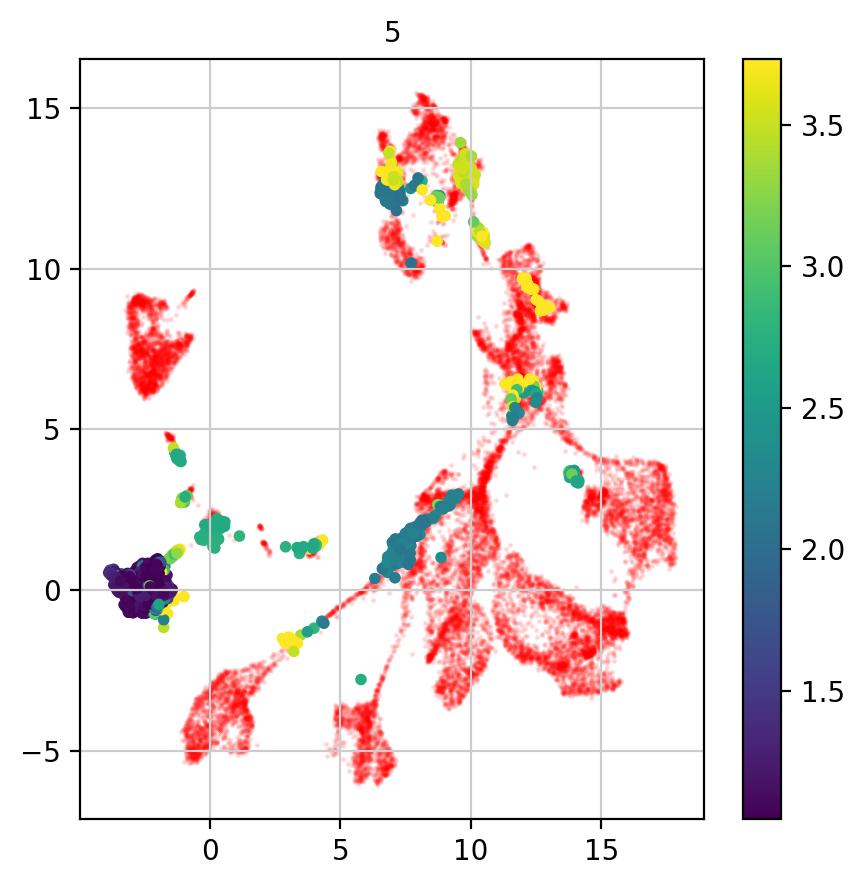

6


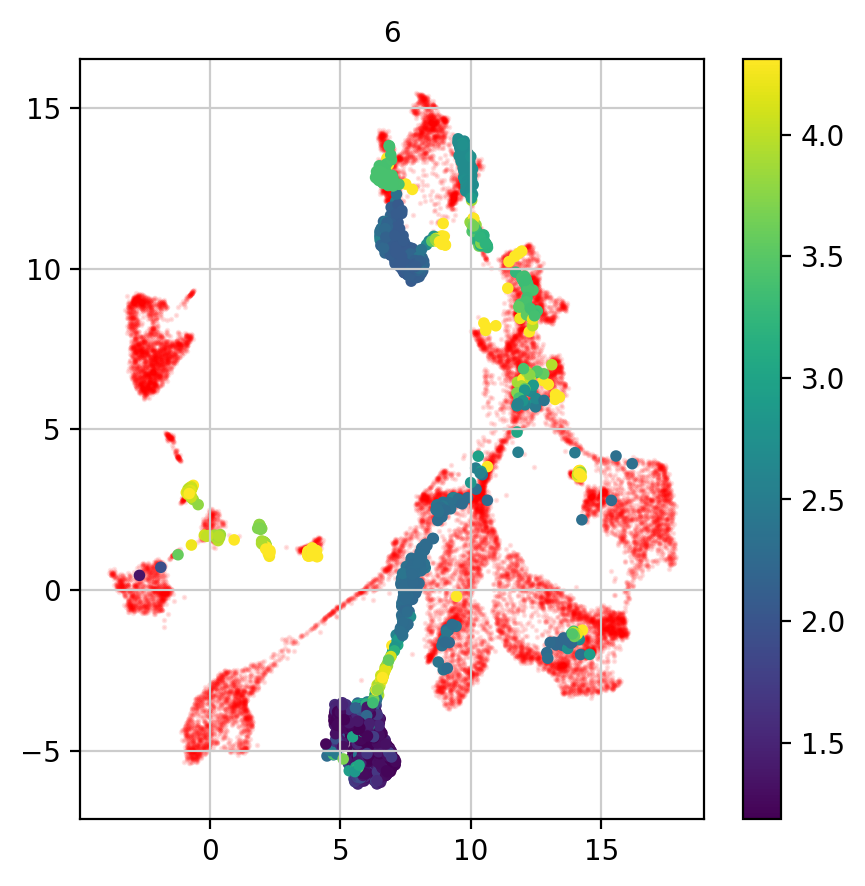

7


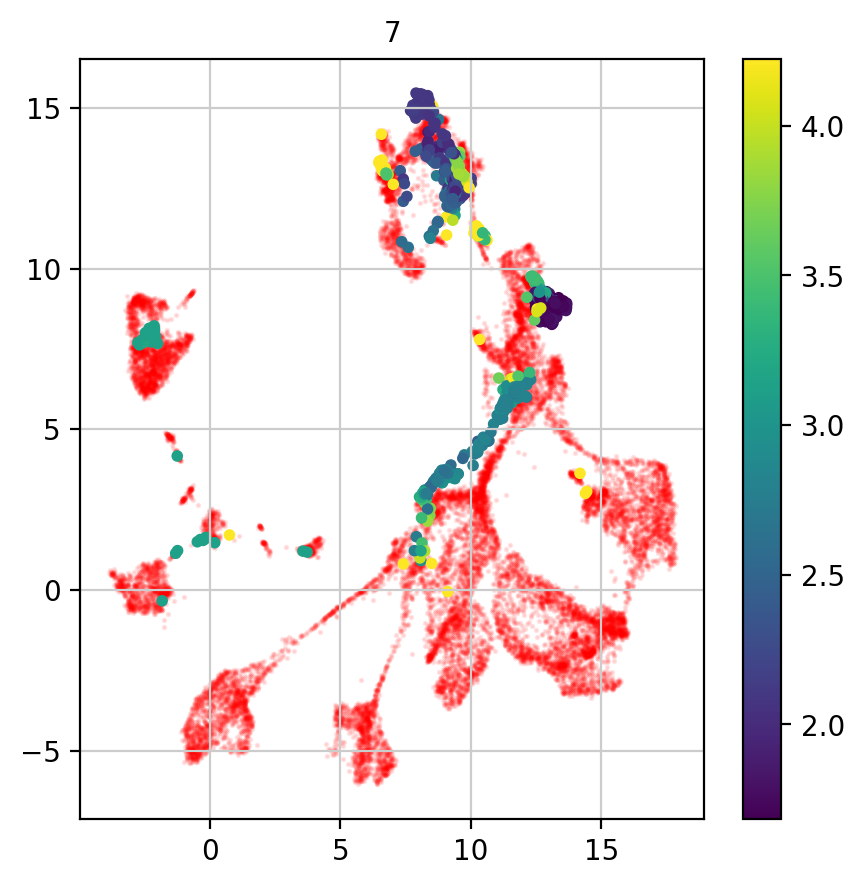

8


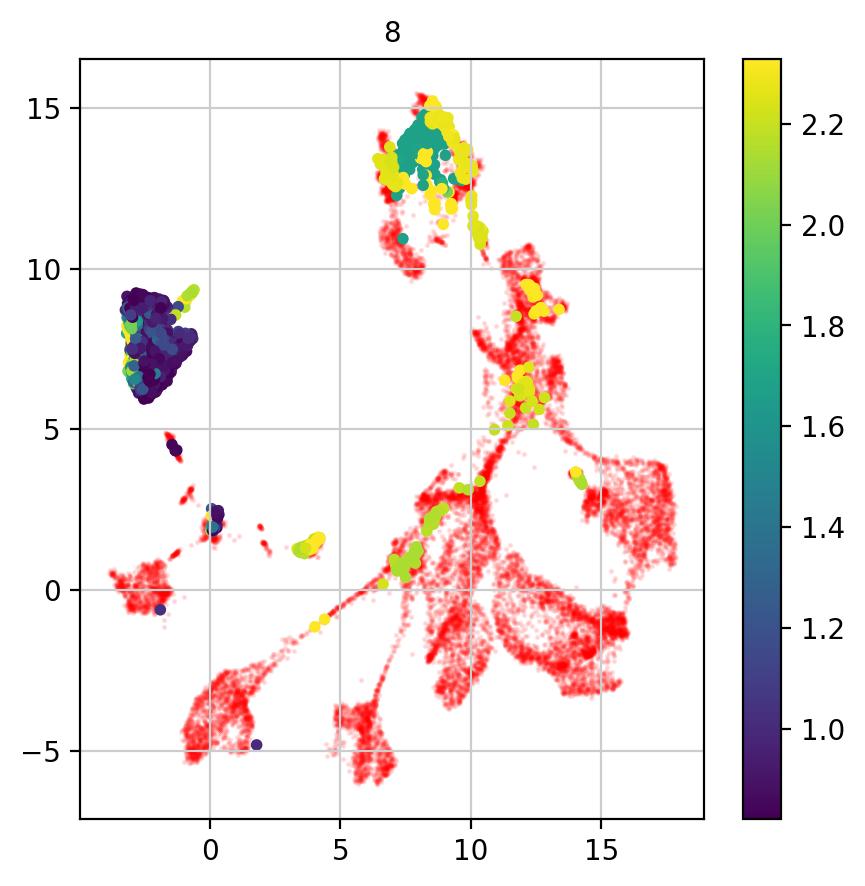

[1 2 3 4 5 6 7 8]
[3.096022445990975, 3.5821298368728502, 3.204745681775949, 1.754798921700596, 1.662659977650223, 1.8970229673896195, 2.318129505214364, 1.2023551397457415]


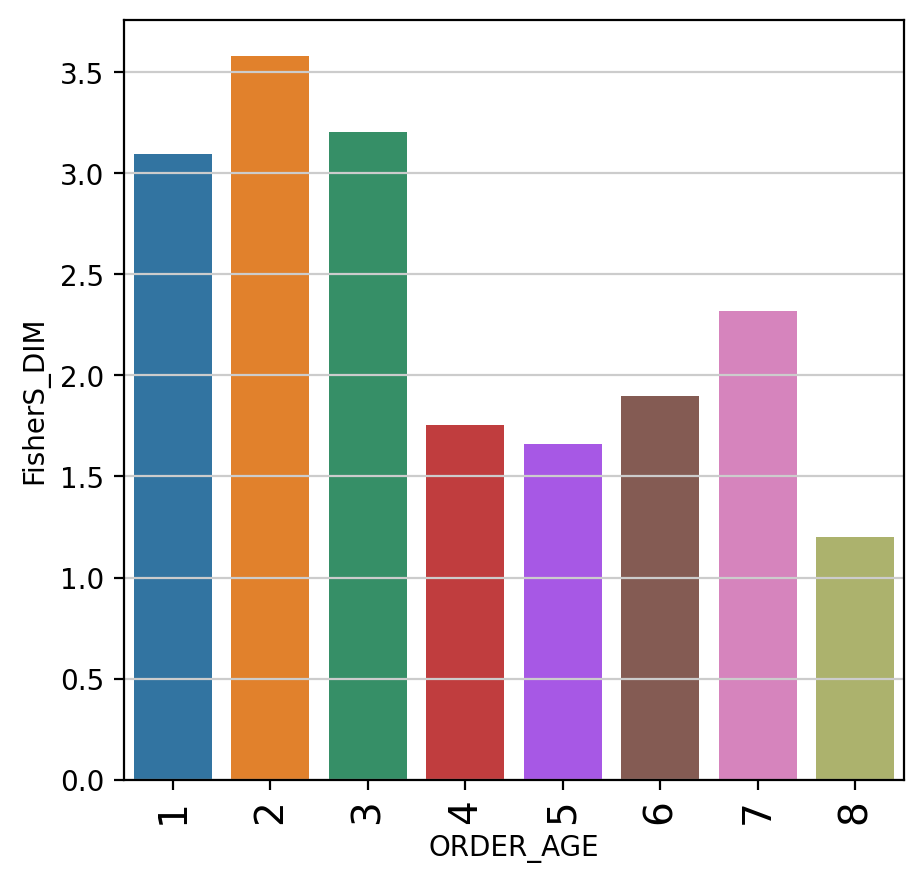

Text(0.5, 1.0, 'FisherS_DIM')

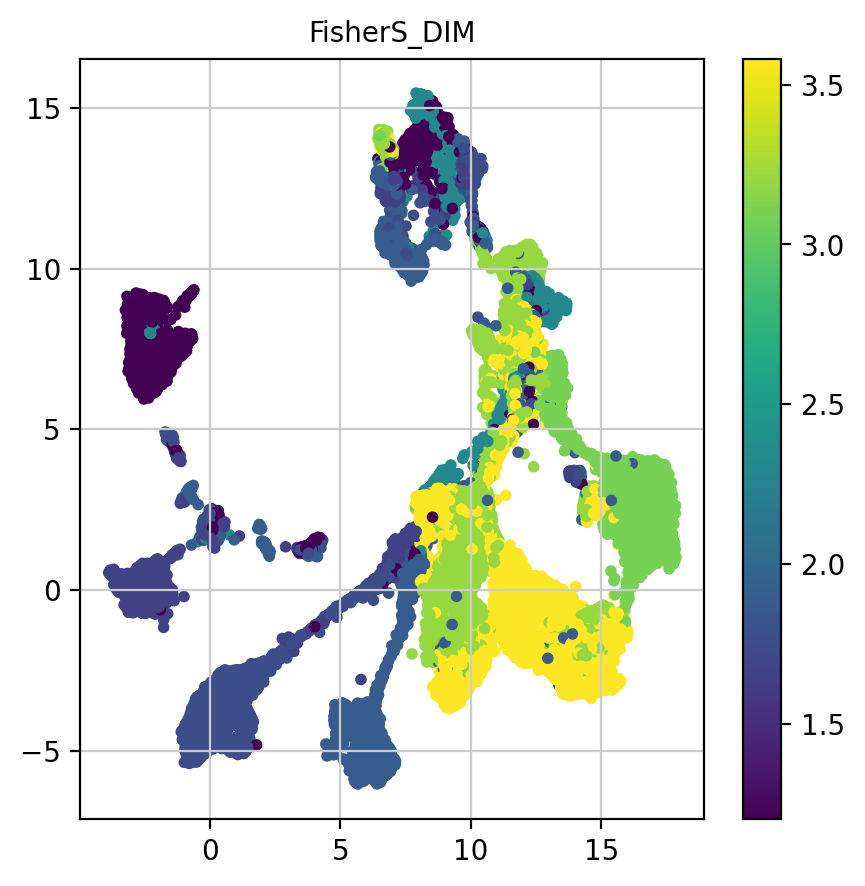

In [37]:
# estimate dimensionality by subsets
orders = np.unique(adata.obs['Order_age'])[0:8]
order_dimension = []
#embedding = 'X_pca'
cond_number = 10
embedding = 'X_umap'
col_dims = np.zeros(len(adata))
#embedding = 'X_draw_graph_fa'
for ordr in orders:
    if not np.isnan(ordr):
        print(ordr)
        inds = np.argwhere(np.array(adata.obs['Order_age']==ordr)).flatten()
        
        fishers = skdim.lid.FisherS(conditional_number=cond_number).fit(X_pca[inds,:])
        glob_pw = fishers.point_inseparability_to_pointID(idx='selected')[0]
        glob_pw = winsorize(glob_pw, limits=(0.01,0.01), inclusive=(True, True), inplace=True)
        glob_pw_vis = winsorize(glob_pw, limits=(0.05,0.05), inclusive=(True, True), inplace=True)
        fisherS_global = fishers.dimension_
        order_dimension.append(fisherS_global)
        
        plt.scatter(adata.obsm[embedding][:,0],adata.obsm[embedding][:,1],s=1,c='r',alpha=0.1)
        plt.scatter(adata.obsm[embedding][inds,0],adata.obsm[embedding][inds,1],s=10,c=glob_pw_vis)
        plt.title(ordr)
        plt.colorbar()
        plt.show()
        
        col_dims[inds] = fisherS_global

print(orders)
print(order_dimension)

df = pd.DataFrame(data={'ORDER_AGE':orders,'FisherS_DIM':order_dimension})
sns.barplot(data=df,x='ORDER_AGE',y='FisherS_DIM')
plt.xticks(rotation='vertical',fontsize=14)
plt.show()

plt.scatter(adata.obsm[embedding][:,0],adata.obsm[embedding][:,1],s=10,c=col_dims)
plt.colorbar()
plt.title('FisherS_DIM')


corr ages/granule -0.6732133125192762


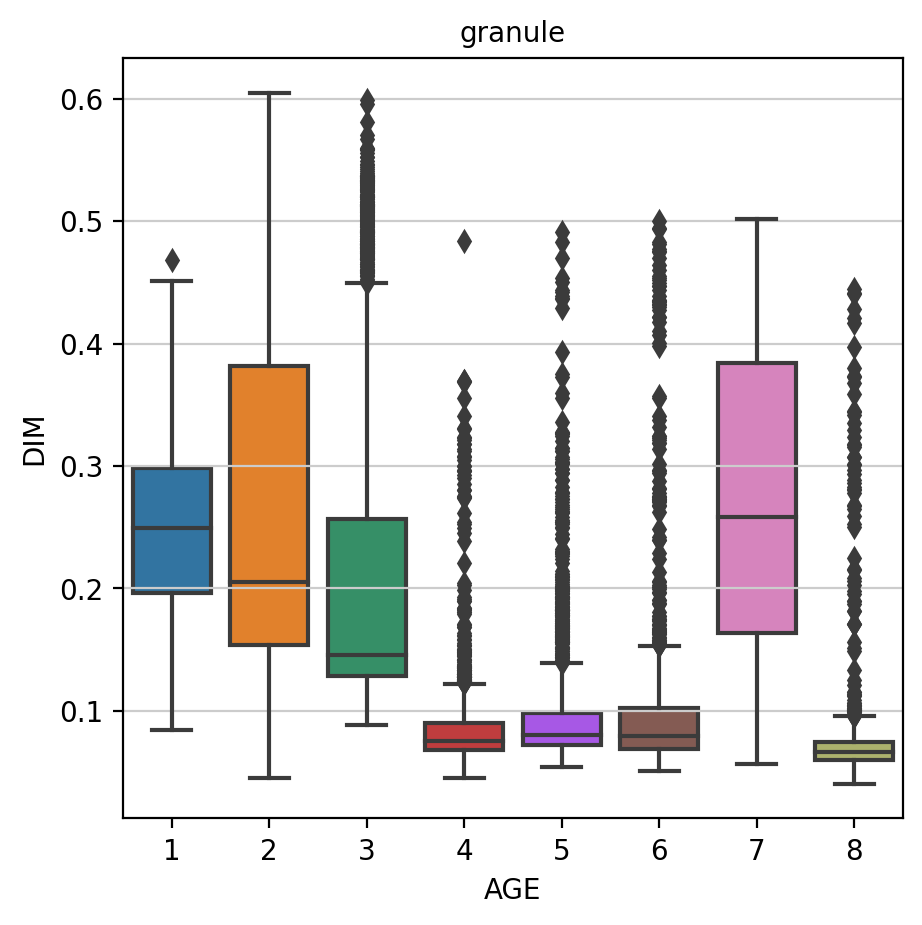

In [243]:
# analyze trajectory

#Astro-adult              959
#Astro-juv                687
#CA3-Pyr                  463
#Cajal-Retzius            508
#Ependymal                170
#GABA                     189
#GC-adult                2291
#GC-juv                  3321
#Immature-Astro           650
#Immature-GABA           1022
#Immature-GC             2361
#Immature-Pyr            4518
#MOL                      688
#MiCajal-Retziusoglia     404
#NFOL                     226
#Neuroblast              1366
#OPC                      666
#RGL                      159
#RGL_young                685
#nIPC                     347
#nIPC-perin               467

#trajectory_types = {'astrocyte':['RGL_young','nIPC-perin','Immature-Astro','Astro-juv','Astro-adult'],
#    'granule':['nIPC','Neuroblast','Immature-GC','GC-juv','GC-adult'],
#    'pyramidal':['RGL_young','nIPC-perin','Neuroblast','Immature-Pyr','CA3-Pyr'],
#    'GABA':['RGL_young','nIPC-perin','Neuroblast','Immature-GABA','GABA'],
#    'oligodendrocyte':['RGL_young','OPC','NFOL','MOL']}

#trajectory_types = {'astrocyte':['Immature-Astro','Astro-juv','Astro-adult'],
#'granule':['Immature-GC','GC-juv','GC-adult'],
#'pyramidal':['Immature-Pyr','CA3-Pyr'],
#'GABA':['Immature-GABA','GABA'],
#'oligodendrocyte':['RGL_young','OPC','NFOL','MOL']}

#Order_age	1	2	3	4	5	6	7	8
#cluster								
#Astro-adult	0	0	0	12	122	10	241	574
#Astro-juv	0	0	0	140	131	343	8	65
#CA3-Pyr	0	0	1	185	131	103	10	33
#Cajal-Retzius	114	136	151	9	47	26	3	22
#Ependymal	8	72	45	13	0	6	24	2
#GABA	0	0	3	39	15	33	3	96
#GC-adult	0	0	0	138	261	17	44	1831
#GC-juv	0	0	8	1427	676	1085	5	120
#Immature-Astro	0	124	514	1	0	11	0	0
#Immature-GABA	22	587	388	0	0	23	2	0
#Immature-GC	37	436	1271	211	136	232	14	24
#Immature-Pyr	1454	2338	673	1	0	51	0	1
#MOL	0	0	1	112	63	192	180	140
#MiCajal-Retziusoglia	21	18	96	6	44	110	15	94
#NFOL	0	0	33	28	39	76	19	31
#Neuroblast	206	456	426	17	65	47	128	21
#OPC	2	61	171	16	22	62	308	24
#RGL	0	0	0	1	15	30	101	12
#RGL_young	107	325	241	4	0	7	0	1
#nIPC	51	60	120	20	27	12	40	17
#nIPC-perin	159	136	156	3	1	7	5	0

trajectory_types = {'astrocyte':['RGL_young','nIPC-perin','Immature-Astro','Astro-juv','Astro-adult'],
                   'granule':['nIPC','Neuroblast','Immature-GC','GC-juv','GC-adult'],
                   'pyramidal':['RGL_young','nIPC-perin','Neuroblast','Immature-Pyr','CA3-Pyr'],
                   'GABA':['RGL_young','nIPC-perin','Neuroblast','Immature-GABA','GABA'],
                   'oligodendrocyte':['RGL_young','OPC','NFOL','MOL']}

#trajectory_types = {'astrocyte':['RGL_young','nIPC','Immature-Astro','Astro-juv','Astro-adult'],
#                   'granule':['nIPC','Neuroblast','Immature-GC','GC-juv','GC-adult'],
#                   'pyramidal':['Immature-Pyr','CA3-Pyr']}


trajectory_types = {'granule':['RGL_young','RGL','nIPC','nIPC-perin','Neuroblast','Immature-GC','GC-juv','GC-adult']}
#trajectory_types = {'pyramidal':['Immature-Pyr','CA3-Pyr']}
#trajectory_types = {'nIPC':['nIPC','nIPC-perin']}
#trajectory_types = {'astrocyte':['RGL_young','nIPC','nIPC-perin','Immature-Astro','Astro-juv','Astro-adult']
#trajectory_types = {'granule':['Immature-GC','GC-juv','GC-adult']}
#trajectory_types = {'astrocyte':['RGL_young','RGL','nIPC','nIPC-perin','Immature-Astro','Astro-juv','Astro-adult']}
#trajectory_types = {'oligodendrocyte':['RGL_young','RGL','OPC','NFOL','MOL']}
#trajectory_types = {'RGL':['RGL_young','RGL']}
#trajectory_types = {'Immature':['Immature-GC']}

dims_all = []
ages_all = []

for tp in trajectory_types:
    tps = trajectory_types[tp]
    ind_tp = []
    for t in tps:
        inds = list(np.argwhere(np.array(adata.obs['cluster']==t)).flatten())
        ind_tp = ind_tp+inds
    ind_tp = np.array(ind_tp)
    dims = list(adata.obs['FisherS_GPW_surrogate'][ind_tp])
    #dims = list(adata.obs['CytoTRACE'][ind_tp])
    #dims = list(adata.obs['PC2'][ind_tp])
    ages = list(adata.obs['Order_age'][ind_tp])
    #dims_all = dims_all+dims
    #ages_all = ages_all+ages
    df = pd.DataFrame(data={'AGE':ages,'DIM':dims})
    
    print('corr ages/'+tp,stats.spearmanr(ages,dims).correlation)
    
    sns.boxplot(data=df,x='AGE',y='DIM')
    plt.title(tp)
    plt.show()
    
ind_tp = []
if False:
    for tp in trajectory_types:
        tps = trajectory_types[tp]
        for t in tps:
            inds = list(np.argwhere(np.array(adata.obs['cluster']==t)).flatten())
            ind_tp = ind_tp+inds
        adatatp = adata[ind_tp,:]
        
        n_neighbors_umap = 100
        sc.pp.neighbors(adatatp,n_neighbors=n_neighbors_umap)
        sc.tl.umap(adatatp,n_components=2)    
        sc.pl.umap(adatatp,title=tp)
        
    
    

1
2
3
4
5
6
7
8


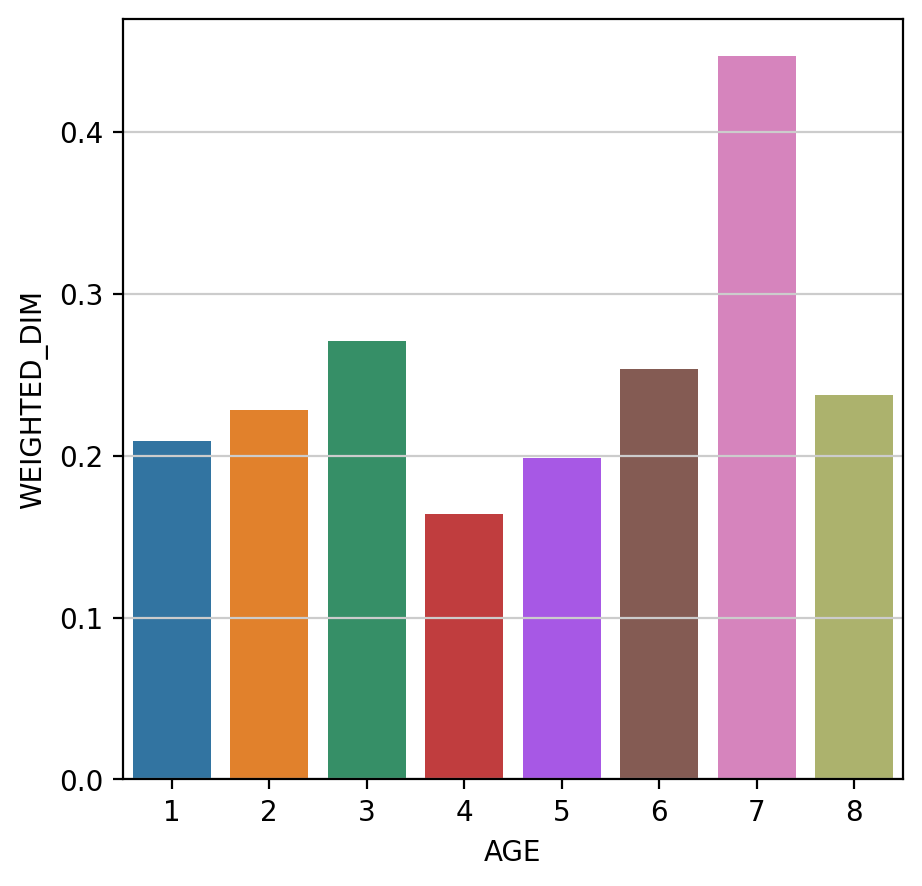

In [183]:
# weighted average of cells per age
orders = np.unique(adata.obs['Order_age'])
order_dimension_weighted = []
thresh_perc = 5
for ordr in orders:
    if not np.isnan(ordr):
        print(ordr)
        inds = np.argwhere(np.array(adata.obs['Order_age']==ordr)).flatten()
        classes = adata.obs['cluster'][inds].to_numpy()
        vals = adata.obs['FisherS_GPW_surrogate'][inds].to_numpy()
        counter = Counter(classes)
        selected_classes = []
        for key in counter.keys():
            nk = counter[key]
            if nk/len(inds)*100>thresh_perc:
                selected_classes.append(key)
        inds1 = []
        for cl in selected_classes:
            ii = np.argwhere(np.array(classes)==cl).flatten()
            inds1=inds1+list(ii)
        inds1 = np.array(inds1)
        order_dimension_weighted.append(mean_inversely_weighted_by_classes(vals[inds1],classes[inds1]))

df = pd.DataFrame(data={'AGE':orders,'WEIGHTED_DIM':order_dimension_weighted})
sns.barplot(data=df,x='AGE',y='WEIGHTED_DIM')
plt.show()

        


1
['nIPC-perin', 'Neuroblast', 'Immature-Pyr']
[0.3027729, 0.20074026, 0.121956214]
mean of mean =  0.20848979
2
['RGL_young', 'Neuroblast', 'Immature-GC', 'Immature-Pyr']
[0.45578575, 0.20812574, 0.1421769, 0.13131428]
mean of mean =  0.23435065
3
['Immature-Astro', 'RGL_young', 'Neuroblast', 'Immature-GC', 'Immature-Pyr']
[0.50463, 0.45569348, 0.20983529, 0.13158932, 0.13185745]
mean of mean =  0.28672114
4
['Astro-juv', 'Immature-GC', 'CA3-Pyr', 'GC-juv', 'GC-adult']
[0.4261127, 0.124047354, 0.11559484, 0.07536995, 0.07763522]
mean of mean =  0.16375202
5
['Astro-adult', 'Astro-juv', 'Immature-GC', 'CA3-Pyr', 'GC-juv', 'GC-adult']
[0.37713635, 0.3865349, 0.16166084, 0.10934964, 0.078637525, 0.0767543]
mean of mean =  0.1983456
6
['Astro-juv', 'MOL', 'Immature-GC', 'GC-juv']
[0.41907278, 0.3918507, 0.12718283, 0.07656575]
mean of mean =  0.253668
7
['Astro-adult', 'MOL', 'OPC', 'Neuroblast']
[0.43164253, 0.45666385, 0.71439683, 0.21144821]
mean of mean =  0.45353785
8
['Astro-adult',

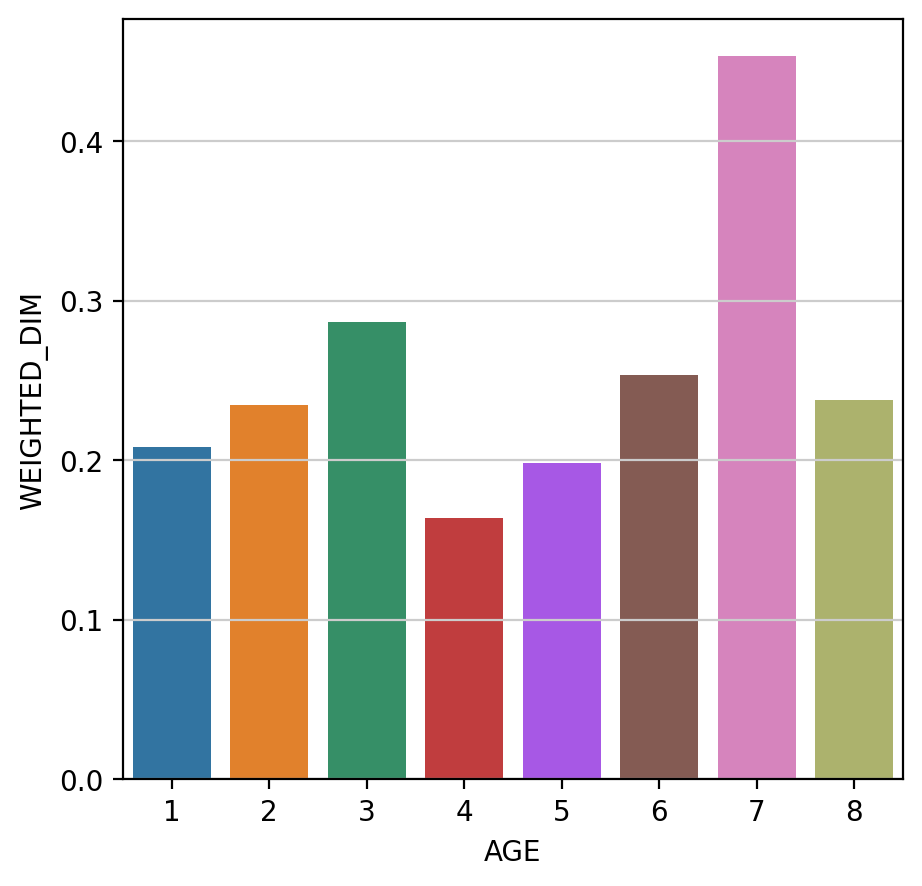

In [193]:
# weighted average of cells per age
orders = np.unique(adata.obs['Order_age'])
order_dimension_weighted = []
excluded_classes = ['Cajal-Retzius','Immature-GABA','RGL']
thresh_perc = 5
for ordr in orders:
    if not np.isnan(ordr):
        print(ordr)
        inds = np.argwhere(np.array(adata.obs['Order_age']==ordr)).flatten()
        classes = adata.obs['cluster'][inds].to_numpy()
        vals = adata.obs['FisherS_GPW_surrogate'][inds].to_numpy()
        #vals = adata.obs['CytoTRACE'][inds].to_numpy()
        #vals = adata.obs['Order_cluster'][inds].to_numpy()
        counter = Counter(classes)
        selected_classes = []
        for key in counter.keys():
            nk = counter[key]
            if nk/len(inds)*100>thresh_perc:
                if not key in excluded_classes:
                    selected_classes.append(key)
        class_means = []
        for cl in selected_classes:
            ii = np.argwhere(np.array(classes)==cl).flatten()
            wv = np.mean(vals[ii])
            class_means.append(wv)
        print(selected_classes)
        print(class_means)
        print('mean of mean = ',np.mean(np.array(class_means)))
        order_dimension_weighted.append(np.mean(np.array(class_means)))

df = pd.DataFrame(data={'AGE':orders,'WEIGHTED_DIM':order_dimension_weighted})
sns.barplot(data=df,x='AGE',y='WEIGHTED_DIM')
plt.show()

        



1
RGL_young : 0.1562043795620438 , 0.31347838
Ependymal : 0.047058823529411764 , 0.31268632
OPC : 0.003003003003003003 , 0.3659249
nIPC-perin : 0.3404710920770878 , 0.3027729
nIPC : 0.14697406340057637 , 0.2219867
Neuroblast : 0.15080527086383602 , 0.20074026
Immature-GC : 0.015671325709445152 , 0.13342214
Immature-Pyr : 0.32182381584772024 , 0.121956214
Immature-GABA : 0.021526418786692758 , 0.16439082
2
Immature-Astro : 0.19076923076923077 , 0.47752342
RGL_young : 0.4744525547445255 , 0.45578575
Ependymal : 0.4235294117647059 , 0.4167497
OPC : 0.0915915915915916 , 0.50180936
nIPC-perin : 0.291220556745182 , 0.4047525
nIPC : 0.1729106628242075 , 0.27027503
Neuroblast : 0.33382137628111275 , 0.20812574
Immature-GC : 0.18466751376535367 , 0.1421769
Immature-Pyr : 0.517485613103143 , 0.13131428
Immature-GABA : 0.5743639921722113 , 0.20297584
3
Immature-Astro : 0.7907692307692308 , 0.50463
RGL_young : 0.3518248175182482 , 0.45569348
Ependymal : 0.2647058823529412 , 0.4013718
MOL : 0.00145

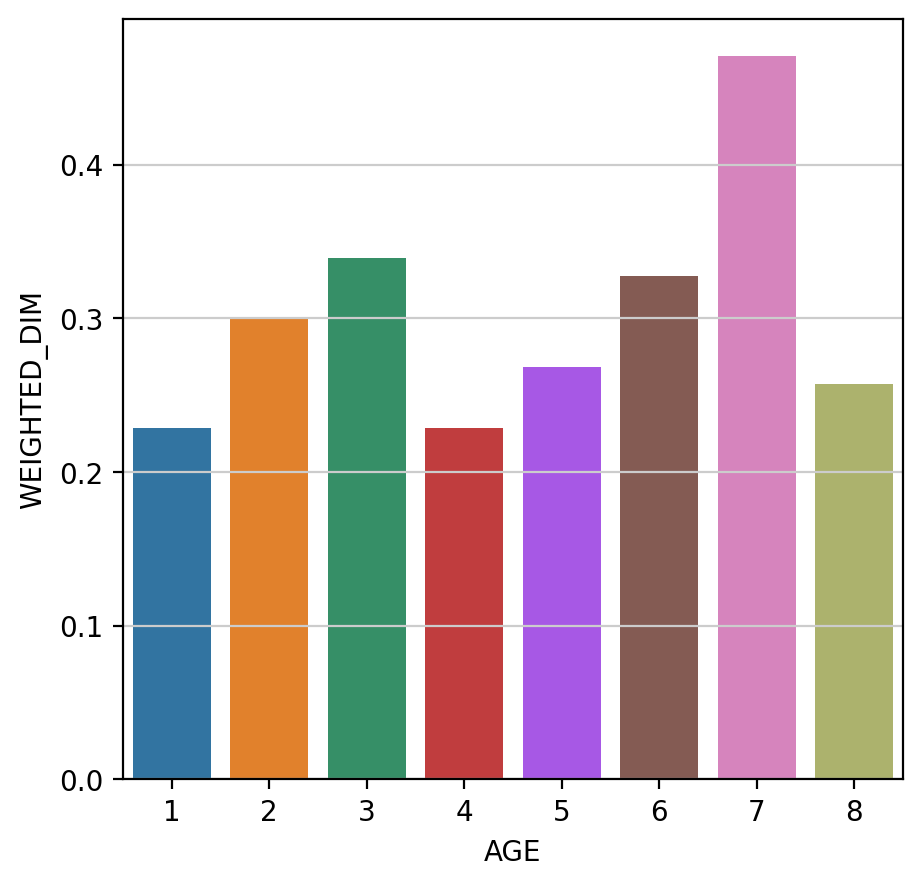

In [208]:
# weighted average of cells per age
orders = np.unique(adata.obs['Order_age'])
order_dimension_weighted = []
excluded_classes = ['Cajal-Retzius','MiCajal-Retziusoglia']
thresh_perc = -1
for ordr in orders:
    if not np.isnan(ordr):
        print(ordr)
        inds = np.argwhere(np.array(adata.obs['Order_age']==ordr)).flatten()
        classes = adata.obs['cluster'][inds].to_numpy()
        vals = adata.obs['FisherS_GPW_surrogate'][inds].to_numpy()
        #vals = adata.obs['CytoTRACE'][inds].to_numpy()
        #vals = adata.obs['Order_cluster'][inds].to_numpy()
        counter = Counter(classes)
        selected_classes = []
        weights = np.zeros(len(vals))
        weight_classes = []
        mean_classes = []
        for key in counter.keys():
            nk = counter[key]
            w = nk/np.sum(np.array(adata.obs['cluster']==key))
            if not key in excluded_classes:
                weight_classes.append(w)
                weights[np.argwhere(classes==key)] = w
                selected_classes.append(key)
                mean_classes.append(np.mean(vals[np.argwhere(classes==key)]))
        mnw = 0
        for i,c in enumerate(selected_classes):
            print(c,':',weight_classes[i],',',mean_classes[i])
            mnw=mnw+weight_classes[i]*mean_classes[i]
        mnw = mnw/np.sum(weight_classes)
        #mnw = weighted_mean(vals,weights)
        order_dimension_weighted.append(mnw)

df = pd.DataFrame(data={'AGE':orders,'WEIGHTED_DIM':order_dimension_weighted})
sns.barplot(data=df,x='AGE',y='WEIGHTED_DIM')
plt.show()

In [135]:
#adata_orig.write('/mnt/c/Datas/ExpressionIDim/GSE104323/GSE104323_qc_filtered.h5ad',compression='gzip')

In [246]:
adata.write('/mnt/c/Datas/ExpressionIDim/GSE104323/GSE104323_qc_filtered_norm.h5ad',compression='gzip')

In [162]:
display(adata)

AnnData object with n_obs × n_vars = 22147 × 10000
    obs: 'cluster', 'age', 'Order', 'CytoTRACE5', 'Order5', 'Order4', 'CytoTRACE4', 'strain', 'sex', 'n_genes_by_counts', 'total_counts', 'total_counts_mt', 'pct_counts_mt', 'CytoTRACE', 'Order_age', 'Order_age1', 'Order_age2', 'Order_cluster', 'Order4_s', 'Order5_s', 'Order_cluster_s', 'FisherS_GPW_vis', 'FisherS_GPW', 'FisherS_GPW_surrogate', 'FisherS_GPW_surrogate_vis', 'PC1', 'PC2'
    var: 'mt', 'n_cells_by_counts', 'mean_counts', 'pct_dropout_by_counts', 'total_counts', 'n_cells'
    uns: 'CytoGenes', 'pca', 'log1p', 'ind_genes', 'neighbors', 'umap', 'age_colors', 'cluster_colors', 'draw_graph'
    obsm: 'X_pca', 'X_umap', 'X_draw_graph_fa'
    varm: 'PCs'
    obsp: 'distances', 'connectivities'

In [263]:
# Compute VECTOR score

adata_pca150 = adata.copy()
sc.tl.pca(adata_pca150,n_comps=200)
X_pca150 = adata_pca150.obsm['X_pca']

(22147, 200)


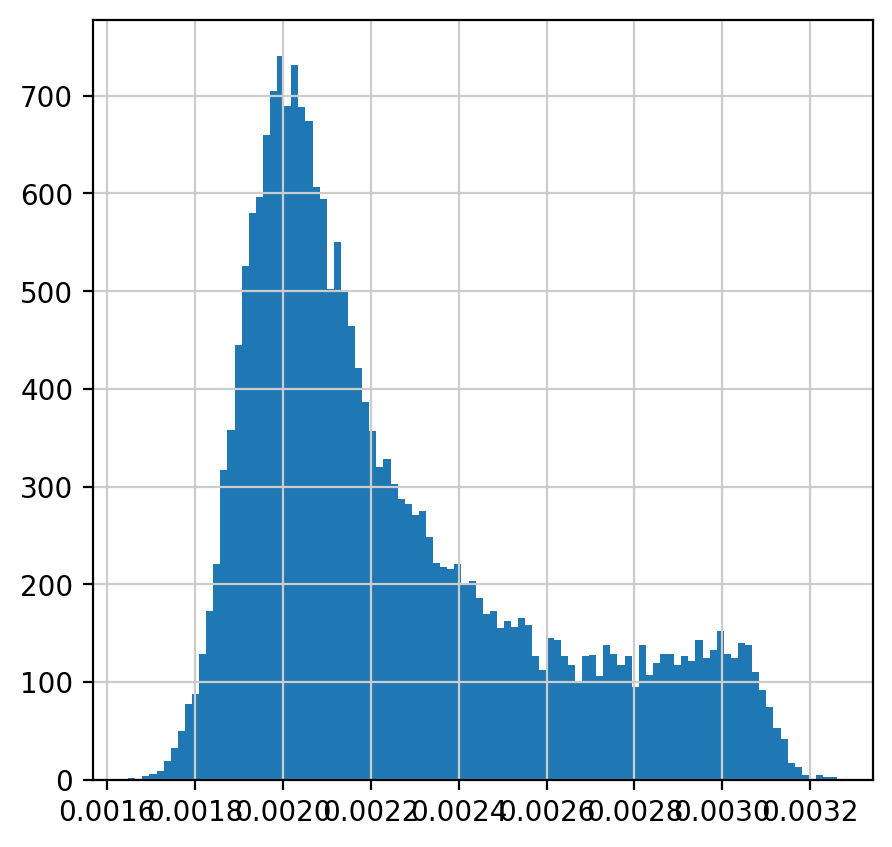

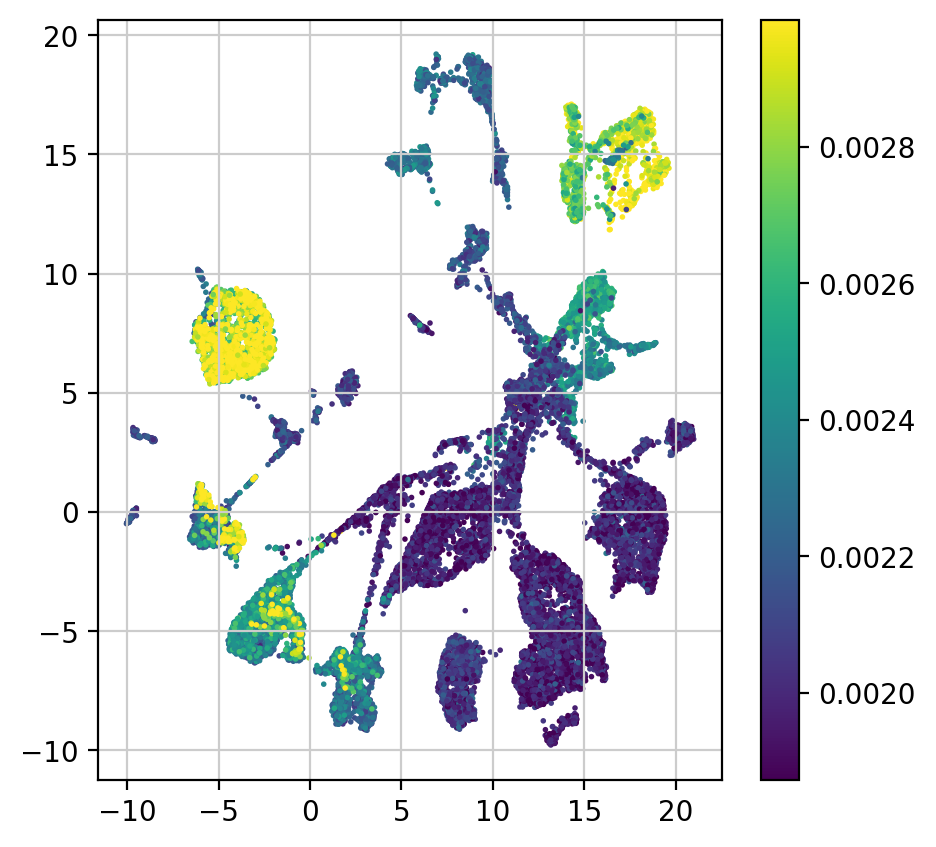

In [271]:
print(X_pca150.shape)
vector_score = np.zeros(X_pca150.shape[0])
for i in range(X_pca150.shape[1]):
    x = X_pca150[:,i]
    xr = np.abs(np.argsort(x)/X_pca150.shape[0]-0.5)
    vector_score = vector_score+xr
vector_score = vector_score/X_pca150.shape[0]
plt.hist(vector_score,bins=100)
plt.show()

vector_score_vis = winsorize(vector_score,limits=(0.05,0.05))
plt.scatter(adata.obsm['X_umap'][:,0],adata.obsm['X_umap'][:,1],c=vector_score_vis,s=1)
plt.colorbar()
plt.show()

In [265]:
x = X_pca150[:,i]

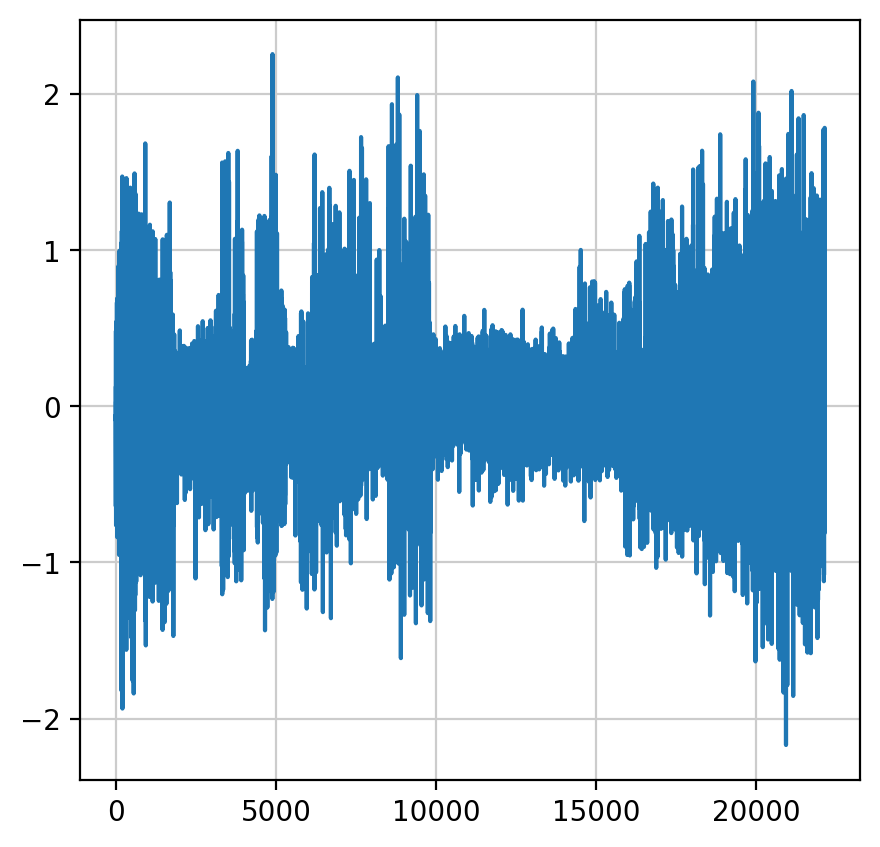

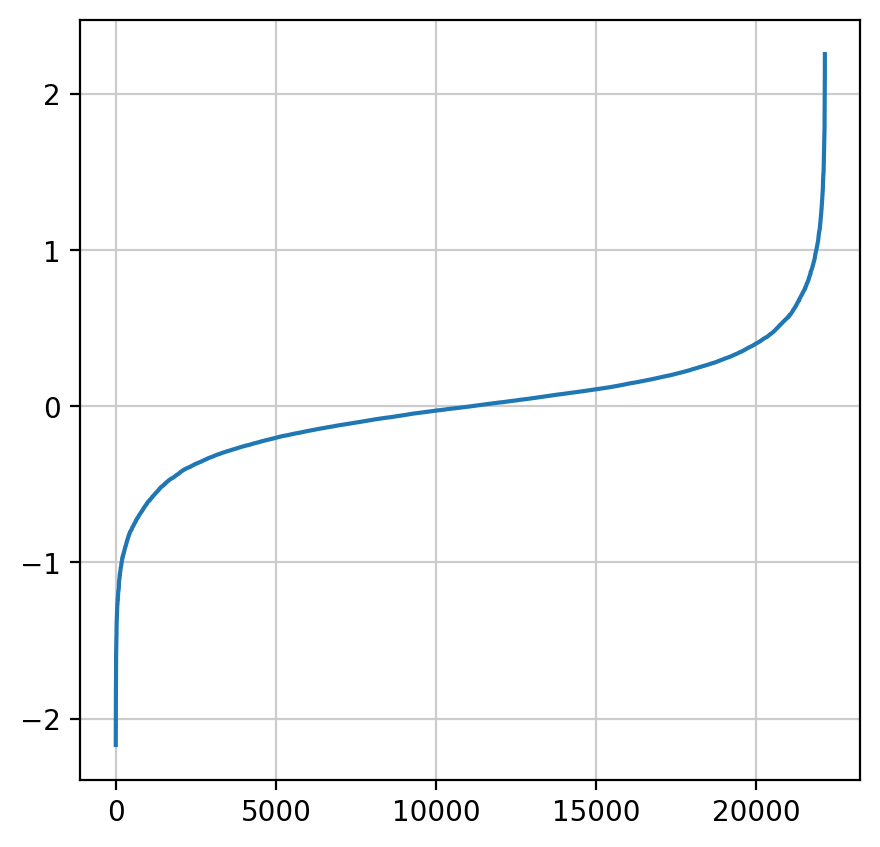

(array([221., 222., 222., 220., 222., 222., 222., 220., 222., 222., 222.,
        220., 222., 222., 220., 222., 222., 222., 220., 222., 222., 222.,
        220., 222., 222., 220., 222., 222., 222., 220., 222., 222., 222.,
        220., 222., 222., 222., 220., 222., 222., 220., 222., 222., 222.,
        220., 222., 222., 222., 220., 222., 222., 220., 222., 222., 222.,
        220., 222., 222., 222., 220., 222., 222., 220., 222., 222., 222.,
        220., 222., 222., 222., 220., 222., 222., 222., 220., 222., 222.,
        220., 222., 222., 222., 220., 222., 222., 222., 220., 222., 222.,
        220., 222., 222., 222., 220., 222., 222., 222., 220., 222., 222.,
        222.]),
 array([0.   , 0.005, 0.01 , 0.015, 0.02 , 0.025, 0.03 , 0.035, 0.04 ,
        0.045, 0.05 , 0.055, 0.06 , 0.065, 0.07 , 0.075, 0.08 , 0.085,
        0.09 , 0.095, 0.1  , 0.105, 0.11 , 0.115, 0.12 , 0.125, 0.13 ,
        0.135, 0.14 , 0.145, 0.15 , 0.155, 0.16 , 0.165, 0.17 , 0.175,
        0.18 , 0.185, 0.19 , 0.195

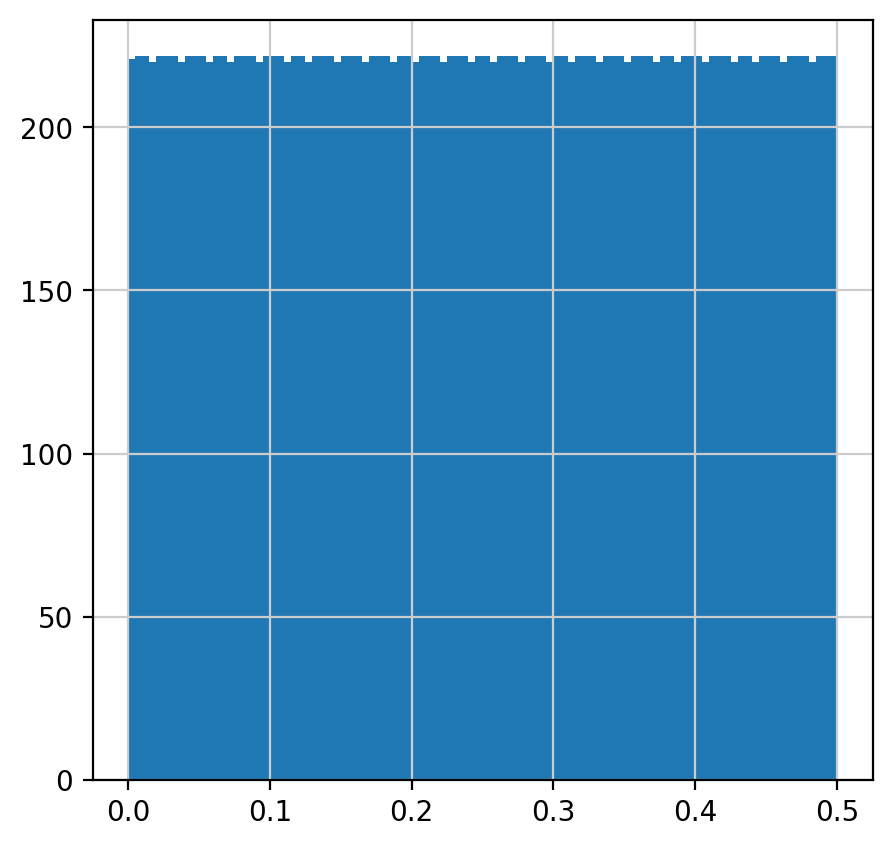

In [280]:
plt.plot(x)
plt.show()
ii = np.argsort(x)
plt.plot(x[ii])
plt.show()
perc = np.abs(ii/np.max(ii)-0.5)
plt.hist(perc,bins=100)